# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [3]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [4]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [5]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [6]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

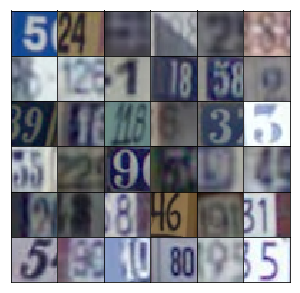

In [6]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [7]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [8]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [9]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [20]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512, activation=None)
        x = tf.reshape(x, (-1, 4,4,512))
        x = tf.layers.batch_normalization(x, training=training)  # we do batch norm in training using batch stats
                                                                 # vs population stats in testing
        x = tf.maximum(x, alpha * x)
        # (4,4,512)
        
        conv1 = tf.layers.conv2d_transpose(x, 256, kernel_size=5, strides=(2,2), padding='same')
        conv1 = tf.layers.batch_normalization(conv1, training=training)
        conv1 = tf.maximum(conv1, alpha * conv1)
        # (8,8, 256)
        
        conv2 = tf.layers.conv2d_transpose(conv1, 128, kernel_size=5, strides=(2,2), padding='same')
        conv2 = tf.layers.batch_normalization(conv2, training=training)
        conv2 = tf.maximum(conv2, alpha * conv2)
        # (16,16, 128)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(conv2, 3, kernel_size=5, strides=(2,2), padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [21]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        conv1 = tf.layers.conv2d(x, 64, 5, strides = 2, padding='same')
        conv1 = tf.layers.batch_normalization(conv1, training=True)
        conv1 = tf.maximum(conv1, alpha * conv1)
        # here 16 x 16 x 64
        
        conv2 = tf.layers.conv2d(conv1, 128, 5, strides = 2, padding='same')
        conv2 = tf.layers.batch_normalization(conv2, training=True)
        conv2 = tf.maximum(conv2, alpha * conv2)
        # here 8 x 8 x 128
        
        conv2 = tf.layers.conv2d(conv1, 256, 5, strides = 2, padding='same')
        conv2 = tf.layers.batch_normalization(conv2, training=True)
        conv2 = tf.maximum(conv2, alpha * conv2)
        # here 4 x 4 x 256
        
        
        flat = tf.reshape(conv2, (-1, 4*4*256))
        
        logits = tf.layers.dense(flat, 1)   # single neuron logit passed to sigmoid 
        sigmoid_out = tf.nn.sigmoid(logits)
        
        return sigmoid_out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [22]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model_out = generator(input_z, output_dim, alpha=alpha)
    d_model_real_out, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake_out, d_logits_fake = discriminator(g_model_out, reuse=True, alpha=alpha)

    #d_loss_real: disc. logits of real data input with labels being one -> disc try to learn they're real
    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real_out)))
    #d_loss_fake: disc. logits of fake data with labels being zero -> disc try to learn they're fake
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake_out)))
    # generator loss: disc. logits of fake input data but with the label of all ones (to fool discriminator)
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake_out)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

## Note on Batch Norm:
[from http://ruishu.io/2016/12/27/batchnorm/]

Recall that batch normalization has distinct behaviors during training verus test time:

- Training

    - Normalize layer activations according to mini-batch statistics.
    - During the training step, update population statistics approximation via moving average of mini-batch statistics.

- Testing

    - Normalize layer activations according to estimated population statistics.
    - Do not update population statistics according to mini-batch statistcs from test data.
    
- Note: 
    - When is_training is True the moving_mean and moving_variance need to be updated, by default the update_ops are placed in tf.GraphKeys.UPDATE_OPS so they need to be added as a dependency to the train_op, example:
    
    update_ops = tf.get_collection(tf.GraphKeys.UPDATE_OPS) if update_ops: updates = tf.group(*update_ops) total_loss = control_flow_ops.with_dependencies([updates], total_loss)

In [23]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize : update_ops added as dependency to the optimizer so that it optimizes moving mean and 
    # moving variance based on mini-batch statistics during training 
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [24]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [25]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network.

## Important Notes

- Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the **population statistics** rather than the **batch statistics**. 

- Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator **doesn't actually use it (input_real)**, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 
- VERY IMPORTANT NOTE: The generator only learns by trying to produce label 1 when passed to discriminator, and not looing at real data:
    - real img -> discriminator -> update disc weights s.t. disc output gets close to 1
    - noise -> generator -> discriminator -> update disc weights s.t. disc output gets close to 0

    - noise -> generator -> discriminator -> update gen wieghts s.t. disc output gets close to 1

In [26]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [32]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 2.6155... Generator Loss: 0.2131
Epoch 1/25... Discriminator Loss: 1.7552... Generator Loss: 0.4404
Epoch 1/25... Discriminator Loss: 0.7399... Generator Loss: 1.2042
Epoch 1/25... Discriminator Loss: 0.4231... Generator Loss: 1.9926
Epoch 1/25... Discriminator Loss: 0.6299... Generator Loss: 1.3959
Epoch 1/25... Discriminator Loss: 0.3242... Generator Loss: 2.0510
Epoch 1/25... Discriminator Loss: 0.3271... Generator Loss: 2.0364
Epoch 1/25... Discriminator Loss: 0.4285... Generator Loss: 1.5404
Epoch 1/25... Discriminator Loss: 0.4228... Generator Loss: 1.6785
Epoch 1/25... Discriminator Loss: 0.3522... Generator Loss: 2.2482


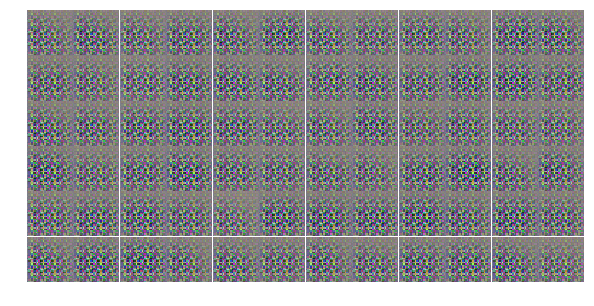

Epoch 1/25... Discriminator Loss: 0.2393... Generator Loss: 1.9718
Epoch 1/25... Discriminator Loss: 0.2966... Generator Loss: 1.8525
Epoch 1/25... Discriminator Loss: 0.2954... Generator Loss: 2.1307
Epoch 1/25... Discriminator Loss: 0.4416... Generator Loss: 2.4011
Epoch 1/25... Discriminator Loss: 0.7779... Generator Loss: 1.5740
Epoch 1/25... Discriminator Loss: 0.5581... Generator Loss: 1.6634
Epoch 1/25... Discriminator Loss: 0.4945... Generator Loss: 1.7812
Epoch 1/25... Discriminator Loss: 0.3990... Generator Loss: 1.9484
Epoch 1/25... Discriminator Loss: 0.4409... Generator Loss: 1.8104
Epoch 1/25... Discriminator Loss: 0.4599... Generator Loss: 1.6932


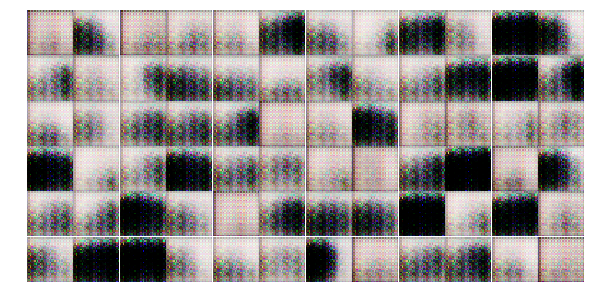

Epoch 1/25... Discriminator Loss: 0.3562... Generator Loss: 1.9000
Epoch 1/25... Discriminator Loss: 0.3785... Generator Loss: 1.8698
Epoch 1/25... Discriminator Loss: 0.4780... Generator Loss: 1.7704
Epoch 1/25... Discriminator Loss: 0.3585... Generator Loss: 1.9395
Epoch 1/25... Discriminator Loss: 0.3487... Generator Loss: 1.9754
Epoch 1/25... Discriminator Loss: 0.4169... Generator Loss: 1.8495
Epoch 1/25... Discriminator Loss: 0.4993... Generator Loss: 1.6065
Epoch 1/25... Discriminator Loss: 0.3421... Generator Loss: 1.9188
Epoch 1/25... Discriminator Loss: 0.5855... Generator Loss: 1.5432
Epoch 1/25... Discriminator Loss: 0.4887... Generator Loss: 1.6742


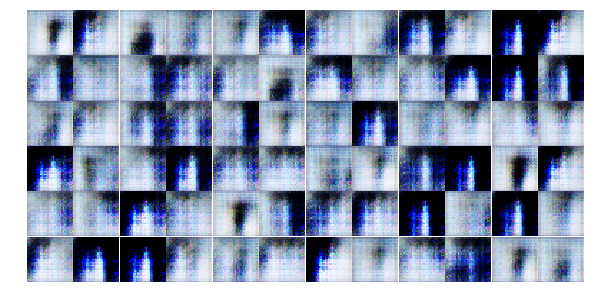

Epoch 1/25... Discriminator Loss: 0.5699... Generator Loss: 1.9294
Epoch 1/25... Discriminator Loss: 0.6077... Generator Loss: 1.6588
Epoch 1/25... Discriminator Loss: 0.5611... Generator Loss: 1.4680
Epoch 1/25... Discriminator Loss: 0.6692... Generator Loss: 1.4446
Epoch 1/25... Discriminator Loss: 0.6025... Generator Loss: 1.4538
Epoch 1/25... Discriminator Loss: 0.5194... Generator Loss: 1.6563
Epoch 1/25... Discriminator Loss: 0.6513... Generator Loss: 1.5625
Epoch 1/25... Discriminator Loss: 0.4659... Generator Loss: 1.7757
Epoch 1/25... Discriminator Loss: 0.5303... Generator Loss: 1.7174
Epoch 1/25... Discriminator Loss: 0.5966... Generator Loss: 1.4116


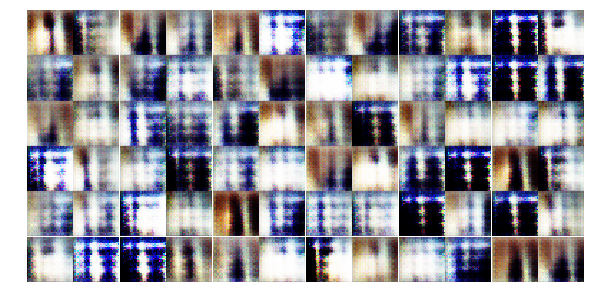

Epoch 1/25... Discriminator Loss: 0.6915... Generator Loss: 1.6490
Epoch 1/25... Discriminator Loss: 0.4473... Generator Loss: 1.6174
Epoch 1/25... Discriminator Loss: 0.5757... Generator Loss: 1.6766
Epoch 1/25... Discriminator Loss: 0.6234... Generator Loss: 1.4535
Epoch 1/25... Discriminator Loss: 0.5724... Generator Loss: 1.3456
Epoch 1/25... Discriminator Loss: 0.7610... Generator Loss: 1.0252
Epoch 1/25... Discriminator Loss: 0.7583... Generator Loss: 0.9919
Epoch 1/25... Discriminator Loss: 0.5345... Generator Loss: 1.4286
Epoch 1/25... Discriminator Loss: 0.6806... Generator Loss: 1.7743
Epoch 1/25... Discriminator Loss: 1.2463... Generator Loss: 0.9187


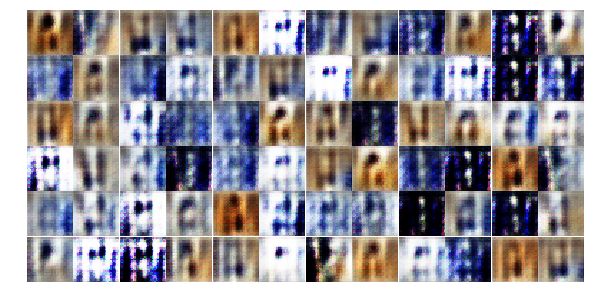

Epoch 1/25... Discriminator Loss: 0.9815... Generator Loss: 0.9411
Epoch 1/25... Discriminator Loss: 1.0486... Generator Loss: 1.1008
Epoch 1/25... Discriminator Loss: 0.7202... Generator Loss: 1.0595
Epoch 1/25... Discriminator Loss: 0.5238... Generator Loss: 1.4770
Epoch 1/25... Discriminator Loss: 0.6488... Generator Loss: 2.6211
Epoch 1/25... Discriminator Loss: 0.8930... Generator Loss: 0.9531
Epoch 1/25... Discriminator Loss: 0.3560... Generator Loss: 2.9406
Epoch 2/25... Discriminator Loss: 0.4466... Generator Loss: 2.0368
Epoch 2/25... Discriminator Loss: 0.8207... Generator Loss: 1.2319
Epoch 2/25... Discriminator Loss: 1.1229... Generator Loss: 1.9728


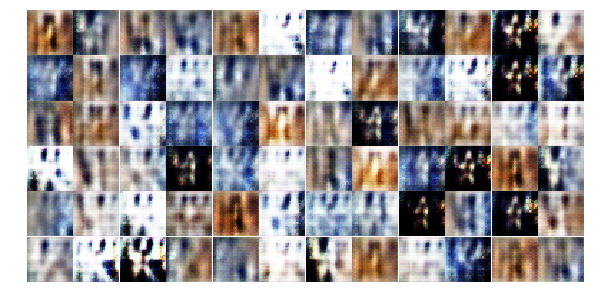

Epoch 2/25... Discriminator Loss: 0.6028... Generator Loss: 1.4620
Epoch 2/25... Discriminator Loss: 0.3560... Generator Loss: 1.9932
Epoch 2/25... Discriminator Loss: 0.8497... Generator Loss: 1.0555
Epoch 2/25... Discriminator Loss: 0.6568... Generator Loss: 1.1009
Epoch 2/25... Discriminator Loss: 0.6248... Generator Loss: 1.1356
Epoch 2/25... Discriminator Loss: 0.5342... Generator Loss: 2.3360
Epoch 2/25... Discriminator Loss: 0.3458... Generator Loss: 2.0907
Epoch 2/25... Discriminator Loss: 0.5963... Generator Loss: 1.3661
Epoch 2/25... Discriminator Loss: 0.9483... Generator Loss: 1.8134
Epoch 2/25... Discriminator Loss: 0.7513... Generator Loss: 1.0355


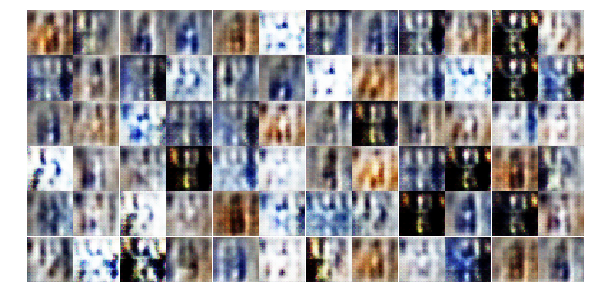

Epoch 2/25... Discriminator Loss: 1.0206... Generator Loss: 2.9299
Epoch 2/25... Discriminator Loss: 0.3675... Generator Loss: 2.5954
Epoch 2/25... Discriminator Loss: 0.4312... Generator Loss: 1.3510
Epoch 2/25... Discriminator Loss: 0.3451... Generator Loss: 3.0506
Epoch 2/25... Discriminator Loss: 1.0942... Generator Loss: 2.1453
Epoch 2/25... Discriminator Loss: 0.9954... Generator Loss: 0.7311
Epoch 2/25... Discriminator Loss: 0.7057... Generator Loss: 0.9795
Epoch 2/25... Discriminator Loss: 0.8719... Generator Loss: 0.8571
Epoch 2/25... Discriminator Loss: 0.5101... Generator Loss: 1.5076
Epoch 2/25... Discriminator Loss: 0.4726... Generator Loss: 2.4394


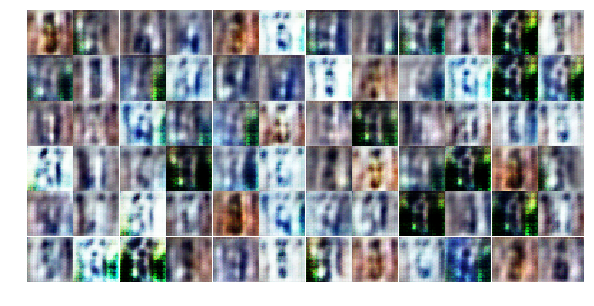

Epoch 2/25... Discriminator Loss: 2.1312... Generator Loss: 3.5924
Epoch 2/25... Discriminator Loss: 0.6397... Generator Loss: 3.1471
Epoch 2/25... Discriminator Loss: 0.3994... Generator Loss: 1.8642
Epoch 2/25... Discriminator Loss: 0.8930... Generator Loss: 0.7331
Epoch 2/25... Discriminator Loss: 1.1150... Generator Loss: 2.4042
Epoch 2/25... Discriminator Loss: 0.9581... Generator Loss: 2.6291
Epoch 2/25... Discriminator Loss: 0.8088... Generator Loss: 0.9029
Epoch 2/25... Discriminator Loss: 0.7600... Generator Loss: 1.2606
Epoch 2/25... Discriminator Loss: 1.1507... Generator Loss: 0.5946
Epoch 2/25... Discriminator Loss: 0.9055... Generator Loss: 2.2878


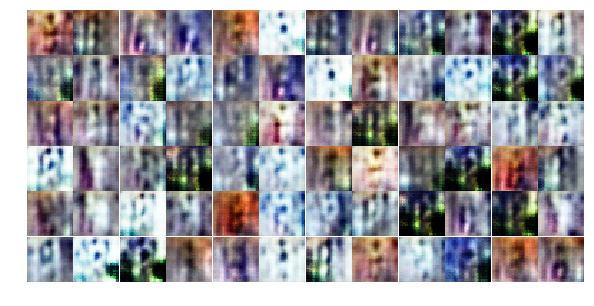

Epoch 2/25... Discriminator Loss: 0.6234... Generator Loss: 1.2118
Epoch 2/25... Discriminator Loss: 0.6789... Generator Loss: 1.4387
Epoch 2/25... Discriminator Loss: 0.3197... Generator Loss: 2.9130
Epoch 2/25... Discriminator Loss: 0.8149... Generator Loss: 0.8216
Epoch 2/25... Discriminator Loss: 0.4742... Generator Loss: 2.3006
Epoch 2/25... Discriminator Loss: 1.3544... Generator Loss: 2.4178
Epoch 2/25... Discriminator Loss: 0.6016... Generator Loss: 2.4674
Epoch 2/25... Discriminator Loss: 0.5362... Generator Loss: 1.3052
Epoch 2/25... Discriminator Loss: 1.0380... Generator Loss: 0.6310
Epoch 2/25... Discriminator Loss: 0.4461... Generator Loss: 1.8875


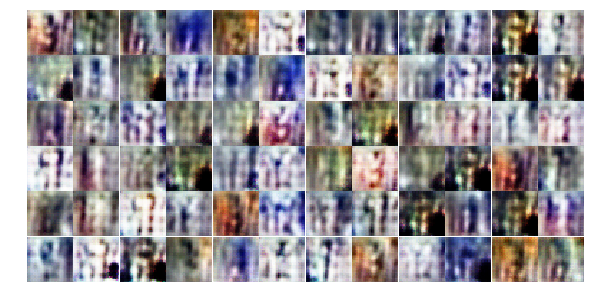

Epoch 2/25... Discriminator Loss: 0.4281... Generator Loss: 2.0986
Epoch 2/25... Discriminator Loss: 1.1141... Generator Loss: 1.3446
Epoch 2/25... Discriminator Loss: 0.3813... Generator Loss: 1.9849
Epoch 2/25... Discriminator Loss: 0.8960... Generator Loss: 1.8786
Epoch 2/25... Discriminator Loss: 0.6731... Generator Loss: 1.1190
Epoch 2/25... Discriminator Loss: 0.4207... Generator Loss: 1.7339
Epoch 2/25... Discriminator Loss: 0.6981... Generator Loss: 1.6124
Epoch 2/25... Discriminator Loss: 1.4093... Generator Loss: 2.0819
Epoch 2/25... Discriminator Loss: 0.7978... Generator Loss: 1.0078
Epoch 2/25... Discriminator Loss: 0.9330... Generator Loss: 0.8361


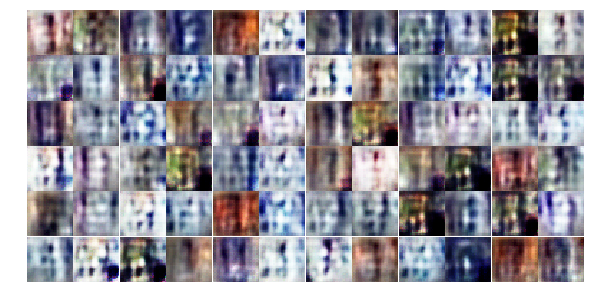

Epoch 2/25... Discriminator Loss: 0.5529... Generator Loss: 2.2506
Epoch 2/25... Discriminator Loss: 0.4783... Generator Loss: 2.0154
Epoch 2/25... Discriminator Loss: 0.8629... Generator Loss: 0.7570
Epoch 2/25... Discriminator Loss: 0.7453... Generator Loss: 0.8803
Epoch 3/25... Discriminator Loss: 1.2158... Generator Loss: 2.1947
Epoch 3/25... Discriminator Loss: 0.6571... Generator Loss: 1.5863
Epoch 3/25... Discriminator Loss: 0.4497... Generator Loss: 1.6884
Epoch 3/25... Discriminator Loss: 0.6860... Generator Loss: 1.0693
Epoch 3/25... Discriminator Loss: 0.8343... Generator Loss: 1.0588
Epoch 3/25... Discriminator Loss: 1.0674... Generator Loss: 0.9313


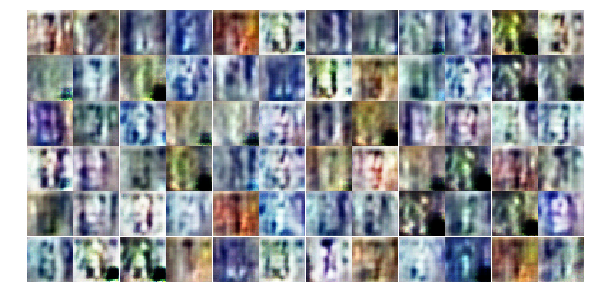

Epoch 3/25... Discriminator Loss: 1.3242... Generator Loss: 1.1824
Epoch 3/25... Discriminator Loss: 0.7179... Generator Loss: 1.4103
Epoch 3/25... Discriminator Loss: 0.5948... Generator Loss: 1.4232
Epoch 3/25... Discriminator Loss: 1.2066... Generator Loss: 0.6630
Epoch 3/25... Discriminator Loss: 0.9443... Generator Loss: 0.8088
Epoch 3/25... Discriminator Loss: 0.8554... Generator Loss: 0.8318
Epoch 3/25... Discriminator Loss: 1.0239... Generator Loss: 1.0040
Epoch 3/25... Discriminator Loss: 1.1093... Generator Loss: 1.9725
Epoch 3/25... Discriminator Loss: 1.0574... Generator Loss: 1.2395
Epoch 3/25... Discriminator Loss: 0.7946... Generator Loss: 0.9915


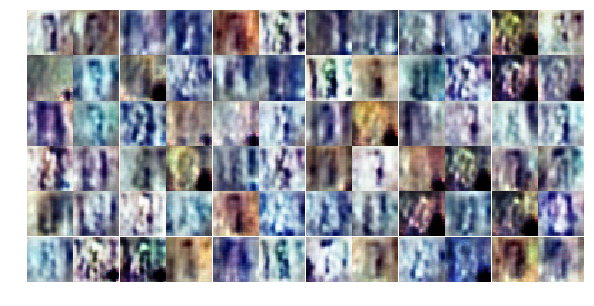

Epoch 3/25... Discriminator Loss: 0.9466... Generator Loss: 0.8238
Epoch 3/25... Discriminator Loss: 0.2405... Generator Loss: 2.7819
Epoch 3/25... Discriminator Loss: 0.8316... Generator Loss: 0.9273
Epoch 3/25... Discriminator Loss: 0.6479... Generator Loss: 1.9664
Epoch 3/25... Discriminator Loss: 1.0064... Generator Loss: 0.6892
Epoch 3/25... Discriminator Loss: 0.6475... Generator Loss: 1.5399
Epoch 3/25... Discriminator Loss: 1.0204... Generator Loss: 1.0645
Epoch 3/25... Discriminator Loss: 0.9275... Generator Loss: 2.6185
Epoch 3/25... Discriminator Loss: 0.6766... Generator Loss: 1.4492
Epoch 3/25... Discriminator Loss: 0.6988... Generator Loss: 2.3144


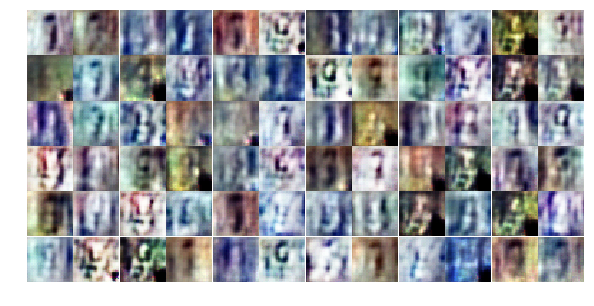

Epoch 3/25... Discriminator Loss: 0.7147... Generator Loss: 1.1585
Epoch 3/25... Discriminator Loss: 0.4543... Generator Loss: 2.5772
Epoch 3/25... Discriminator Loss: 0.6412... Generator Loss: 1.8987
Epoch 3/25... Discriminator Loss: 1.0564... Generator Loss: 0.6682
Epoch 3/25... Discriminator Loss: 0.9627... Generator Loss: 0.9477
Epoch 3/25... Discriminator Loss: 1.1014... Generator Loss: 0.6790
Epoch 3/25... Discriminator Loss: 0.6486... Generator Loss: 1.7004
Epoch 3/25... Discriminator Loss: 0.7473... Generator Loss: 1.4436
Epoch 3/25... Discriminator Loss: 0.8485... Generator Loss: 1.1594
Epoch 3/25... Discriminator Loss: 0.6392... Generator Loss: 1.5534


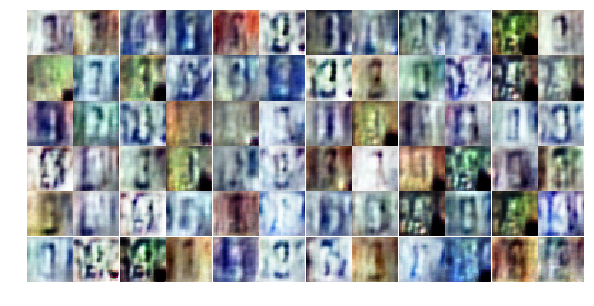

Epoch 3/25... Discriminator Loss: 0.4204... Generator Loss: 2.6223
Epoch 3/25... Discriminator Loss: 1.1456... Generator Loss: 0.6771
Epoch 3/25... Discriminator Loss: 0.7059... Generator Loss: 1.2462
Epoch 3/25... Discriminator Loss: 0.5844... Generator Loss: 1.9175
Epoch 3/25... Discriminator Loss: 0.5305... Generator Loss: 2.1367
Epoch 3/25... Discriminator Loss: 1.0154... Generator Loss: 2.6247
Epoch 3/25... Discriminator Loss: 1.0164... Generator Loss: 0.6901
Epoch 3/25... Discriminator Loss: 0.4757... Generator Loss: 2.0856
Epoch 3/25... Discriminator Loss: 1.0399... Generator Loss: 1.5234
Epoch 3/25... Discriminator Loss: 0.8766... Generator Loss: 1.3158


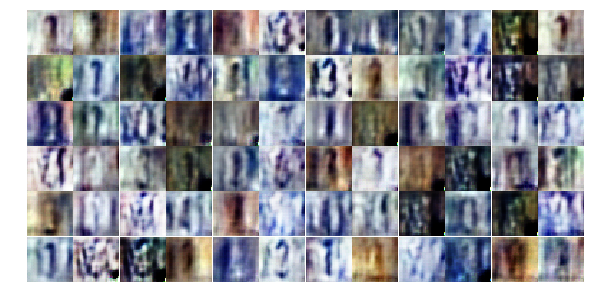

Epoch 3/25... Discriminator Loss: 0.9135... Generator Loss: 1.8271
Epoch 3/25... Discriminator Loss: 0.9328... Generator Loss: 1.0626
Epoch 3/25... Discriminator Loss: 0.7278... Generator Loss: 1.1913
Epoch 3/25... Discriminator Loss: 0.8807... Generator Loss: 1.2401
Epoch 3/25... Discriminator Loss: 0.6769... Generator Loss: 2.0497
Epoch 3/25... Discriminator Loss: 0.5901... Generator Loss: 1.7412
Epoch 3/25... Discriminator Loss: 0.5712... Generator Loss: 1.5765
Epoch 3/25... Discriminator Loss: 0.7026... Generator Loss: 2.0573
Epoch 3/25... Discriminator Loss: 0.9349... Generator Loss: 1.4498
Epoch 3/25... Discriminator Loss: 0.6950... Generator Loss: 1.9891


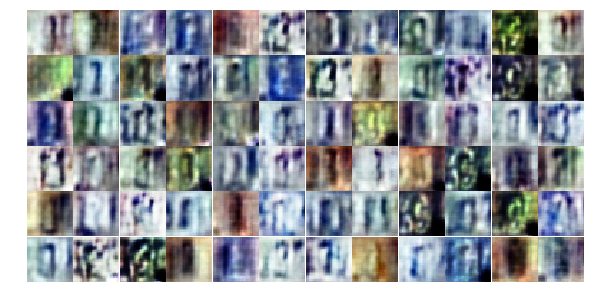

Epoch 3/25... Discriminator Loss: 0.7512... Generator Loss: 1.0660
Epoch 4/25... Discriminator Loss: 0.7913... Generator Loss: 1.3943
Epoch 4/25... Discriminator Loss: 0.7704... Generator Loss: 0.9578
Epoch 4/25... Discriminator Loss: 1.2106... Generator Loss: 0.7269
Epoch 4/25... Discriminator Loss: 0.8743... Generator Loss: 1.3460
Epoch 4/25... Discriminator Loss: 0.7399... Generator Loss: 1.4675
Epoch 4/25... Discriminator Loss: 0.6631... Generator Loss: 1.7171
Epoch 4/25... Discriminator Loss: 0.8413... Generator Loss: 1.3451
Epoch 4/25... Discriminator Loss: 0.8144... Generator Loss: 1.2330
Epoch 4/25... Discriminator Loss: 0.7213... Generator Loss: 1.8422


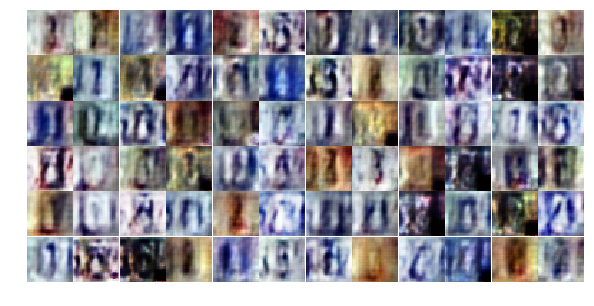

Epoch 4/25... Discriminator Loss: 0.7861... Generator Loss: 1.3882
Epoch 4/25... Discriminator Loss: 1.5641... Generator Loss: 0.3228
Epoch 4/25... Discriminator Loss: 1.4025... Generator Loss: 0.8834
Epoch 4/25... Discriminator Loss: 0.8824... Generator Loss: 1.2059
Epoch 4/25... Discriminator Loss: 0.7784... Generator Loss: 1.5129
Epoch 4/25... Discriminator Loss: 0.9565... Generator Loss: 0.8159
Epoch 4/25... Discriminator Loss: 0.5996... Generator Loss: 1.4002
Epoch 4/25... Discriminator Loss: 0.7256... Generator Loss: 1.1616
Epoch 4/25... Discriminator Loss: 0.5212... Generator Loss: 1.8547
Epoch 4/25... Discriminator Loss: 0.7704... Generator Loss: 1.6499


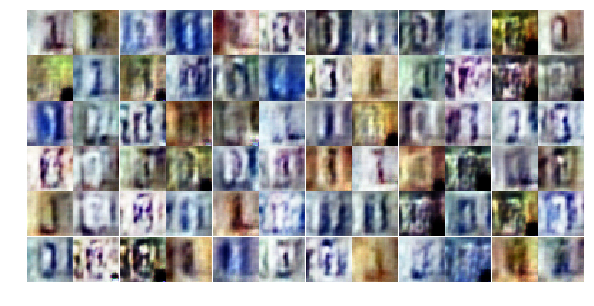

Epoch 4/25... Discriminator Loss: 1.1944... Generator Loss: 0.5319
Epoch 4/25... Discriminator Loss: 0.7539... Generator Loss: 2.1484
Epoch 4/25... Discriminator Loss: 1.1922... Generator Loss: 0.6916
Epoch 4/25... Discriminator Loss: 0.9578... Generator Loss: 1.5717
Epoch 4/25... Discriminator Loss: 0.5358... Generator Loss: 2.0927
Epoch 4/25... Discriminator Loss: 0.6750... Generator Loss: 1.8577
Epoch 4/25... Discriminator Loss: 0.6095... Generator Loss: 1.4498
Epoch 4/25... Discriminator Loss: 0.7462... Generator Loss: 1.0809
Epoch 4/25... Discriminator Loss: 0.9983... Generator Loss: 0.7243
Epoch 4/25... Discriminator Loss: 0.8578... Generator Loss: 2.0206


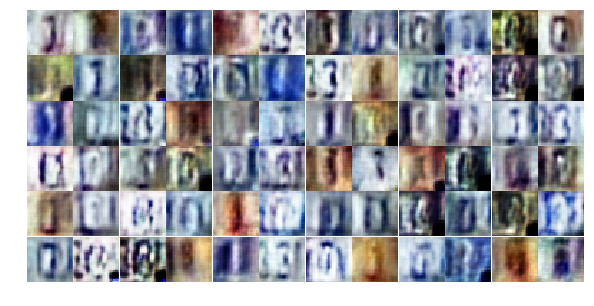

Epoch 4/25... Discriminator Loss: 0.9179... Generator Loss: 1.3545
Epoch 4/25... Discriminator Loss: 1.0981... Generator Loss: 1.2044
Epoch 4/25... Discriminator Loss: 0.8078... Generator Loss: 1.1355
Epoch 4/25... Discriminator Loss: 0.6139... Generator Loss: 1.7387
Epoch 4/25... Discriminator Loss: 0.7632... Generator Loss: 1.2332
Epoch 4/25... Discriminator Loss: 0.5994... Generator Loss: 1.6284
Epoch 4/25... Discriminator Loss: 0.7822... Generator Loss: 1.2315
Epoch 4/25... Discriminator Loss: 0.5766... Generator Loss: 2.1921
Epoch 4/25... Discriminator Loss: 0.4125... Generator Loss: 2.3627
Epoch 4/25... Discriminator Loss: 0.8413... Generator Loss: 1.2275


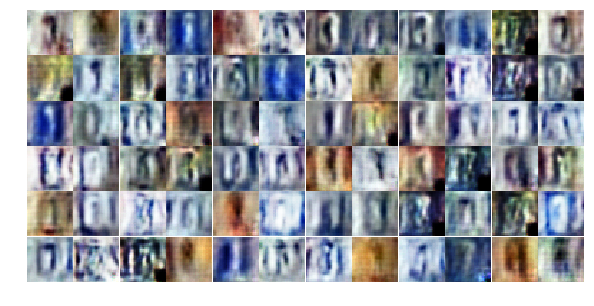

Epoch 4/25... Discriminator Loss: 0.7281... Generator Loss: 1.0173
Epoch 4/25... Discriminator Loss: 1.0034... Generator Loss: 1.0090
Epoch 4/25... Discriminator Loss: 0.8178... Generator Loss: 0.9509
Epoch 4/25... Discriminator Loss: 0.9009... Generator Loss: 1.1047
Epoch 4/25... Discriminator Loss: 0.7537... Generator Loss: 1.3770
Epoch 4/25... Discriminator Loss: 0.8382... Generator Loss: 1.2423
Epoch 4/25... Discriminator Loss: 0.8870... Generator Loss: 0.7970
Epoch 4/25... Discriminator Loss: 1.3486... Generator Loss: 1.2977
Epoch 4/25... Discriminator Loss: 0.9853... Generator Loss: 1.2911
Epoch 4/25... Discriminator Loss: 0.7779... Generator Loss: 2.0328


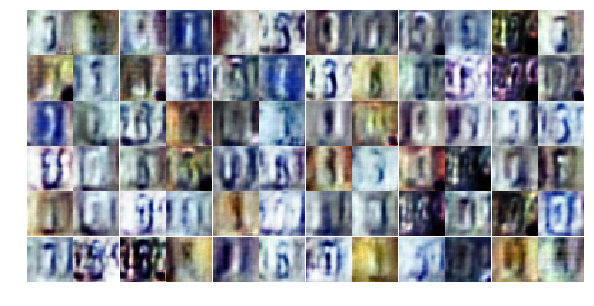

Epoch 4/25... Discriminator Loss: 1.0044... Generator Loss: 0.9566
Epoch 4/25... Discriminator Loss: 0.6077... Generator Loss: 1.3953
Epoch 4/25... Discriminator Loss: 0.7837... Generator Loss: 1.5361
Epoch 4/25... Discriminator Loss: 0.7299... Generator Loss: 1.6799
Epoch 4/25... Discriminator Loss: 0.9019... Generator Loss: 1.6340
Epoch 4/25... Discriminator Loss: 0.7473... Generator Loss: 1.1806
Epoch 4/25... Discriminator Loss: 0.8199... Generator Loss: 1.0502
Epoch 4/25... Discriminator Loss: 0.8166... Generator Loss: 1.2382
Epoch 4/25... Discriminator Loss: 1.1591... Generator Loss: 0.5591
Epoch 5/25... Discriminator Loss: 1.2042... Generator Loss: 0.6155


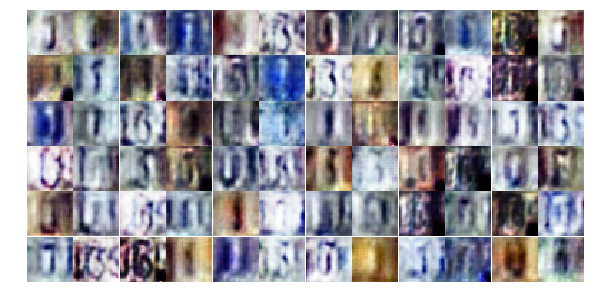

Epoch 5/25... Discriminator Loss: 0.9012... Generator Loss: 1.4063
Epoch 5/25... Discriminator Loss: 1.0708... Generator Loss: 1.0018
Epoch 5/25... Discriminator Loss: 0.9082... Generator Loss: 1.2606
Epoch 5/25... Discriminator Loss: 0.8362... Generator Loss: 1.0864
Epoch 5/25... Discriminator Loss: 0.4572... Generator Loss: 2.5406
Epoch 5/25... Discriminator Loss: 0.5418... Generator Loss: 1.6667
Epoch 5/25... Discriminator Loss: 0.8784... Generator Loss: 1.2340
Epoch 5/25... Discriminator Loss: 0.6960... Generator Loss: 1.4893
Epoch 5/25... Discriminator Loss: 0.7693... Generator Loss: 1.2696
Epoch 5/25... Discriminator Loss: 0.8502... Generator Loss: 0.8750


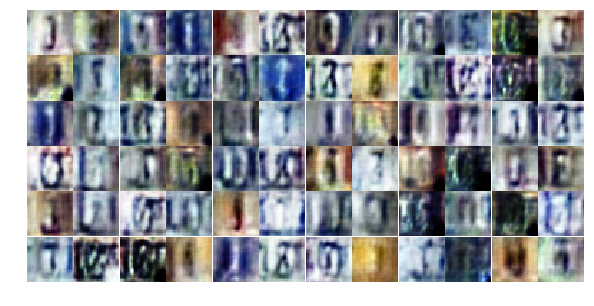

Epoch 5/25... Discriminator Loss: 1.3219... Generator Loss: 0.8309
Epoch 5/25... Discriminator Loss: 1.0563... Generator Loss: 0.7273
Epoch 5/25... Discriminator Loss: 0.8024... Generator Loss: 1.4908
Epoch 5/25... Discriminator Loss: 0.7082... Generator Loss: 1.5217
Epoch 5/25... Discriminator Loss: 0.7355... Generator Loss: 1.3686
Epoch 5/25... Discriminator Loss: 0.8426... Generator Loss: 1.5746
Epoch 5/25... Discriminator Loss: 0.9410... Generator Loss: 0.8677
Epoch 5/25... Discriminator Loss: 0.5795... Generator Loss: 1.4010
Epoch 5/25... Discriminator Loss: 0.9715... Generator Loss: 1.1391
Epoch 5/25... Discriminator Loss: 0.8610... Generator Loss: 1.6018


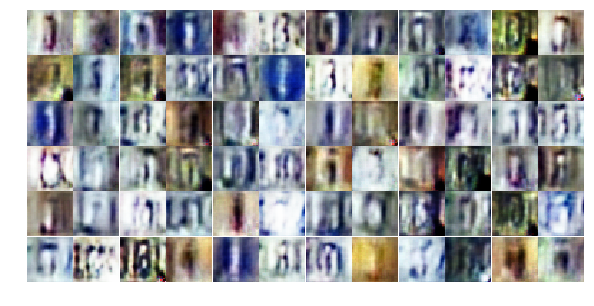

Epoch 5/25... Discriminator Loss: 0.6072... Generator Loss: 2.1565
Epoch 5/25... Discriminator Loss: 0.9337... Generator Loss: 1.2885
Epoch 5/25... Discriminator Loss: 0.5846... Generator Loss: 3.2077
Epoch 5/25... Discriminator Loss: 0.6770... Generator Loss: 1.6863
Epoch 5/25... Discriminator Loss: 0.8156... Generator Loss: 0.9592
Epoch 5/25... Discriminator Loss: 0.7966... Generator Loss: 1.1152
Epoch 5/25... Discriminator Loss: 0.9190... Generator Loss: 1.5117
Epoch 5/25... Discriminator Loss: 0.8374... Generator Loss: 2.1196
Epoch 5/25... Discriminator Loss: 0.7947... Generator Loss: 0.9606
Epoch 5/25... Discriminator Loss: 0.4757... Generator Loss: 1.7958


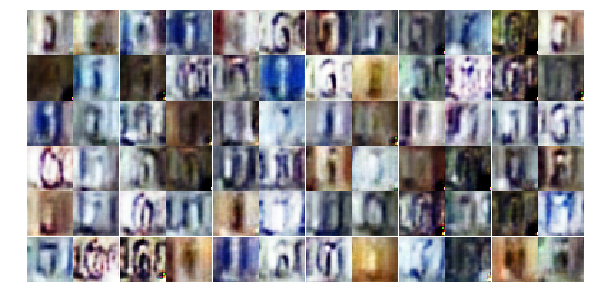

Epoch 5/25... Discriminator Loss: 0.4404... Generator Loss: 2.0391
Epoch 5/25... Discriminator Loss: 0.8251... Generator Loss: 1.4270
Epoch 5/25... Discriminator Loss: 0.3183... Generator Loss: 2.6015
Epoch 5/25... Discriminator Loss: 0.8354... Generator Loss: 1.2493
Epoch 5/25... Discriminator Loss: 0.6726... Generator Loss: 1.0984
Epoch 5/25... Discriminator Loss: 0.7477... Generator Loss: 1.5848
Epoch 5/25... Discriminator Loss: 0.3426... Generator Loss: 2.5868
Epoch 5/25... Discriminator Loss: 0.6954... Generator Loss: 1.4493
Epoch 5/25... Discriminator Loss: 0.5680... Generator Loss: 1.6767
Epoch 5/25... Discriminator Loss: 0.2666... Generator Loss: 2.8280


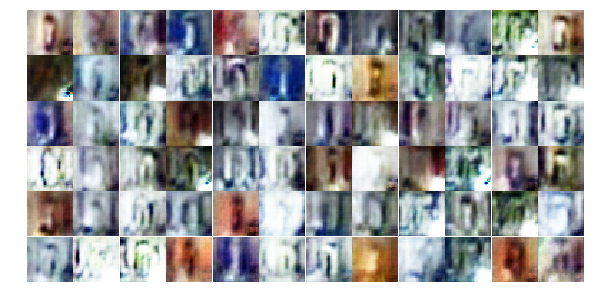

Epoch 5/25... Discriminator Loss: 0.7032... Generator Loss: 1.1514
Epoch 5/25... Discriminator Loss: 0.6922... Generator Loss: 1.3479
Epoch 5/25... Discriminator Loss: 1.3401... Generator Loss: 0.5710
Epoch 5/25... Discriminator Loss: 1.3219... Generator Loss: 0.4544
Epoch 5/25... Discriminator Loss: 1.1158... Generator Loss: 1.3025
Epoch 5/25... Discriminator Loss: 1.0705... Generator Loss: 1.1874
Epoch 5/25... Discriminator Loss: 1.1534... Generator Loss: 1.7505
Epoch 5/25... Discriminator Loss: 0.7532... Generator Loss: 1.4372
Epoch 5/25... Discriminator Loss: 1.1516... Generator Loss: 0.8685
Epoch 5/25... Discriminator Loss: 1.0615... Generator Loss: 1.3865


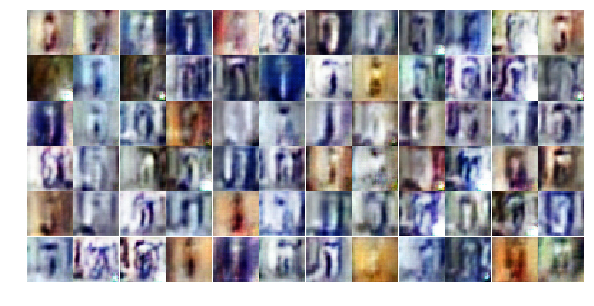

Epoch 5/25... Discriminator Loss: 0.8367... Generator Loss: 1.1345
Epoch 5/25... Discriminator Loss: 1.1122... Generator Loss: 1.2815
Epoch 5/25... Discriminator Loss: 0.9154... Generator Loss: 1.8100
Epoch 5/25... Discriminator Loss: 1.1866... Generator Loss: 0.9586
Epoch 5/25... Discriminator Loss: 1.3096... Generator Loss: 1.0263
Epoch 5/25... Discriminator Loss: 1.0875... Generator Loss: 0.7236
Epoch 6/25... Discriminator Loss: 0.6672... Generator Loss: 1.1727
Epoch 6/25... Discriminator Loss: 0.9081... Generator Loss: 0.9700
Epoch 6/25... Discriminator Loss: 1.0342... Generator Loss: 1.1956
Epoch 6/25... Discriminator Loss: 0.9506... Generator Loss: 0.9114


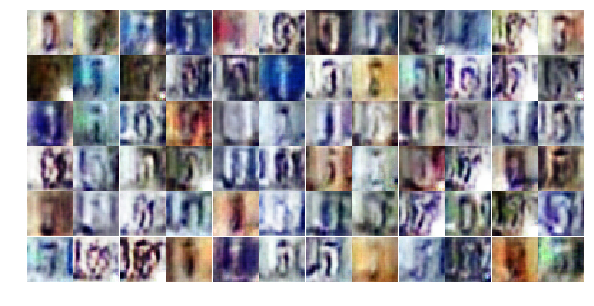

Epoch 6/25... Discriminator Loss: 0.8167... Generator Loss: 1.1794
Epoch 6/25... Discriminator Loss: 0.5257... Generator Loss: 1.7849
Epoch 6/25... Discriminator Loss: 0.7993... Generator Loss: 1.6295
Epoch 6/25... Discriminator Loss: 0.5311... Generator Loss: 2.3713
Epoch 6/25... Discriminator Loss: 0.8328... Generator Loss: 1.1465
Epoch 6/25... Discriminator Loss: 0.8921... Generator Loss: 1.1535
Epoch 6/25... Discriminator Loss: 1.2048... Generator Loss: 0.9792
Epoch 6/25... Discriminator Loss: 1.2204... Generator Loss: 1.3630
Epoch 6/25... Discriminator Loss: 0.9260... Generator Loss: 1.0628
Epoch 6/25... Discriminator Loss: 0.8526... Generator Loss: 1.6995


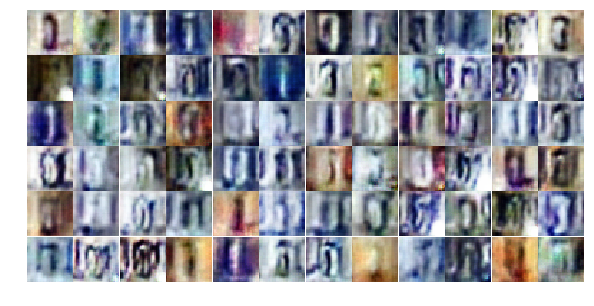

Epoch 6/25... Discriminator Loss: 1.0349... Generator Loss: 0.6670
Epoch 6/25... Discriminator Loss: 0.8636... Generator Loss: 1.2321
Epoch 6/25... Discriminator Loss: 1.0882... Generator Loss: 1.2440
Epoch 6/25... Discriminator Loss: 0.5630... Generator Loss: 1.8769
Epoch 6/25... Discriminator Loss: 0.4805... Generator Loss: 2.0032
Epoch 6/25... Discriminator Loss: 1.0358... Generator Loss: 0.7386
Epoch 6/25... Discriminator Loss: 1.1307... Generator Loss: 1.3147
Epoch 6/25... Discriminator Loss: 0.9632... Generator Loss: 0.8722
Epoch 6/25... Discriminator Loss: 1.0671... Generator Loss: 0.8981
Epoch 6/25... Discriminator Loss: 1.2052... Generator Loss: 0.8199


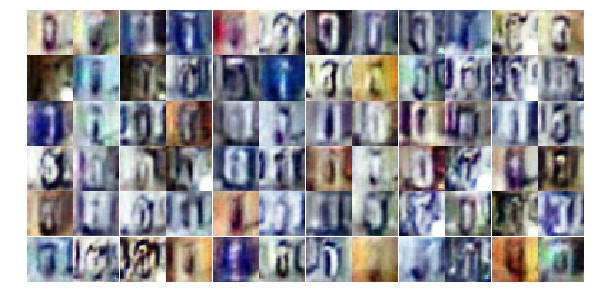

Epoch 6/25... Discriminator Loss: 0.9166... Generator Loss: 0.9493
Epoch 6/25... Discriminator Loss: 0.9774... Generator Loss: 1.0058
Epoch 6/25... Discriminator Loss: 1.2506... Generator Loss: 0.5125
Epoch 6/25... Discriminator Loss: 0.9666... Generator Loss: 1.1746
Epoch 6/25... Discriminator Loss: 1.2814... Generator Loss: 0.9851
Epoch 6/25... Discriminator Loss: 1.1962... Generator Loss: 1.2513
Epoch 6/25... Discriminator Loss: 0.6156... Generator Loss: 1.4297
Epoch 6/25... Discriminator Loss: 0.6370... Generator Loss: 1.9869
Epoch 6/25... Discriminator Loss: 1.1736... Generator Loss: 0.7812
Epoch 6/25... Discriminator Loss: 0.8626... Generator Loss: 1.2863


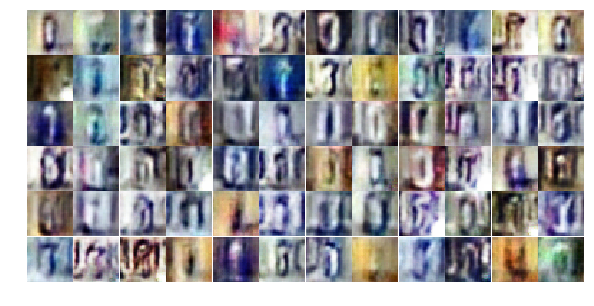

Epoch 6/25... Discriminator Loss: 0.8614... Generator Loss: 1.2856
Epoch 6/25... Discriminator Loss: 0.9121... Generator Loss: 1.0849
Epoch 6/25... Discriminator Loss: 1.0291... Generator Loss: 1.0965
Epoch 6/25... Discriminator Loss: 0.8928... Generator Loss: 0.8972
Epoch 6/25... Discriminator Loss: 1.0712... Generator Loss: 0.8419
Epoch 6/25... Discriminator Loss: 0.6620... Generator Loss: 1.6835
Epoch 6/25... Discriminator Loss: 0.7231... Generator Loss: 1.1225
Epoch 6/25... Discriminator Loss: 0.7587... Generator Loss: 1.4339
Epoch 6/25... Discriminator Loss: 1.0777... Generator Loss: 0.8095
Epoch 6/25... Discriminator Loss: 0.7864... Generator Loss: 1.2910


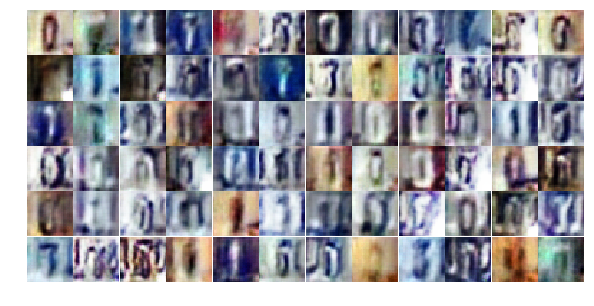

Epoch 6/25... Discriminator Loss: 1.0834... Generator Loss: 1.0963
Epoch 6/25... Discriminator Loss: 1.1727... Generator Loss: 0.7595
Epoch 6/25... Discriminator Loss: 1.1517... Generator Loss: 0.7944
Epoch 6/25... Discriminator Loss: 0.4658... Generator Loss: 2.6210
Epoch 6/25... Discriminator Loss: 0.8521... Generator Loss: 1.0893
Epoch 6/25... Discriminator Loss: 1.0453... Generator Loss: 0.7763
Epoch 6/25... Discriminator Loss: 0.6286... Generator Loss: 2.0538
Epoch 6/25... Discriminator Loss: 0.9287... Generator Loss: 1.0394
Epoch 6/25... Discriminator Loss: 0.9652... Generator Loss: 1.2434
Epoch 6/25... Discriminator Loss: 1.1580... Generator Loss: 0.7379


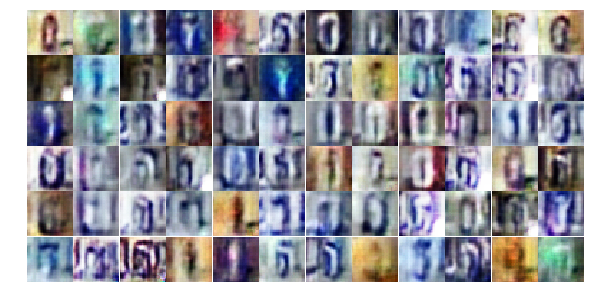

Epoch 6/25... Discriminator Loss: 1.0361... Generator Loss: 0.9323
Epoch 6/25... Discriminator Loss: 0.8058... Generator Loss: 1.1061
Epoch 6/25... Discriminator Loss: 1.0885... Generator Loss: 1.0699
Epoch 7/25... Discriminator Loss: 1.3081... Generator Loss: 1.1823
Epoch 7/25... Discriminator Loss: 1.0833... Generator Loss: 1.2304
Epoch 7/25... Discriminator Loss: 0.8325... Generator Loss: 1.5675
Epoch 7/25... Discriminator Loss: 1.1840... Generator Loss: 0.6676
Epoch 7/25... Discriminator Loss: 0.9156... Generator Loss: 0.8828
Epoch 7/25... Discriminator Loss: 0.6997... Generator Loss: 1.1752
Epoch 7/25... Discriminator Loss: 0.9891... Generator Loss: 0.8739


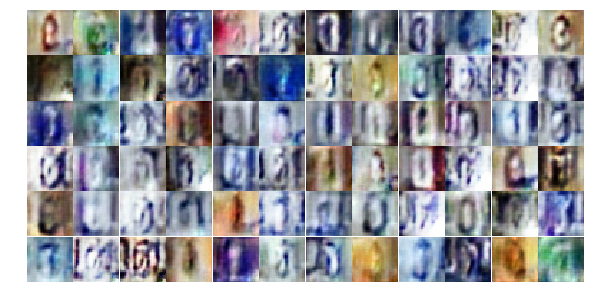

Epoch 7/25... Discriminator Loss: 1.0009... Generator Loss: 0.8187
Epoch 7/25... Discriminator Loss: 0.5672... Generator Loss: 1.8255
Epoch 7/25... Discriminator Loss: 0.6059... Generator Loss: 1.3993
Epoch 7/25... Discriminator Loss: 0.9966... Generator Loss: 0.8583
Epoch 7/25... Discriminator Loss: 0.8112... Generator Loss: 1.5885
Epoch 7/25... Discriminator Loss: 0.9970... Generator Loss: 0.9721
Epoch 7/25... Discriminator Loss: 0.9373... Generator Loss: 0.9461
Epoch 7/25... Discriminator Loss: 0.9697... Generator Loss: 1.6823
Epoch 7/25... Discriminator Loss: 1.0527... Generator Loss: 0.9246
Epoch 7/25... Discriminator Loss: 1.3930... Generator Loss: 1.1745


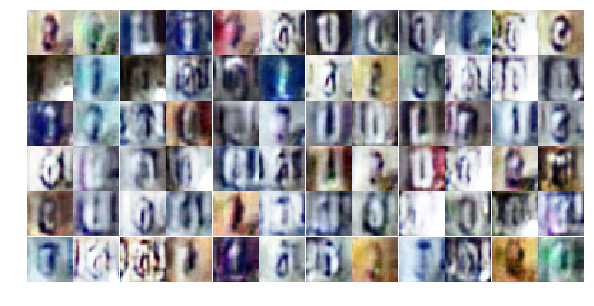

Epoch 7/25... Discriminator Loss: 0.9606... Generator Loss: 1.0810
Epoch 7/25... Discriminator Loss: 0.8738... Generator Loss: 1.2936
Epoch 7/25... Discriminator Loss: 1.1163... Generator Loss: 0.9827
Epoch 7/25... Discriminator Loss: 1.0198... Generator Loss: 1.0138
Epoch 7/25... Discriminator Loss: 1.0190... Generator Loss: 1.0121
Epoch 7/25... Discriminator Loss: 0.9987... Generator Loss: 1.0943
Epoch 7/25... Discriminator Loss: 1.0612... Generator Loss: 0.7371
Epoch 7/25... Discriminator Loss: 0.8599... Generator Loss: 1.2148
Epoch 7/25... Discriminator Loss: 1.2332... Generator Loss: 0.7911
Epoch 7/25... Discriminator Loss: 0.9530... Generator Loss: 1.1293


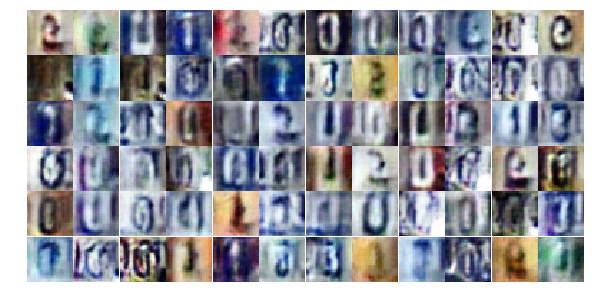

Epoch 7/25... Discriminator Loss: 1.0196... Generator Loss: 1.1714
Epoch 7/25... Discriminator Loss: 0.8682... Generator Loss: 1.1590
Epoch 7/25... Discriminator Loss: 1.0126... Generator Loss: 1.1457
Epoch 7/25... Discriminator Loss: 1.0788... Generator Loss: 0.7768
Epoch 7/25... Discriminator Loss: 1.0388... Generator Loss: 0.6749
Epoch 7/25... Discriminator Loss: 1.0959... Generator Loss: 0.7259
Epoch 7/25... Discriminator Loss: 1.0190... Generator Loss: 1.1532
Epoch 7/25... Discriminator Loss: 1.1484... Generator Loss: 1.4094
Epoch 7/25... Discriminator Loss: 0.8402... Generator Loss: 1.1429
Epoch 7/25... Discriminator Loss: 1.1092... Generator Loss: 0.8655


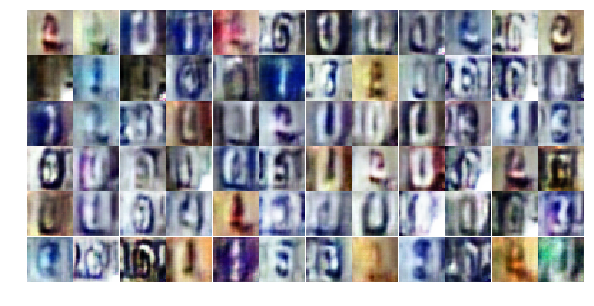

Epoch 7/25... Discriminator Loss: 0.9190... Generator Loss: 1.0365
Epoch 7/25... Discriminator Loss: 0.7015... Generator Loss: 1.0810
Epoch 7/25... Discriminator Loss: 0.9902... Generator Loss: 0.9016
Epoch 7/25... Discriminator Loss: 1.3290... Generator Loss: 1.2739
Epoch 7/25... Discriminator Loss: 0.9644... Generator Loss: 1.4067
Epoch 7/25... Discriminator Loss: 1.0640... Generator Loss: 1.1390
Epoch 7/25... Discriminator Loss: 0.7757... Generator Loss: 1.1023
Epoch 7/25... Discriminator Loss: 0.8690... Generator Loss: 0.9718
Epoch 7/25... Discriminator Loss: 1.0397... Generator Loss: 1.6065
Epoch 7/25... Discriminator Loss: 1.0069... Generator Loss: 0.8612


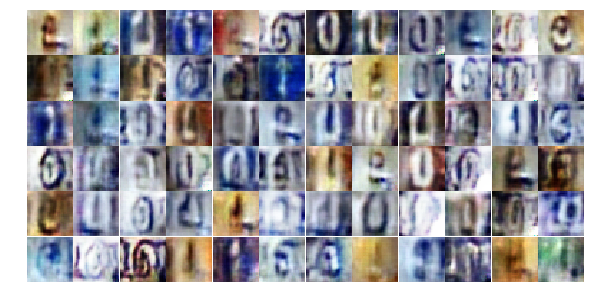

Epoch 7/25... Discriminator Loss: 0.8942... Generator Loss: 0.9478
Epoch 7/25... Discriminator Loss: 1.0486... Generator Loss: 1.1146
Epoch 7/25... Discriminator Loss: 0.9692... Generator Loss: 1.2884
Epoch 7/25... Discriminator Loss: 0.3590... Generator Loss: 2.2724
Epoch 7/25... Discriminator Loss: 0.4559... Generator Loss: 2.3114
Epoch 7/25... Discriminator Loss: 1.0324... Generator Loss: 1.1479
Epoch 7/25... Discriminator Loss: 1.0876... Generator Loss: 1.8229
Epoch 7/25... Discriminator Loss: 0.9388... Generator Loss: 0.8473
Epoch 7/25... Discriminator Loss: 0.9442... Generator Loss: 1.3656
Epoch 7/25... Discriminator Loss: 0.9472... Generator Loss: 1.1204


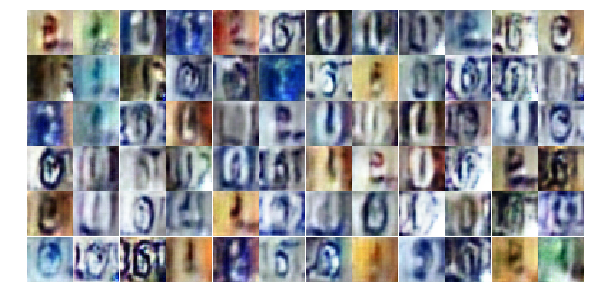

Epoch 7/25... Discriminator Loss: 1.2143... Generator Loss: 0.9412
Epoch 8/25... Discriminator Loss: 1.4087... Generator Loss: 1.0287
Epoch 8/25... Discriminator Loss: 0.7066... Generator Loss: 1.3348
Epoch 8/25... Discriminator Loss: 0.9274... Generator Loss: 0.8322
Epoch 8/25... Discriminator Loss: 0.9926... Generator Loss: 1.2394
Epoch 8/25... Discriminator Loss: 1.2608... Generator Loss: 0.6581
Epoch 8/25... Discriminator Loss: 1.2725... Generator Loss: 0.4756
Epoch 8/25... Discriminator Loss: 1.1499... Generator Loss: 0.9815
Epoch 8/25... Discriminator Loss: 1.1122... Generator Loss: 0.9472
Epoch 8/25... Discriminator Loss: 1.0433... Generator Loss: 1.2926


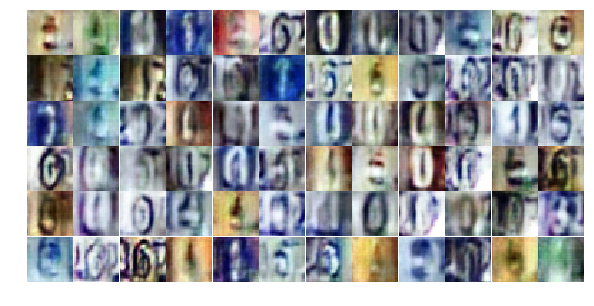

Epoch 8/25... Discriminator Loss: 0.7692... Generator Loss: 1.4596
Epoch 8/25... Discriminator Loss: 0.9394... Generator Loss: 1.0077
Epoch 8/25... Discriminator Loss: 1.4511... Generator Loss: 1.4172
Epoch 8/25... Discriminator Loss: 0.7709... Generator Loss: 1.3627
Epoch 8/25... Discriminator Loss: 1.1327... Generator Loss: 0.6684
Epoch 8/25... Discriminator Loss: 0.9748... Generator Loss: 1.1194
Epoch 8/25... Discriminator Loss: 0.6520... Generator Loss: 1.6984
Epoch 8/25... Discriminator Loss: 1.0646... Generator Loss: 1.2339
Epoch 8/25... Discriminator Loss: 0.9476... Generator Loss: 0.9572
Epoch 8/25... Discriminator Loss: 1.0966... Generator Loss: 1.0568


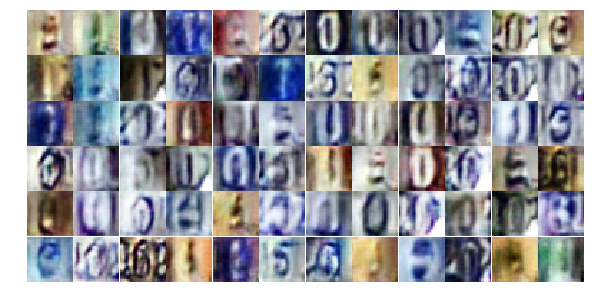

Epoch 8/25... Discriminator Loss: 0.9513... Generator Loss: 0.8842
Epoch 8/25... Discriminator Loss: 0.9047... Generator Loss: 1.1388
Epoch 8/25... Discriminator Loss: 0.8989... Generator Loss: 1.7723
Epoch 8/25... Discriminator Loss: 0.9204... Generator Loss: 1.2145
Epoch 8/25... Discriminator Loss: 1.0975... Generator Loss: 1.0178
Epoch 8/25... Discriminator Loss: 0.9880... Generator Loss: 0.8696
Epoch 8/25... Discriminator Loss: 1.0172... Generator Loss: 0.8452
Epoch 8/25... Discriminator Loss: 1.0181... Generator Loss: 1.2183
Epoch 8/25... Discriminator Loss: 1.2216... Generator Loss: 1.0582
Epoch 8/25... Discriminator Loss: 1.1743... Generator Loss: 0.6757


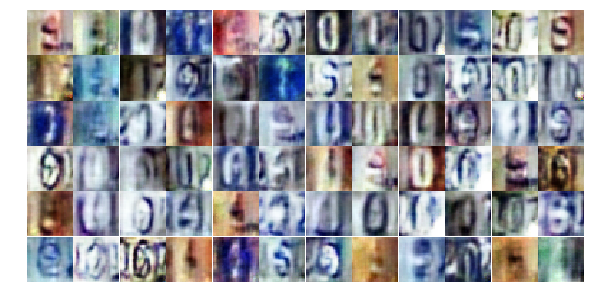

Epoch 8/25... Discriminator Loss: 1.0659... Generator Loss: 1.0086
Epoch 8/25... Discriminator Loss: 1.1875... Generator Loss: 0.7946
Epoch 8/25... Discriminator Loss: 0.9371... Generator Loss: 0.9281
Epoch 8/25... Discriminator Loss: 1.1147... Generator Loss: 1.1398
Epoch 8/25... Discriminator Loss: 0.7547... Generator Loss: 1.3390
Epoch 8/25... Discriminator Loss: 0.8329... Generator Loss: 1.5095
Epoch 8/25... Discriminator Loss: 0.9796... Generator Loss: 1.2534
Epoch 8/25... Discriminator Loss: 1.1263... Generator Loss: 0.7411
Epoch 8/25... Discriminator Loss: 1.0551... Generator Loss: 1.2664
Epoch 8/25... Discriminator Loss: 0.9481... Generator Loss: 1.0107


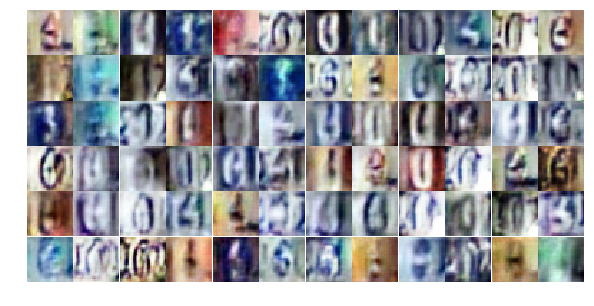

Epoch 8/25... Discriminator Loss: 1.0663... Generator Loss: 1.0381
Epoch 8/25... Discriminator Loss: 0.7925... Generator Loss: 1.2714
Epoch 8/25... Discriminator Loss: 0.9041... Generator Loss: 0.8918
Epoch 8/25... Discriminator Loss: 1.1521... Generator Loss: 0.8741
Epoch 8/25... Discriminator Loss: 1.1222... Generator Loss: 1.5092
Epoch 8/25... Discriminator Loss: 0.9273... Generator Loss: 1.4661
Epoch 8/25... Discriminator Loss: 1.0259... Generator Loss: 1.3530
Epoch 8/25... Discriminator Loss: 1.2838... Generator Loss: 1.0053
Epoch 8/25... Discriminator Loss: 0.8868... Generator Loss: 1.3308
Epoch 8/25... Discriminator Loss: 1.2378... Generator Loss: 1.0357


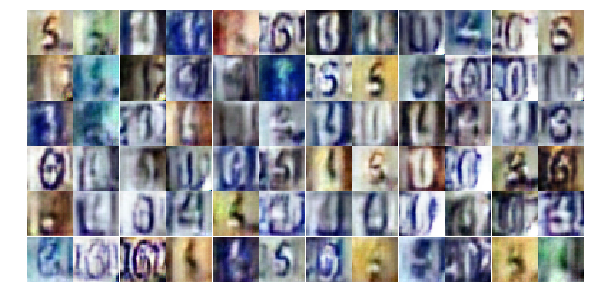

Epoch 8/25... Discriminator Loss: 0.9272... Generator Loss: 0.8269
Epoch 8/25... Discriminator Loss: 1.1924... Generator Loss: 0.7934
Epoch 8/25... Discriminator Loss: 0.9005... Generator Loss: 1.2932
Epoch 8/25... Discriminator Loss: 1.3827... Generator Loss: 0.7250
Epoch 8/25... Discriminator Loss: 0.8850... Generator Loss: 1.2856
Epoch 8/25... Discriminator Loss: 0.9991... Generator Loss: 0.8350
Epoch 8/25... Discriminator Loss: 0.8850... Generator Loss: 1.1767
Epoch 8/25... Discriminator Loss: 0.5026... Generator Loss: 2.9764
Epoch 9/25... Discriminator Loss: 0.6637... Generator Loss: 1.4707
Epoch 9/25... Discriminator Loss: 1.1963... Generator Loss: 0.5499


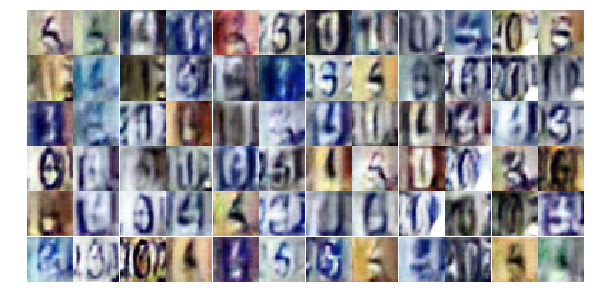

Epoch 9/25... Discriminator Loss: 0.9940... Generator Loss: 0.8397
Epoch 9/25... Discriminator Loss: 1.2620... Generator Loss: 1.1903
Epoch 9/25... Discriminator Loss: 0.8800... Generator Loss: 0.9854
Epoch 9/25... Discriminator Loss: 0.9713... Generator Loss: 0.8684
Epoch 9/25... Discriminator Loss: 0.9926... Generator Loss: 1.1283
Epoch 9/25... Discriminator Loss: 1.0582... Generator Loss: 1.0920
Epoch 9/25... Discriminator Loss: 1.1350... Generator Loss: 0.7298
Epoch 9/25... Discriminator Loss: 1.2870... Generator Loss: 1.0685
Epoch 9/25... Discriminator Loss: 1.1690... Generator Loss: 0.8066
Epoch 9/25... Discriminator Loss: 0.7069... Generator Loss: 1.3379


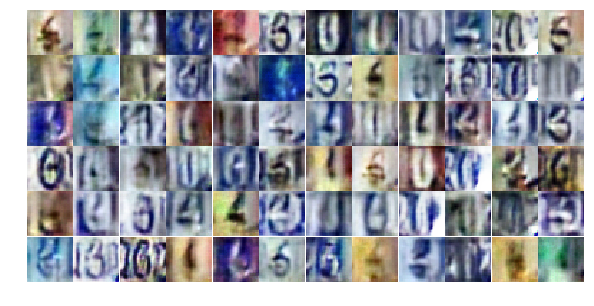

Epoch 9/25... Discriminator Loss: 1.1734... Generator Loss: 0.8043
Epoch 9/25... Discriminator Loss: 1.1100... Generator Loss: 0.7629
Epoch 9/25... Discriminator Loss: 1.0854... Generator Loss: 0.8866
Epoch 9/25... Discriminator Loss: 0.9259... Generator Loss: 1.1502
Epoch 9/25... Discriminator Loss: 1.2716... Generator Loss: 1.1498
Epoch 9/25... Discriminator Loss: 0.9503... Generator Loss: 0.8536
Epoch 9/25... Discriminator Loss: 1.0183... Generator Loss: 1.0744
Epoch 9/25... Discriminator Loss: 1.3263... Generator Loss: 0.6835
Epoch 9/25... Discriminator Loss: 1.1260... Generator Loss: 0.7889
Epoch 9/25... Discriminator Loss: 1.1145... Generator Loss: 0.9245


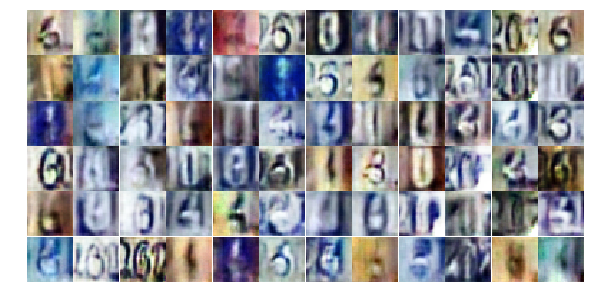

Epoch 9/25... Discriminator Loss: 1.1060... Generator Loss: 0.7799
Epoch 9/25... Discriminator Loss: 1.0211... Generator Loss: 1.3019
Epoch 9/25... Discriminator Loss: 1.1925... Generator Loss: 0.8172
Epoch 9/25... Discriminator Loss: 1.1247... Generator Loss: 1.1827
Epoch 9/25... Discriminator Loss: 1.2476... Generator Loss: 1.0226
Epoch 9/25... Discriminator Loss: 1.2285... Generator Loss: 0.7513
Epoch 9/25... Discriminator Loss: 1.0579... Generator Loss: 1.0791
Epoch 9/25... Discriminator Loss: 0.9686... Generator Loss: 1.3513
Epoch 9/25... Discriminator Loss: 0.8164... Generator Loss: 1.2077
Epoch 9/25... Discriminator Loss: 0.9140... Generator Loss: 1.0205


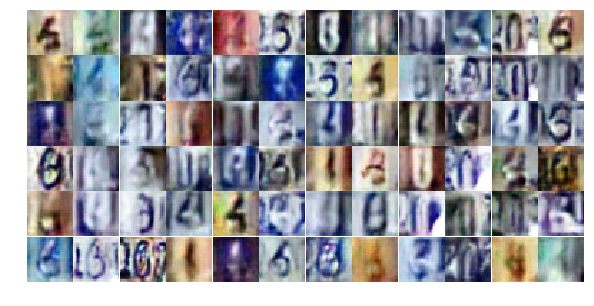

Epoch 9/25... Discriminator Loss: 1.0269... Generator Loss: 1.1750
Epoch 9/25... Discriminator Loss: 1.0821... Generator Loss: 0.8899
Epoch 9/25... Discriminator Loss: 1.3425... Generator Loss: 1.2064
Epoch 9/25... Discriminator Loss: 0.8330... Generator Loss: 1.0787
Epoch 9/25... Discriminator Loss: 0.8811... Generator Loss: 1.2557
Epoch 9/25... Discriminator Loss: 1.1820... Generator Loss: 0.8238
Epoch 9/25... Discriminator Loss: 1.1216... Generator Loss: 0.9326
Epoch 9/25... Discriminator Loss: 0.9021... Generator Loss: 1.0174
Epoch 9/25... Discriminator Loss: 1.0417... Generator Loss: 1.1442
Epoch 9/25... Discriminator Loss: 1.1660... Generator Loss: 1.0034


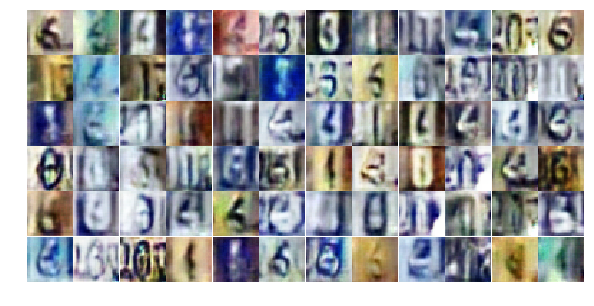

Epoch 9/25... Discriminator Loss: 1.1493... Generator Loss: 0.7848
Epoch 9/25... Discriminator Loss: 0.5993... Generator Loss: 1.1980
Epoch 9/25... Discriminator Loss: 0.9459... Generator Loss: 1.0254
Epoch 9/25... Discriminator Loss: 1.1038... Generator Loss: 0.9498
Epoch 9/25... Discriminator Loss: 1.3265... Generator Loss: 0.8934
Epoch 9/25... Discriminator Loss: 1.0413... Generator Loss: 0.8248
Epoch 9/25... Discriminator Loss: 0.9925... Generator Loss: 0.7635
Epoch 9/25... Discriminator Loss: 1.1101... Generator Loss: 0.8470
Epoch 9/25... Discriminator Loss: 1.1997... Generator Loss: 0.7627
Epoch 9/25... Discriminator Loss: 1.2111... Generator Loss: 0.7014


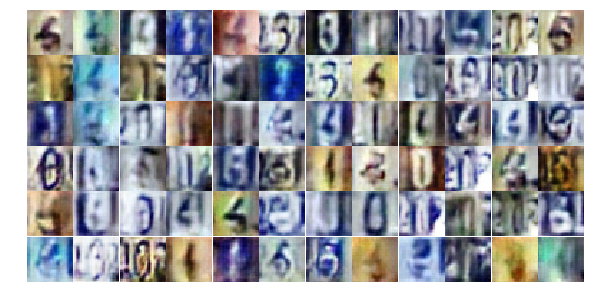

Epoch 9/25... Discriminator Loss: 1.1960... Generator Loss: 0.7713
Epoch 9/25... Discriminator Loss: 1.3467... Generator Loss: 1.0866
Epoch 9/25... Discriminator Loss: 0.9693... Generator Loss: 1.1275
Epoch 9/25... Discriminator Loss: 1.0239... Generator Loss: 1.0380
Epoch 9/25... Discriminator Loss: 1.0739... Generator Loss: 0.9471
Epoch 10/25... Discriminator Loss: 0.6517... Generator Loss: 1.9707
Epoch 10/25... Discriminator Loss: 0.7924... Generator Loss: 1.3900
Epoch 10/25... Discriminator Loss: 0.9974... Generator Loss: 0.9421
Epoch 10/25... Discriminator Loss: 0.9207... Generator Loss: 1.1013
Epoch 10/25... Discriminator Loss: 1.2493... Generator Loss: 0.5961


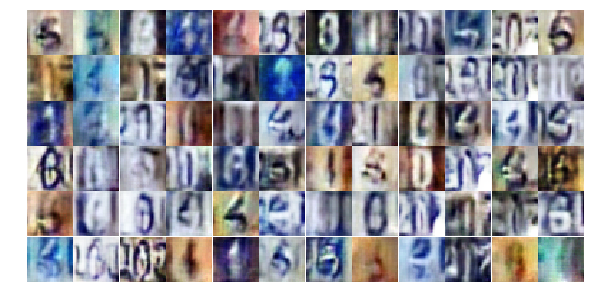

Epoch 10/25... Discriminator Loss: 1.0553... Generator Loss: 1.1054
Epoch 10/25... Discriminator Loss: 1.1318... Generator Loss: 0.8581
Epoch 10/25... Discriminator Loss: 1.1229... Generator Loss: 0.6265
Epoch 10/25... Discriminator Loss: 0.9200... Generator Loss: 1.1971
Epoch 10/25... Discriminator Loss: 1.0709... Generator Loss: 1.0124
Epoch 10/25... Discriminator Loss: 1.2111... Generator Loss: 1.0722
Epoch 10/25... Discriminator Loss: 1.0825... Generator Loss: 0.9169
Epoch 10/25... Discriminator Loss: 1.0946... Generator Loss: 0.8146
Epoch 10/25... Discriminator Loss: 1.0982... Generator Loss: 0.7567
Epoch 10/25... Discriminator Loss: 1.1776... Generator Loss: 0.7369


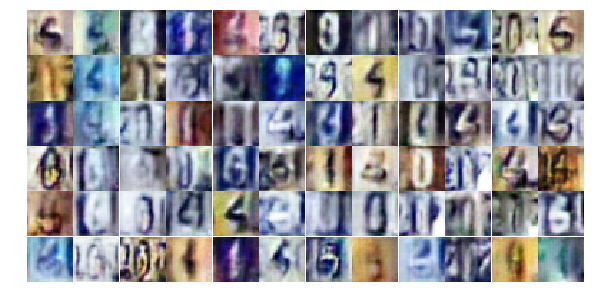

Epoch 10/25... Discriminator Loss: 0.9405... Generator Loss: 1.1525
Epoch 10/25... Discriminator Loss: 0.7943... Generator Loss: 1.4796
Epoch 10/25... Discriminator Loss: 1.1357... Generator Loss: 0.8507
Epoch 10/25... Discriminator Loss: 1.1274... Generator Loss: 0.8100
Epoch 10/25... Discriminator Loss: 1.1709... Generator Loss: 0.7963
Epoch 10/25... Discriminator Loss: 1.0891... Generator Loss: 1.2730
Epoch 10/25... Discriminator Loss: 1.1802... Generator Loss: 0.6786
Epoch 10/25... Discriminator Loss: 1.1982... Generator Loss: 0.9300
Epoch 10/25... Discriminator Loss: 1.1762... Generator Loss: 0.6615
Epoch 10/25... Discriminator Loss: 0.9561... Generator Loss: 1.1811


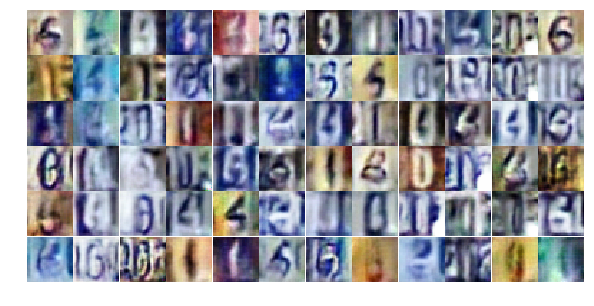

Epoch 10/25... Discriminator Loss: 1.0878... Generator Loss: 0.8339
Epoch 10/25... Discriminator Loss: 1.2521... Generator Loss: 0.7342
Epoch 10/25... Discriminator Loss: 1.1524... Generator Loss: 1.2645
Epoch 10/25... Discriminator Loss: 0.3209... Generator Loss: 2.9708
Epoch 10/25... Discriminator Loss: 0.2195... Generator Loss: 3.0468
Epoch 10/25... Discriminator Loss: 1.1973... Generator Loss: 0.9272
Epoch 10/25... Discriminator Loss: 1.0624... Generator Loss: 0.9619
Epoch 10/25... Discriminator Loss: 1.0251... Generator Loss: 1.1671
Epoch 10/25... Discriminator Loss: 1.1939... Generator Loss: 0.7801
Epoch 10/25... Discriminator Loss: 0.9817... Generator Loss: 1.0418


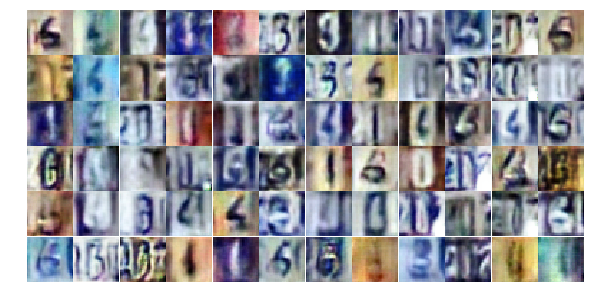

Epoch 10/25... Discriminator Loss: 1.1380... Generator Loss: 0.7067
Epoch 10/25... Discriminator Loss: 1.1646... Generator Loss: 1.3481
Epoch 10/25... Discriminator Loss: 1.3474... Generator Loss: 0.9459
Epoch 10/25... Discriminator Loss: 0.8734... Generator Loss: 1.3327
Epoch 10/25... Discriminator Loss: 1.0770... Generator Loss: 0.8946
Epoch 10/25... Discriminator Loss: 0.8822... Generator Loss: 1.0514
Epoch 10/25... Discriminator Loss: 1.1062... Generator Loss: 1.0446
Epoch 10/25... Discriminator Loss: 1.0722... Generator Loss: 0.8341
Epoch 10/25... Discriminator Loss: 0.9875... Generator Loss: 1.1095
Epoch 10/25... Discriminator Loss: 0.5923... Generator Loss: 1.4709


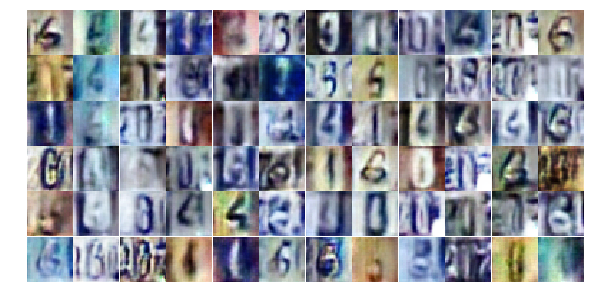

Epoch 10/25... Discriminator Loss: 1.0747... Generator Loss: 0.9976
Epoch 10/25... Discriminator Loss: 1.1430... Generator Loss: 0.8046
Epoch 10/25... Discriminator Loss: 1.3322... Generator Loss: 0.6878
Epoch 10/25... Discriminator Loss: 1.0137... Generator Loss: 1.3610
Epoch 10/25... Discriminator Loss: 1.2095... Generator Loss: 0.6374
Epoch 10/25... Discriminator Loss: 0.9719... Generator Loss: 1.4149
Epoch 10/25... Discriminator Loss: 1.1645... Generator Loss: 1.0685
Epoch 10/25... Discriminator Loss: 1.0968... Generator Loss: 1.1114
Epoch 10/25... Discriminator Loss: 1.1563... Generator Loss: 0.7153
Epoch 10/25... Discriminator Loss: 1.2095... Generator Loss: 0.7594


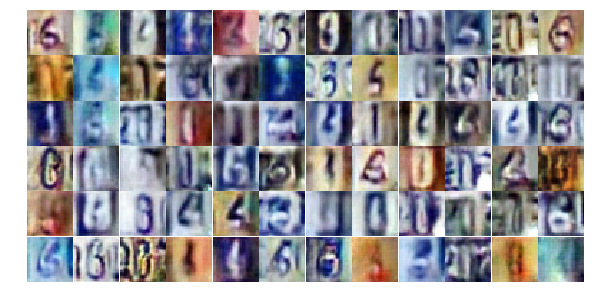

Epoch 10/25... Discriminator Loss: 1.1051... Generator Loss: 1.1620
Epoch 10/25... Discriminator Loss: 1.0081... Generator Loss: 0.9603
Epoch 10/25... Discriminator Loss: 0.9089... Generator Loss: 1.2047
Epoch 11/25... Discriminator Loss: 1.0825... Generator Loss: 1.2655
Epoch 11/25... Discriminator Loss: 1.1473... Generator Loss: 0.7754
Epoch 11/25... Discriminator Loss: 1.1461... Generator Loss: 0.6833
Epoch 11/25... Discriminator Loss: 0.9610... Generator Loss: 1.0690
Epoch 11/25... Discriminator Loss: 1.2401... Generator Loss: 0.7992
Epoch 11/25... Discriminator Loss: 1.2594... Generator Loss: 1.1819
Epoch 11/25... Discriminator Loss: 1.2007... Generator Loss: 0.8973


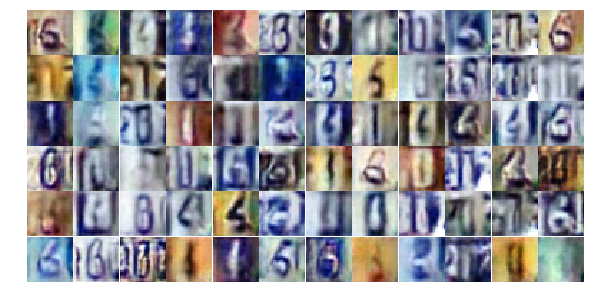

Epoch 11/25... Discriminator Loss: 1.1547... Generator Loss: 0.9005
Epoch 11/25... Discriminator Loss: 1.2338... Generator Loss: 0.7291
Epoch 11/25... Discriminator Loss: 0.9928... Generator Loss: 1.0121
Epoch 11/25... Discriminator Loss: 0.9641... Generator Loss: 0.9707
Epoch 11/25... Discriminator Loss: 1.0666... Generator Loss: 0.9441
Epoch 11/25... Discriminator Loss: 1.1655... Generator Loss: 0.7656
Epoch 11/25... Discriminator Loss: 1.0545... Generator Loss: 0.9690
Epoch 11/25... Discriminator Loss: 1.1061... Generator Loss: 1.1307
Epoch 11/25... Discriminator Loss: 1.1271... Generator Loss: 0.8301
Epoch 11/25... Discriminator Loss: 1.1340... Generator Loss: 0.8873


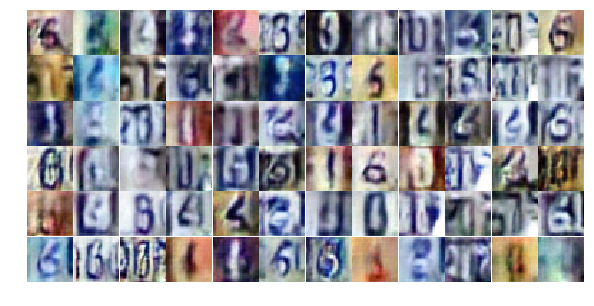

Epoch 11/25... Discriminator Loss: 1.2991... Generator Loss: 0.6463
Epoch 11/25... Discriminator Loss: 0.8908... Generator Loss: 1.5601
Epoch 11/25... Discriminator Loss: 1.2522... Generator Loss: 0.7564
Epoch 11/25... Discriminator Loss: 1.1584... Generator Loss: 0.8638
Epoch 11/25... Discriminator Loss: 1.0251... Generator Loss: 1.0971
Epoch 11/25... Discriminator Loss: 0.9389... Generator Loss: 1.0377
Epoch 11/25... Discriminator Loss: 1.2479... Generator Loss: 0.7463
Epoch 11/25... Discriminator Loss: 1.2766... Generator Loss: 0.8500
Epoch 11/25... Discriminator Loss: 1.0724... Generator Loss: 1.1739
Epoch 11/25... Discriminator Loss: 1.1413... Generator Loss: 0.7878


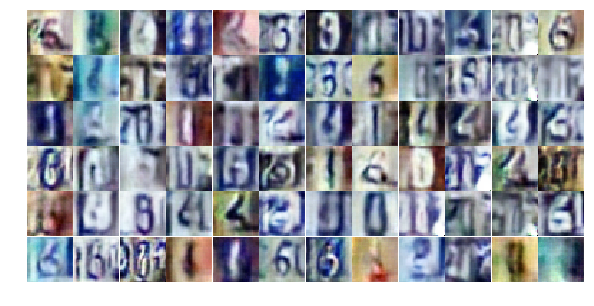

Epoch 11/25... Discriminator Loss: 1.2382... Generator Loss: 0.7670
Epoch 11/25... Discriminator Loss: 1.3928... Generator Loss: 1.4176
Epoch 11/25... Discriminator Loss: 1.3642... Generator Loss: 0.5141
Epoch 11/25... Discriminator Loss: 1.2717... Generator Loss: 0.9590
Epoch 11/25... Discriminator Loss: 1.2349... Generator Loss: 0.8106
Epoch 11/25... Discriminator Loss: 1.1307... Generator Loss: 1.0433
Epoch 11/25... Discriminator Loss: 1.1428... Generator Loss: 0.6775
Epoch 11/25... Discriminator Loss: 1.0972... Generator Loss: 0.8583
Epoch 11/25... Discriminator Loss: 0.9810... Generator Loss: 0.9622
Epoch 11/25... Discriminator Loss: 1.2370... Generator Loss: 0.5090


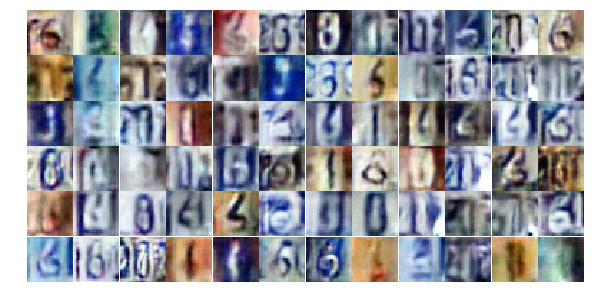

Epoch 11/25... Discriminator Loss: 1.1726... Generator Loss: 1.0256
Epoch 11/25... Discriminator Loss: 1.0592... Generator Loss: 0.8683
Epoch 11/25... Discriminator Loss: 1.0965... Generator Loss: 0.9282
Epoch 11/25... Discriminator Loss: 1.1166... Generator Loss: 1.0055
Epoch 11/25... Discriminator Loss: 1.2014... Generator Loss: 0.6594
Epoch 11/25... Discriminator Loss: 1.3834... Generator Loss: 0.8893
Epoch 11/25... Discriminator Loss: 1.2572... Generator Loss: 0.8816
Epoch 11/25... Discriminator Loss: 1.1995... Generator Loss: 0.7343
Epoch 11/25... Discriminator Loss: 1.5461... Generator Loss: 0.5315
Epoch 11/25... Discriminator Loss: 1.3226... Generator Loss: 0.8260


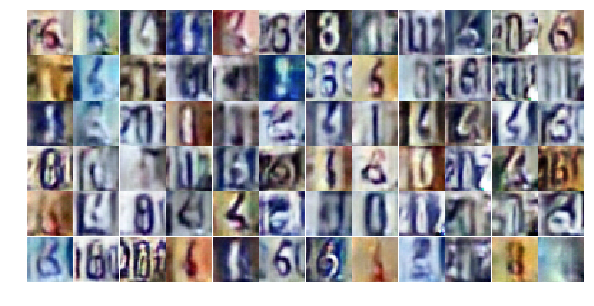

Epoch 11/25... Discriminator Loss: 1.2240... Generator Loss: 1.0105
Epoch 11/25... Discriminator Loss: 1.1645... Generator Loss: 0.8081
Epoch 11/25... Discriminator Loss: 1.0832... Generator Loss: 0.8770
Epoch 11/25... Discriminator Loss: 1.2208... Generator Loss: 0.7737
Epoch 11/25... Discriminator Loss: 1.1189... Generator Loss: 0.7448
Epoch 11/25... Discriminator Loss: 1.2495... Generator Loss: 0.8852
Epoch 11/25... Discriminator Loss: 1.0981... Generator Loss: 0.7792
Epoch 11/25... Discriminator Loss: 0.9701... Generator Loss: 1.3113
Epoch 11/25... Discriminator Loss: 1.3041... Generator Loss: 0.5665
Epoch 11/25... Discriminator Loss: 1.3623... Generator Loss: 0.6960


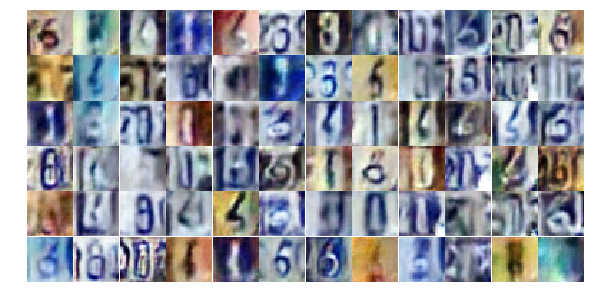

Epoch 12/25... Discriminator Loss: 1.2027... Generator Loss: 0.6796
Epoch 12/25... Discriminator Loss: 0.8795... Generator Loss: 1.3009
Epoch 12/25... Discriminator Loss: 1.1163... Generator Loss: 0.7861
Epoch 12/25... Discriminator Loss: 0.5026... Generator Loss: 2.4864
Epoch 12/25... Discriminator Loss: 1.2344... Generator Loss: 0.5083
Epoch 12/25... Discriminator Loss: 0.9646... Generator Loss: 0.8457
Epoch 12/25... Discriminator Loss: 1.1514... Generator Loss: 0.9302
Epoch 12/25... Discriminator Loss: 1.3172... Generator Loss: 0.5419
Epoch 12/25... Discriminator Loss: 1.1827... Generator Loss: 0.8240
Epoch 12/25... Discriminator Loss: 1.1127... Generator Loss: 0.9875


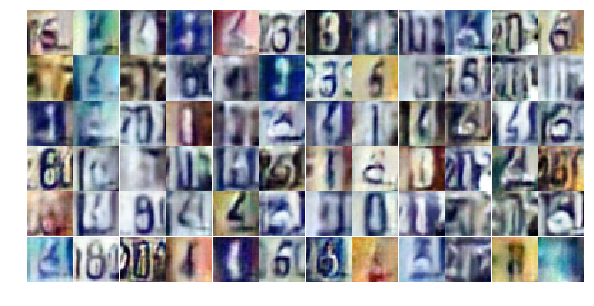

Epoch 12/25... Discriminator Loss: 0.9653... Generator Loss: 1.0367
Epoch 12/25... Discriminator Loss: 1.0819... Generator Loss: 0.7070
Epoch 12/25... Discriminator Loss: 1.0339... Generator Loss: 0.7598
Epoch 12/25... Discriminator Loss: 1.3795... Generator Loss: 1.2301
Epoch 12/25... Discriminator Loss: 1.1069... Generator Loss: 1.0882
Epoch 12/25... Discriminator Loss: 1.1952... Generator Loss: 0.6419
Epoch 12/25... Discriminator Loss: 1.3033... Generator Loss: 0.8544
Epoch 12/25... Discriminator Loss: 1.0103... Generator Loss: 1.3408
Epoch 12/25... Discriminator Loss: 1.0797... Generator Loss: 0.8726
Epoch 12/25... Discriminator Loss: 1.1889... Generator Loss: 0.7286


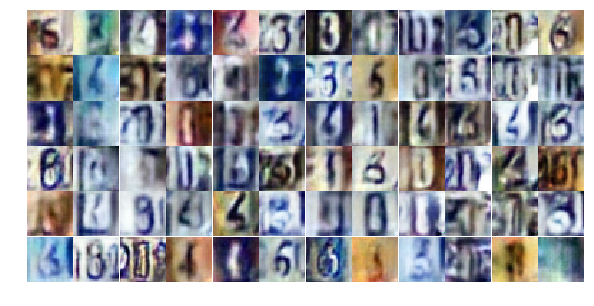

Epoch 12/25... Discriminator Loss: 1.1598... Generator Loss: 0.8851
Epoch 12/25... Discriminator Loss: 1.1118... Generator Loss: 1.2470
Epoch 12/25... Discriminator Loss: 1.1000... Generator Loss: 1.0912
Epoch 12/25... Discriminator Loss: 1.2761... Generator Loss: 0.7817
Epoch 12/25... Discriminator Loss: 1.2360... Generator Loss: 0.7787
Epoch 12/25... Discriminator Loss: 0.9476... Generator Loss: 1.1893
Epoch 12/25... Discriminator Loss: 0.8751... Generator Loss: 1.0501
Epoch 12/25... Discriminator Loss: 1.0415... Generator Loss: 1.2370
Epoch 12/25... Discriminator Loss: 0.9808... Generator Loss: 1.1482
Epoch 12/25... Discriminator Loss: 0.8561... Generator Loss: 1.0920


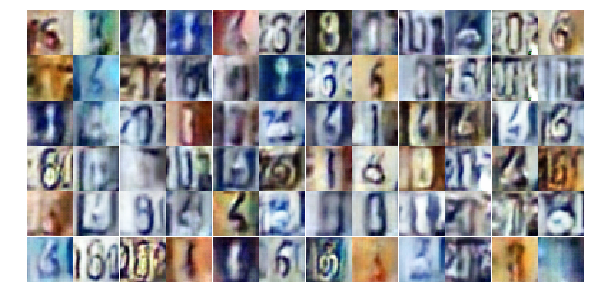

Epoch 12/25... Discriminator Loss: 1.0908... Generator Loss: 1.0700
Epoch 12/25... Discriminator Loss: 1.2304... Generator Loss: 0.6176
Epoch 12/25... Discriminator Loss: 1.1038... Generator Loss: 0.8907
Epoch 12/25... Discriminator Loss: 1.2584... Generator Loss: 0.6086
Epoch 12/25... Discriminator Loss: 1.0319... Generator Loss: 1.1608
Epoch 12/25... Discriminator Loss: 0.9116... Generator Loss: 1.0045
Epoch 12/25... Discriminator Loss: 1.1357... Generator Loss: 0.7481
Epoch 12/25... Discriminator Loss: 1.1042... Generator Loss: 1.0412
Epoch 12/25... Discriminator Loss: 1.1030... Generator Loss: 1.2684
Epoch 12/25... Discriminator Loss: 1.1570... Generator Loss: 1.0744


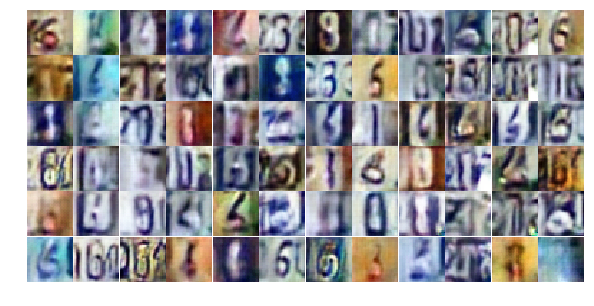

Epoch 12/25... Discriminator Loss: 1.0846... Generator Loss: 0.9113
Epoch 12/25... Discriminator Loss: 1.1282... Generator Loss: 0.8498
Epoch 12/25... Discriminator Loss: 1.1476... Generator Loss: 1.0274
Epoch 12/25... Discriminator Loss: 1.2200... Generator Loss: 1.3783
Epoch 12/25... Discriminator Loss: 1.0965... Generator Loss: 1.0992
Epoch 12/25... Discriminator Loss: 1.0220... Generator Loss: 1.0158
Epoch 12/25... Discriminator Loss: 1.0913... Generator Loss: 0.8098
Epoch 12/25... Discriminator Loss: 1.2070... Generator Loss: 0.8051
Epoch 12/25... Discriminator Loss: 1.2747... Generator Loss: 0.5226
Epoch 12/25... Discriminator Loss: 1.7319... Generator Loss: 1.2173


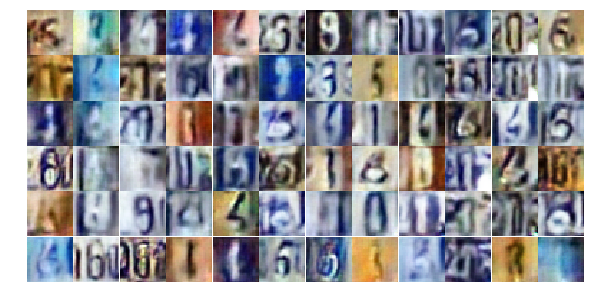

Epoch 12/25... Discriminator Loss: 1.1816... Generator Loss: 0.7126
Epoch 12/25... Discriminator Loss: 1.1809... Generator Loss: 0.8833
Epoch 12/25... Discriminator Loss: 1.1650... Generator Loss: 1.1486
Epoch 12/25... Discriminator Loss: 1.2367... Generator Loss: 1.0422
Epoch 12/25... Discriminator Loss: 1.1452... Generator Loss: 0.8722
Epoch 12/25... Discriminator Loss: 1.1374... Generator Loss: 0.7825
Epoch 12/25... Discriminator Loss: 1.2646... Generator Loss: 0.6901
Epoch 13/25... Discriminator Loss: 0.9274... Generator Loss: 1.0832
Epoch 13/25... Discriminator Loss: 1.3908... Generator Loss: 0.7468
Epoch 13/25... Discriminator Loss: 1.2114... Generator Loss: 0.9554


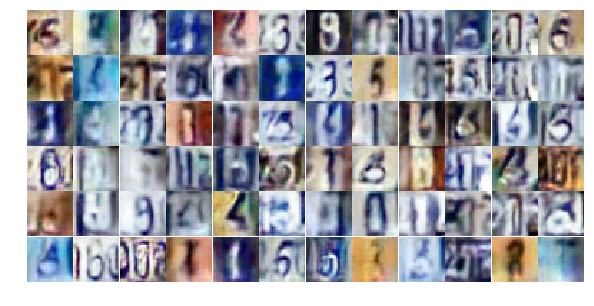

Epoch 13/25... Discriminator Loss: 1.4948... Generator Loss: 0.6183
Epoch 13/25... Discriminator Loss: 1.4699... Generator Loss: 1.1989
Epoch 13/25... Discriminator Loss: 1.2082... Generator Loss: 0.8740
Epoch 13/25... Discriminator Loss: 1.4904... Generator Loss: 0.5103
Epoch 13/25... Discriminator Loss: 1.1257... Generator Loss: 0.7816
Epoch 13/25... Discriminator Loss: 1.1442... Generator Loss: 0.7437
Epoch 13/25... Discriminator Loss: 1.1184... Generator Loss: 0.8692
Epoch 13/25... Discriminator Loss: 1.2434... Generator Loss: 0.6078
Epoch 13/25... Discriminator Loss: 1.2194... Generator Loss: 0.8743
Epoch 13/25... Discriminator Loss: 1.2372... Generator Loss: 0.6448


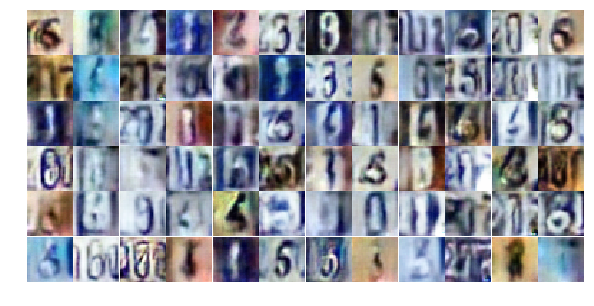

Epoch 13/25... Discriminator Loss: 0.8419... Generator Loss: 1.3518
Epoch 13/25... Discriminator Loss: 1.0088... Generator Loss: 0.9752
Epoch 13/25... Discriminator Loss: 1.1858... Generator Loss: 0.6036
Epoch 13/25... Discriminator Loss: 1.1756... Generator Loss: 0.7642
Epoch 13/25... Discriminator Loss: 1.0378... Generator Loss: 0.8320
Epoch 13/25... Discriminator Loss: 1.2231... Generator Loss: 0.7843
Epoch 13/25... Discriminator Loss: 1.1225... Generator Loss: 0.7895
Epoch 13/25... Discriminator Loss: 1.2712... Generator Loss: 0.5657
Epoch 13/25... Discriminator Loss: 1.0531... Generator Loss: 1.0999
Epoch 13/25... Discriminator Loss: 1.0280... Generator Loss: 0.9150


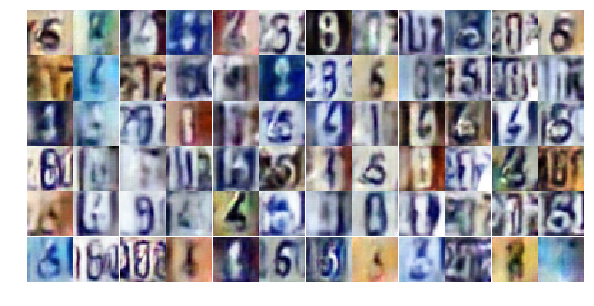

Epoch 13/25... Discriminator Loss: 0.8795... Generator Loss: 1.2649
Epoch 13/25... Discriminator Loss: 0.8624... Generator Loss: 1.2354
Epoch 13/25... Discriminator Loss: 1.0648... Generator Loss: 0.9057
Epoch 13/25... Discriminator Loss: 1.2290... Generator Loss: 1.0290
Epoch 13/25... Discriminator Loss: 1.0074... Generator Loss: 1.0244
Epoch 13/25... Discriminator Loss: 1.4735... Generator Loss: 0.7993
Epoch 13/25... Discriminator Loss: 1.2893... Generator Loss: 0.6513
Epoch 13/25... Discriminator Loss: 0.6219... Generator Loss: 2.1950
Epoch 13/25... Discriminator Loss: 0.4927... Generator Loss: 1.9076
Epoch 13/25... Discriminator Loss: 1.1133... Generator Loss: 0.9966


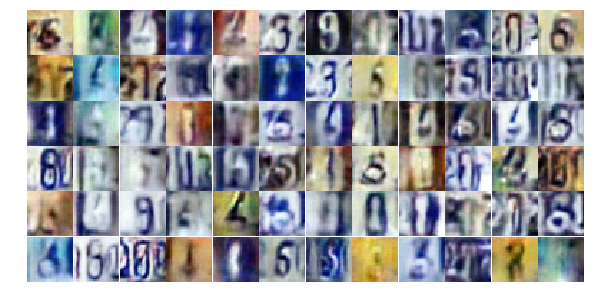

Epoch 13/25... Discriminator Loss: 1.1176... Generator Loss: 0.8205
Epoch 13/25... Discriminator Loss: 1.2467... Generator Loss: 0.7039
Epoch 13/25... Discriminator Loss: 1.1584... Generator Loss: 0.7874
Epoch 13/25... Discriminator Loss: 1.1144... Generator Loss: 0.6991
Epoch 13/25... Discriminator Loss: 1.1265... Generator Loss: 0.8999
Epoch 13/25... Discriminator Loss: 1.1494... Generator Loss: 1.1351
Epoch 13/25... Discriminator Loss: 1.1830... Generator Loss: 0.8574
Epoch 13/25... Discriminator Loss: 1.0929... Generator Loss: 1.0719
Epoch 13/25... Discriminator Loss: 1.2738... Generator Loss: 0.6984
Epoch 13/25... Discriminator Loss: 1.2927... Generator Loss: 0.7986


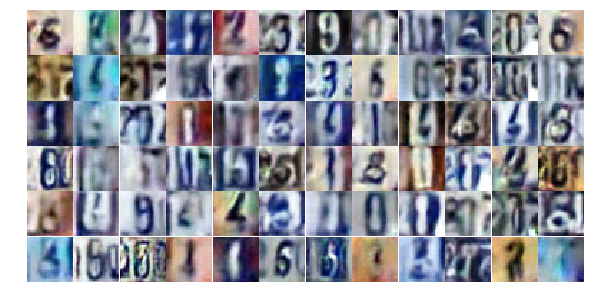

Epoch 13/25... Discriminator Loss: 0.9040... Generator Loss: 1.2156
Epoch 13/25... Discriminator Loss: 1.1239... Generator Loss: 0.8110
Epoch 13/25... Discriminator Loss: 1.2610... Generator Loss: 1.9568
Epoch 13/25... Discriminator Loss: 1.1641... Generator Loss: 0.8484
Epoch 13/25... Discriminator Loss: 1.2178... Generator Loss: 0.9518
Epoch 13/25... Discriminator Loss: 1.1188... Generator Loss: 0.7991
Epoch 13/25... Discriminator Loss: 1.2743... Generator Loss: 0.9088
Epoch 13/25... Discriminator Loss: 0.9802... Generator Loss: 1.0239
Epoch 13/25... Discriminator Loss: 0.9743... Generator Loss: 0.9231
Epoch 13/25... Discriminator Loss: 1.4318... Generator Loss: 1.2243


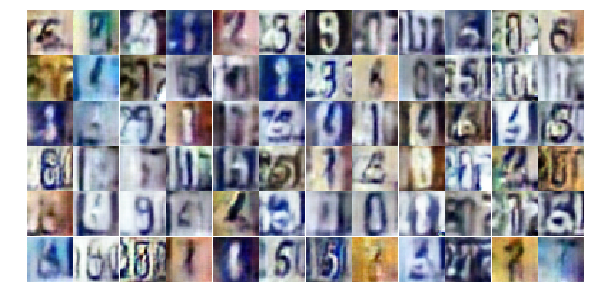

Epoch 13/25... Discriminator Loss: 0.9110... Generator Loss: 1.0840
Epoch 13/25... Discriminator Loss: 1.2964... Generator Loss: 0.8884
Epoch 13/25... Discriminator Loss: 0.4601... Generator Loss: 2.3040
Epoch 13/25... Discriminator Loss: 1.0735... Generator Loss: 0.7351
Epoch 14/25... Discriminator Loss: 0.5229... Generator Loss: 1.4575
Epoch 14/25... Discriminator Loss: 0.9486... Generator Loss: 1.1262
Epoch 14/25... Discriminator Loss: 1.1906... Generator Loss: 0.9289
Epoch 14/25... Discriminator Loss: 1.0721... Generator Loss: 1.2403
Epoch 14/25... Discriminator Loss: 1.1121... Generator Loss: 0.7781
Epoch 14/25... Discriminator Loss: 1.2685... Generator Loss: 1.1311


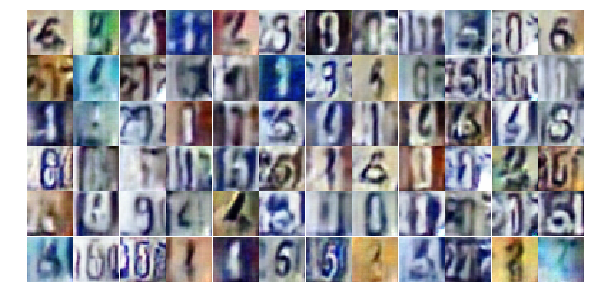

Epoch 14/25... Discriminator Loss: 1.1572... Generator Loss: 0.8960
Epoch 14/25... Discriminator Loss: 1.1210... Generator Loss: 0.9233
Epoch 14/25... Discriminator Loss: 1.2257... Generator Loss: 1.0257
Epoch 14/25... Discriminator Loss: 1.0905... Generator Loss: 0.9787
Epoch 14/25... Discriminator Loss: 1.1946... Generator Loss: 0.9471
Epoch 14/25... Discriminator Loss: 0.9970... Generator Loss: 0.9994
Epoch 14/25... Discriminator Loss: 1.3238... Generator Loss: 0.5370
Epoch 14/25... Discriminator Loss: 1.0411... Generator Loss: 0.8604
Epoch 14/25... Discriminator Loss: 1.4927... Generator Loss: 0.4156
Epoch 14/25... Discriminator Loss: 1.1670... Generator Loss: 0.6864


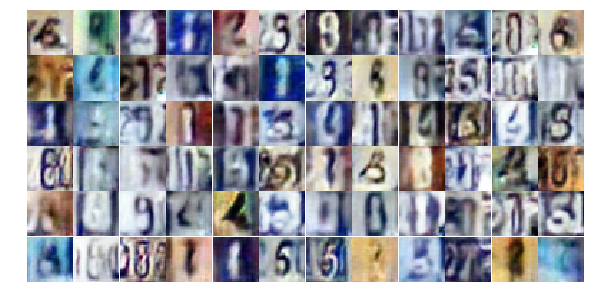

Epoch 14/25... Discriminator Loss: 1.1470... Generator Loss: 0.7707
Epoch 14/25... Discriminator Loss: 1.0451... Generator Loss: 0.8476
Epoch 14/25... Discriminator Loss: 1.1344... Generator Loss: 1.0675
Epoch 14/25... Discriminator Loss: 1.2699... Generator Loss: 0.6426
Epoch 14/25... Discriminator Loss: 1.1506... Generator Loss: 0.8376
Epoch 14/25... Discriminator Loss: 1.2276... Generator Loss: 0.6706
Epoch 14/25... Discriminator Loss: 1.2581... Generator Loss: 0.6522
Epoch 14/25... Discriminator Loss: 1.1567... Generator Loss: 0.8014
Epoch 14/25... Discriminator Loss: 1.2454... Generator Loss: 1.2336
Epoch 14/25... Discriminator Loss: 1.1857... Generator Loss: 0.9605


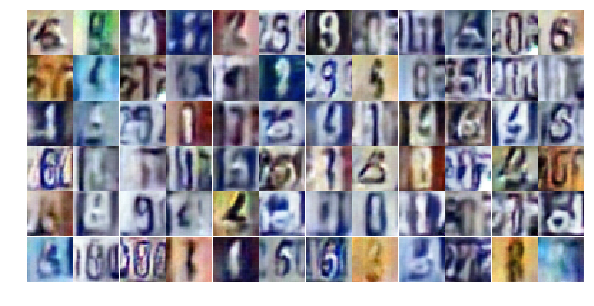

Epoch 14/25... Discriminator Loss: 1.2226... Generator Loss: 0.8459
Epoch 14/25... Discriminator Loss: 0.9677... Generator Loss: 1.6361
Epoch 14/25... Discriminator Loss: 1.2211... Generator Loss: 1.0871
Epoch 14/25... Discriminator Loss: 1.1568... Generator Loss: 0.8138
Epoch 14/25... Discriminator Loss: 1.2154... Generator Loss: 0.9828
Epoch 14/25... Discriminator Loss: 1.1031... Generator Loss: 0.9655
Epoch 14/25... Discriminator Loss: 1.2443... Generator Loss: 1.0936
Epoch 14/25... Discriminator Loss: 1.1399... Generator Loss: 1.0149
Epoch 14/25... Discriminator Loss: 1.2621... Generator Loss: 0.7190
Epoch 14/25... Discriminator Loss: 1.2750... Generator Loss: 0.6577


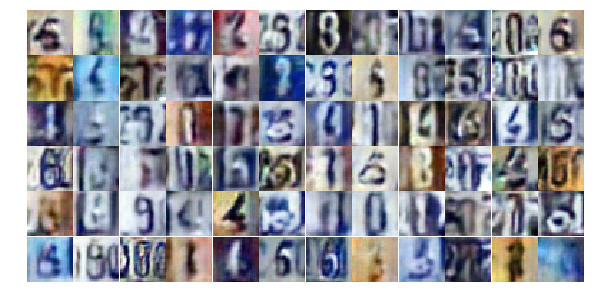

Epoch 14/25... Discriminator Loss: 1.1397... Generator Loss: 0.9849
Epoch 14/25... Discriminator Loss: 1.0866... Generator Loss: 0.5459
Epoch 14/25... Discriminator Loss: 1.0817... Generator Loss: 0.9282
Epoch 14/25... Discriminator Loss: 1.1560... Generator Loss: 1.2924
Epoch 14/25... Discriminator Loss: 1.2066... Generator Loss: 0.7698
Epoch 14/25... Discriminator Loss: 1.3147... Generator Loss: 0.5690
Epoch 14/25... Discriminator Loss: 1.1203... Generator Loss: 0.8041
Epoch 14/25... Discriminator Loss: 1.2359... Generator Loss: 0.9858
Epoch 14/25... Discriminator Loss: 1.0159... Generator Loss: 0.9004
Epoch 14/25... Discriminator Loss: 1.2149... Generator Loss: 0.7696


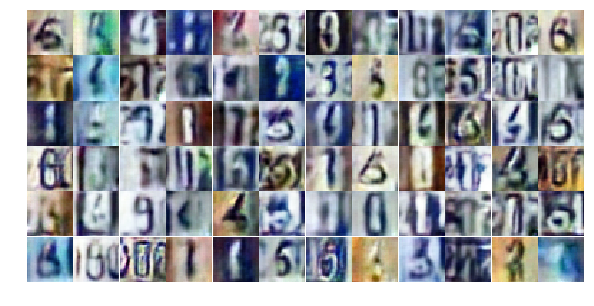

Epoch 14/25... Discriminator Loss: 1.3210... Generator Loss: 1.0102
Epoch 14/25... Discriminator Loss: 1.4305... Generator Loss: 1.0479
Epoch 14/25... Discriminator Loss: 1.1221... Generator Loss: 1.0195
Epoch 14/25... Discriminator Loss: 1.1897... Generator Loss: 0.7348
Epoch 14/25... Discriminator Loss: 1.2579... Generator Loss: 1.4737
Epoch 14/25... Discriminator Loss: 1.2411... Generator Loss: 0.7631
Epoch 14/25... Discriminator Loss: 1.3107... Generator Loss: 1.5461
Epoch 14/25... Discriminator Loss: 1.2868... Generator Loss: 1.0299
Epoch 14/25... Discriminator Loss: 0.9193... Generator Loss: 1.1128
Epoch 14/25... Discriminator Loss: 1.2168... Generator Loss: 0.7104


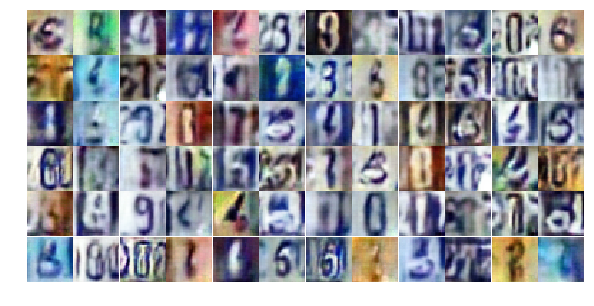

Epoch 14/25... Discriminator Loss: 1.0078... Generator Loss: 1.0054
Epoch 14/25... Discriminator Loss: 1.1055... Generator Loss: 1.0516
Epoch 15/25... Discriminator Loss: 1.2533... Generator Loss: 0.7485
Epoch 15/25... Discriminator Loss: 1.0858... Generator Loss: 1.0346
Epoch 15/25... Discriminator Loss: 0.7571... Generator Loss: 1.3471
Epoch 15/25... Discriminator Loss: 1.2491... Generator Loss: 0.9629
Epoch 15/25... Discriminator Loss: 1.0783... Generator Loss: 1.2441
Epoch 15/25... Discriminator Loss: 1.1896... Generator Loss: 0.7659
Epoch 15/25... Discriminator Loss: 1.4534... Generator Loss: 0.7750
Epoch 15/25... Discriminator Loss: 1.5299... Generator Loss: 1.0536


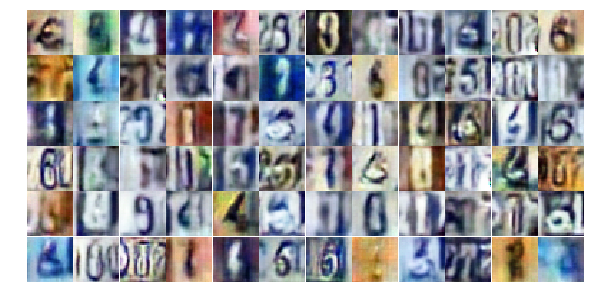

Epoch 15/25... Discriminator Loss: 1.1328... Generator Loss: 1.1968
Epoch 15/25... Discriminator Loss: 1.2476... Generator Loss: 1.0956
Epoch 15/25... Discriminator Loss: 1.2194... Generator Loss: 0.9361
Epoch 15/25... Discriminator Loss: 1.3915... Generator Loss: 0.4947
Epoch 15/25... Discriminator Loss: 1.2535... Generator Loss: 0.8665
Epoch 15/25... Discriminator Loss: 1.1252... Generator Loss: 1.0462
Epoch 15/25... Discriminator Loss: 1.4477... Generator Loss: 0.4633
Epoch 15/25... Discriminator Loss: 1.1221... Generator Loss: 0.7922
Epoch 15/25... Discriminator Loss: 0.9210... Generator Loss: 1.1715
Epoch 15/25... Discriminator Loss: 1.1303... Generator Loss: 0.8990


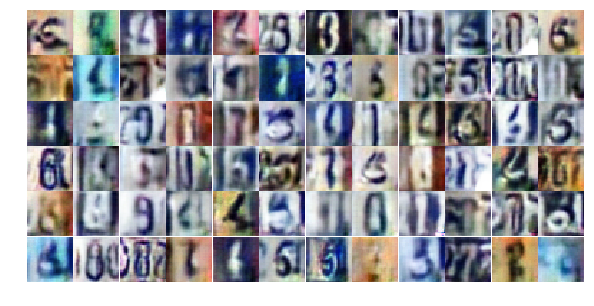

Epoch 15/25... Discriminator Loss: 1.1518... Generator Loss: 0.8830
Epoch 15/25... Discriminator Loss: 0.7878... Generator Loss: 1.0394
Epoch 15/25... Discriminator Loss: 1.1032... Generator Loss: 0.9101
Epoch 15/25... Discriminator Loss: 0.9097... Generator Loss: 1.0769
Epoch 15/25... Discriminator Loss: 1.1306... Generator Loss: 0.8390
Epoch 15/25... Discriminator Loss: 1.2982... Generator Loss: 0.9529
Epoch 15/25... Discriminator Loss: 1.1295... Generator Loss: 0.7783
Epoch 15/25... Discriminator Loss: 1.1144... Generator Loss: 0.7939
Epoch 15/25... Discriminator Loss: 1.0863... Generator Loss: 0.8256
Epoch 15/25... Discriminator Loss: 1.3842... Generator Loss: 0.6759


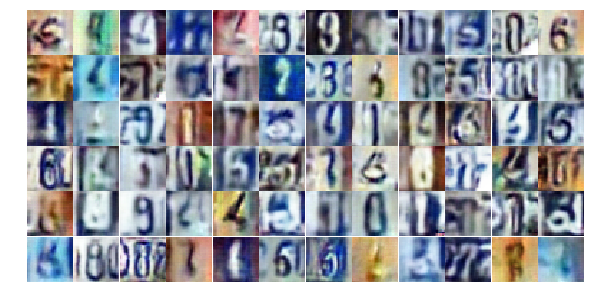

Epoch 15/25... Discriminator Loss: 1.3136... Generator Loss: 0.6118
Epoch 15/25... Discriminator Loss: 1.5117... Generator Loss: 0.4223
Epoch 15/25... Discriminator Loss: 1.1971... Generator Loss: 0.9968
Epoch 15/25... Discriminator Loss: 1.2399... Generator Loss: 0.8193
Epoch 15/25... Discriminator Loss: 1.2061... Generator Loss: 0.9280
Epoch 15/25... Discriminator Loss: 0.6412... Generator Loss: 2.0724
Epoch 15/25... Discriminator Loss: 1.1517... Generator Loss: 0.9556
Epoch 15/25... Discriminator Loss: 1.3038... Generator Loss: 0.6233
Epoch 15/25... Discriminator Loss: 0.7677... Generator Loss: 1.3244
Epoch 15/25... Discriminator Loss: 1.1771... Generator Loss: 0.8155


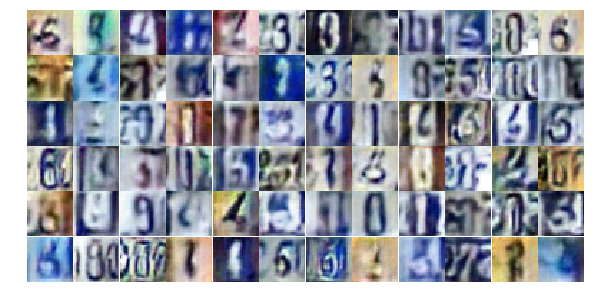

Epoch 15/25... Discriminator Loss: 1.0902... Generator Loss: 0.9194
Epoch 15/25... Discriminator Loss: 1.2553... Generator Loss: 0.7290
Epoch 15/25... Discriminator Loss: 1.5125... Generator Loss: 0.7923
Epoch 15/25... Discriminator Loss: 1.0629... Generator Loss: 1.0258
Epoch 15/25... Discriminator Loss: 0.8989... Generator Loss: 1.0676
Epoch 15/25... Discriminator Loss: 1.4007... Generator Loss: 0.4597
Epoch 15/25... Discriminator Loss: 0.9427... Generator Loss: 1.4485
Epoch 15/25... Discriminator Loss: 1.4240... Generator Loss: 0.5473
Epoch 15/25... Discriminator Loss: 1.3248... Generator Loss: 0.9804
Epoch 15/25... Discriminator Loss: 1.2188... Generator Loss: 1.0267


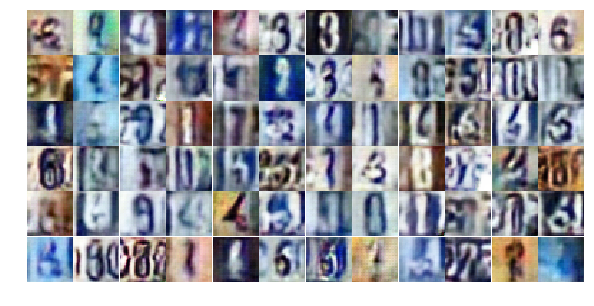

Epoch 15/25... Discriminator Loss: 1.2697... Generator Loss: 0.9837
Epoch 15/25... Discriminator Loss: 0.9649... Generator Loss: 0.8499
Epoch 15/25... Discriminator Loss: 1.2777... Generator Loss: 1.0560
Epoch 15/25... Discriminator Loss: 1.0569... Generator Loss: 0.9828
Epoch 15/25... Discriminator Loss: 1.0961... Generator Loss: 1.0365
Epoch 15/25... Discriminator Loss: 1.3363... Generator Loss: 0.7725
Epoch 15/25... Discriminator Loss: 1.0461... Generator Loss: 0.7478
Epoch 15/25... Discriminator Loss: 1.2802... Generator Loss: 0.9113
Epoch 15/25... Discriminator Loss: 1.2190... Generator Loss: 0.6149
Epoch 16/25... Discriminator Loss: 1.3052... Generator Loss: 0.5994


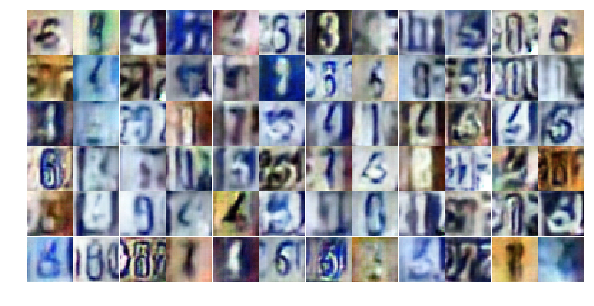

Epoch 16/25... Discriminator Loss: 0.9549... Generator Loss: 0.7883
Epoch 16/25... Discriminator Loss: 0.8311... Generator Loss: 1.6099
Epoch 16/25... Discriminator Loss: 1.1230... Generator Loss: 1.0382
Epoch 16/25... Discriminator Loss: 1.0598... Generator Loss: 1.1999
Epoch 16/25... Discriminator Loss: 0.9309... Generator Loss: 1.1444
Epoch 16/25... Discriminator Loss: 1.1483... Generator Loss: 1.0154
Epoch 16/25... Discriminator Loss: 1.1754... Generator Loss: 0.7291
Epoch 16/25... Discriminator Loss: 1.2025... Generator Loss: 0.6139
Epoch 16/25... Discriminator Loss: 1.2202... Generator Loss: 0.7693
Epoch 16/25... Discriminator Loss: 1.0658... Generator Loss: 0.9926


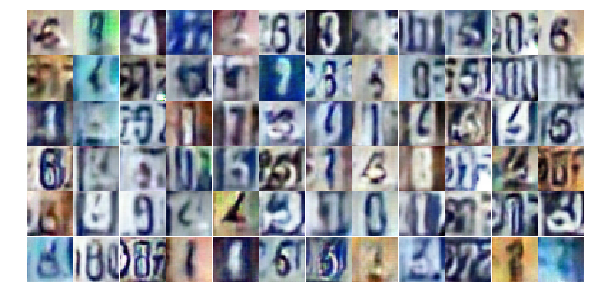

Epoch 16/25... Discriminator Loss: 1.2806... Generator Loss: 0.8261
Epoch 16/25... Discriminator Loss: 1.2208... Generator Loss: 0.8274
Epoch 16/25... Discriminator Loss: 1.4423... Generator Loss: 0.9197
Epoch 16/25... Discriminator Loss: 1.2956... Generator Loss: 0.5967
Epoch 16/25... Discriminator Loss: 1.5744... Generator Loss: 0.5012
Epoch 16/25... Discriminator Loss: 1.2212... Generator Loss: 0.7480
Epoch 16/25... Discriminator Loss: 1.0588... Generator Loss: 0.9926
Epoch 16/25... Discriminator Loss: 1.0648... Generator Loss: 1.0292
Epoch 16/25... Discriminator Loss: 0.9883... Generator Loss: 0.9949
Epoch 16/25... Discriminator Loss: 1.1934... Generator Loss: 0.7612


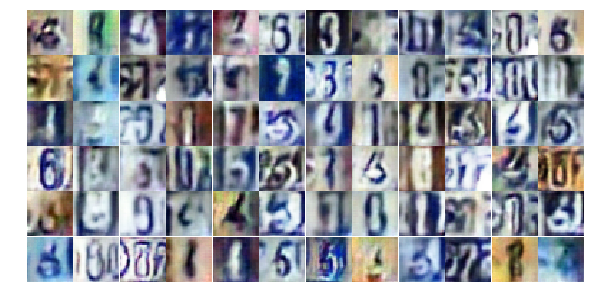

Epoch 16/25... Discriminator Loss: 1.1030... Generator Loss: 0.8761
Epoch 16/25... Discriminator Loss: 1.3699... Generator Loss: 0.4775
Epoch 16/25... Discriminator Loss: 1.2356... Generator Loss: 0.7508
Epoch 16/25... Discriminator Loss: 1.1107... Generator Loss: 0.7166
Epoch 16/25... Discriminator Loss: 1.2085... Generator Loss: 0.7978
Epoch 16/25... Discriminator Loss: 1.3494... Generator Loss: 0.7015
Epoch 16/25... Discriminator Loss: 1.2259... Generator Loss: 0.7969
Epoch 16/25... Discriminator Loss: 1.2510... Generator Loss: 0.7999
Epoch 16/25... Discriminator Loss: 1.1967... Generator Loss: 0.9093
Epoch 16/25... Discriminator Loss: 1.0933... Generator Loss: 0.7731


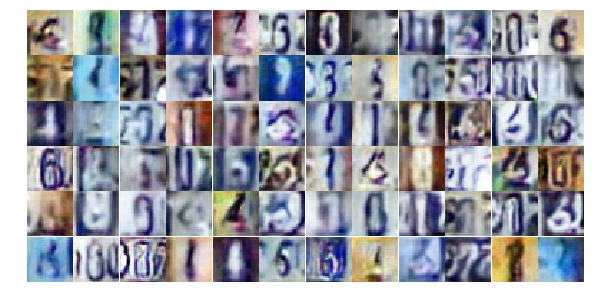

Epoch 16/25... Discriminator Loss: 1.1270... Generator Loss: 0.8360
Epoch 16/25... Discriminator Loss: 1.3035... Generator Loss: 0.7268
Epoch 16/25... Discriminator Loss: 1.1231... Generator Loss: 1.0832
Epoch 16/25... Discriminator Loss: 1.2329... Generator Loss: 0.8608
Epoch 16/25... Discriminator Loss: 1.3202... Generator Loss: 0.8048
Epoch 16/25... Discriminator Loss: 1.3620... Generator Loss: 0.9914
Epoch 16/25... Discriminator Loss: 1.1989... Generator Loss: 0.8339
Epoch 16/25... Discriminator Loss: 1.0504... Generator Loss: 1.0690
Epoch 16/25... Discriminator Loss: 0.9586... Generator Loss: 0.8989
Epoch 16/25... Discriminator Loss: 1.1424... Generator Loss: 1.0604


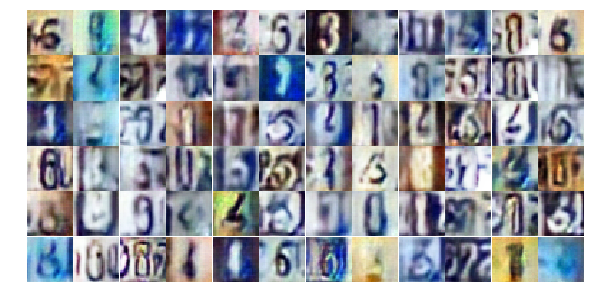

Epoch 16/25... Discriminator Loss: 1.0871... Generator Loss: 0.9550
Epoch 16/25... Discriminator Loss: 1.2819... Generator Loss: 0.7582
Epoch 16/25... Discriminator Loss: 1.1347... Generator Loss: 0.9301
Epoch 16/25... Discriminator Loss: 1.2386... Generator Loss: 0.7030
Epoch 16/25... Discriminator Loss: 1.4283... Generator Loss: 0.7404
Epoch 16/25... Discriminator Loss: 1.7238... Generator Loss: 1.0751
Epoch 16/25... Discriminator Loss: 1.0920... Generator Loss: 1.0325
Epoch 16/25... Discriminator Loss: 1.1098... Generator Loss: 0.9843
Epoch 16/25... Discriminator Loss: 1.0938... Generator Loss: 0.8742
Epoch 16/25... Discriminator Loss: 0.9713... Generator Loss: 1.0156


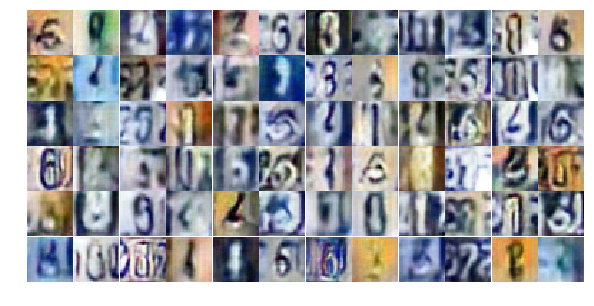

Epoch 16/25... Discriminator Loss: 1.3731... Generator Loss: 0.6786
Epoch 16/25... Discriminator Loss: 1.4322... Generator Loss: 0.9647
Epoch 16/25... Discriminator Loss: 1.1996... Generator Loss: 0.6985
Epoch 16/25... Discriminator Loss: 1.1198... Generator Loss: 0.9227
Epoch 16/25... Discriminator Loss: 1.1345... Generator Loss: 0.9660
Epoch 16/25... Discriminator Loss: 1.3743... Generator Loss: 0.8029
Epoch 17/25... Discriminator Loss: 1.2948... Generator Loss: 0.8025
Epoch 17/25... Discriminator Loss: 1.5097... Generator Loss: 0.6193
Epoch 17/25... Discriminator Loss: 0.8594... Generator Loss: 1.3690
Epoch 17/25... Discriminator Loss: 1.2436... Generator Loss: 0.8427


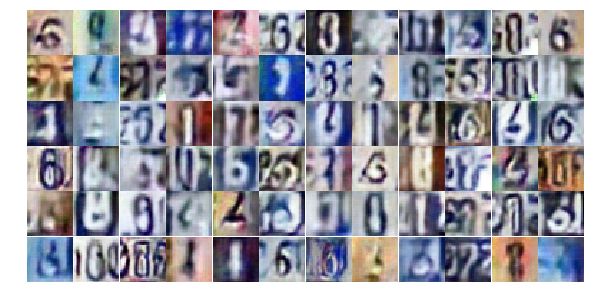

Epoch 17/25... Discriminator Loss: 1.2652... Generator Loss: 1.0738
Epoch 17/25... Discriminator Loss: 1.1807... Generator Loss: 0.7474
Epoch 17/25... Discriminator Loss: 1.2639... Generator Loss: 0.7228
Epoch 17/25... Discriminator Loss: 1.1559... Generator Loss: 0.9459
Epoch 17/25... Discriminator Loss: 1.2633... Generator Loss: 0.7994
Epoch 17/25... Discriminator Loss: 1.3585... Generator Loss: 0.7339
Epoch 17/25... Discriminator Loss: 1.3493... Generator Loss: 0.7583
Epoch 17/25... Discriminator Loss: 1.1303... Generator Loss: 0.9622
Epoch 17/25... Discriminator Loss: 1.2988... Generator Loss: 0.8069
Epoch 17/25... Discriminator Loss: 0.9703... Generator Loss: 0.8991


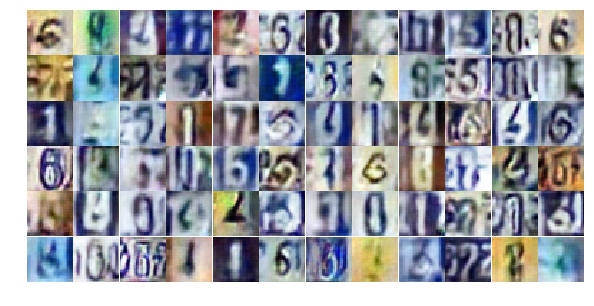

Epoch 17/25... Discriminator Loss: 1.2012... Generator Loss: 0.7840
Epoch 17/25... Discriminator Loss: 1.1255... Generator Loss: 0.8253
Epoch 17/25... Discriminator Loss: 1.2471... Generator Loss: 0.7842
Epoch 17/25... Discriminator Loss: 1.1959... Generator Loss: 0.8011
Epoch 17/25... Discriminator Loss: 1.2166... Generator Loss: 0.6897
Epoch 17/25... Discriminator Loss: 1.2247... Generator Loss: 0.6067
Epoch 17/25... Discriminator Loss: 1.4288... Generator Loss: 0.9749
Epoch 17/25... Discriminator Loss: 1.1125... Generator Loss: 0.9169
Epoch 17/25... Discriminator Loss: 1.1492... Generator Loss: 0.9029
Epoch 17/25... Discriminator Loss: 1.2482... Generator Loss: 0.6590


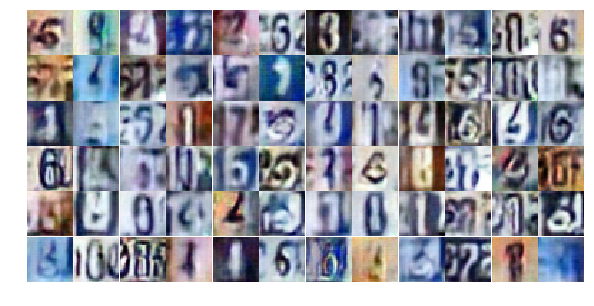

Epoch 17/25... Discriminator Loss: 1.3643... Generator Loss: 0.5612
Epoch 17/25... Discriminator Loss: 1.1119... Generator Loss: 0.7756
Epoch 17/25... Discriminator Loss: 0.9599... Generator Loss: 1.1824
Epoch 17/25... Discriminator Loss: 1.3564... Generator Loss: 0.6590
Epoch 17/25... Discriminator Loss: 1.4255... Generator Loss: 0.4586
Epoch 17/25... Discriminator Loss: 1.2456... Generator Loss: 0.6581
Epoch 17/25... Discriminator Loss: 1.2627... Generator Loss: 0.7491
Epoch 17/25... Discriminator Loss: 1.1748... Generator Loss: 0.7119
Epoch 17/25... Discriminator Loss: 1.4682... Generator Loss: 0.4390
Epoch 17/25... Discriminator Loss: 1.2975... Generator Loss: 0.7067


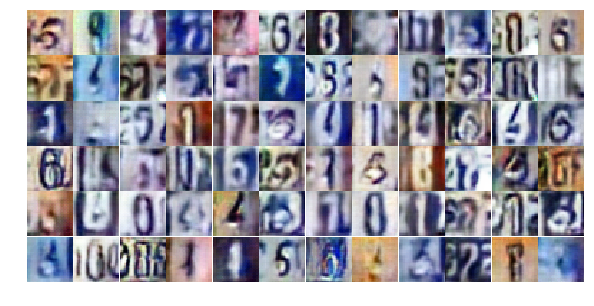

Epoch 17/25... Discriminator Loss: 1.4606... Generator Loss: 0.9268
Epoch 17/25... Discriminator Loss: 1.3386... Generator Loss: 0.7793
Epoch 17/25... Discriminator Loss: 0.9852... Generator Loss: 1.0143
Epoch 17/25... Discriminator Loss: 1.2739... Generator Loss: 0.8109
Epoch 17/25... Discriminator Loss: 1.2144... Generator Loss: 0.6099
Epoch 17/25... Discriminator Loss: 1.0627... Generator Loss: 0.8134
Epoch 17/25... Discriminator Loss: 1.3313... Generator Loss: 0.7186
Epoch 17/25... Discriminator Loss: 1.2019... Generator Loss: 0.8681
Epoch 17/25... Discriminator Loss: 1.1228... Generator Loss: 1.0762
Epoch 17/25... Discriminator Loss: 1.3064... Generator Loss: 0.7576


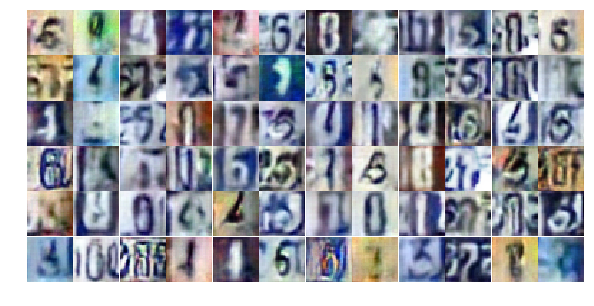

Epoch 17/25... Discriminator Loss: 1.6289... Generator Loss: 0.7420
Epoch 17/25... Discriminator Loss: 0.9677... Generator Loss: 1.2822
Epoch 17/25... Discriminator Loss: 1.7884... Generator Loss: 1.0698
Epoch 17/25... Discriminator Loss: 1.1114... Generator Loss: 0.7449
Epoch 17/25... Discriminator Loss: 1.3070... Generator Loss: 0.8045
Epoch 17/25... Discriminator Loss: 1.3348... Generator Loss: 0.8144
Epoch 17/25... Discriminator Loss: 0.9827... Generator Loss: 1.0917
Epoch 17/25... Discriminator Loss: 1.2067... Generator Loss: 0.8427
Epoch 17/25... Discriminator Loss: 1.3262... Generator Loss: 0.6626
Epoch 17/25... Discriminator Loss: 1.0737... Generator Loss: 1.0745


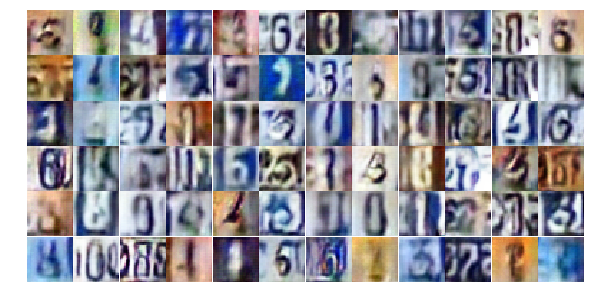

Epoch 17/25... Discriminator Loss: 1.2447... Generator Loss: 0.5905
Epoch 17/25... Discriminator Loss: 1.3763... Generator Loss: 0.5978
Epoch 17/25... Discriminator Loss: 0.8788... Generator Loss: 1.2867
Epoch 17/25... Discriminator Loss: 1.3493... Generator Loss: 0.7586
Epoch 18/25... Discriminator Loss: 1.2813... Generator Loss: 0.7804
Epoch 18/25... Discriminator Loss: 1.3247... Generator Loss: 0.9195
Epoch 18/25... Discriminator Loss: 1.2346... Generator Loss: 0.8519
Epoch 18/25... Discriminator Loss: 1.1648... Generator Loss: 0.9760
Epoch 18/25... Discriminator Loss: 1.3472... Generator Loss: 0.5873
Epoch 18/25... Discriminator Loss: 1.3519... Generator Loss: 0.6239


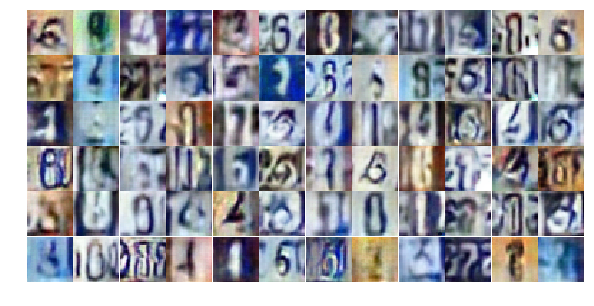

Epoch 18/25... Discriminator Loss: 1.1895... Generator Loss: 0.9506
Epoch 18/25... Discriminator Loss: 1.4050... Generator Loss: 0.8473
Epoch 18/25... Discriminator Loss: 1.2056... Generator Loss: 0.7171
Epoch 18/25... Discriminator Loss: 0.9934... Generator Loss: 1.0582
Epoch 18/25... Discriminator Loss: 0.9651... Generator Loss: 1.0991
Epoch 18/25... Discriminator Loss: 1.4538... Generator Loss: 0.7580
Epoch 18/25... Discriminator Loss: 1.1166... Generator Loss: 1.0731
Epoch 18/25... Discriminator Loss: 1.3952... Generator Loss: 0.9871
Epoch 18/25... Discriminator Loss: 0.9840... Generator Loss: 0.9125
Epoch 18/25... Discriminator Loss: 1.1380... Generator Loss: 1.0705


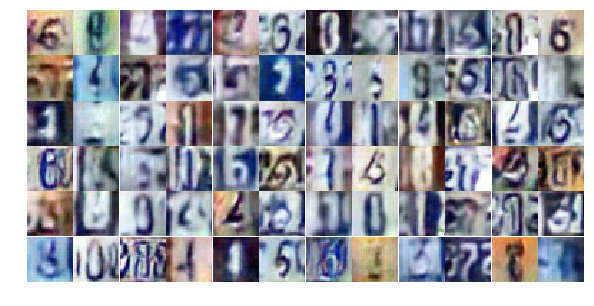

Epoch 18/25... Discriminator Loss: 1.2558... Generator Loss: 0.7800
Epoch 18/25... Discriminator Loss: 1.1453... Generator Loss: 0.8596
Epoch 18/25... Discriminator Loss: 0.9945... Generator Loss: 1.0205
Epoch 18/25... Discriminator Loss: 1.0893... Generator Loss: 0.9797
Epoch 18/25... Discriminator Loss: 1.1874... Generator Loss: 0.9937
Epoch 18/25... Discriminator Loss: 1.2677... Generator Loss: 0.9472
Epoch 18/25... Discriminator Loss: 1.1537... Generator Loss: 0.8600
Epoch 18/25... Discriminator Loss: 1.3552... Generator Loss: 0.7279
Epoch 18/25... Discriminator Loss: 1.3283... Generator Loss: 0.8610
Epoch 18/25... Discriminator Loss: 1.2539... Generator Loss: 0.7935


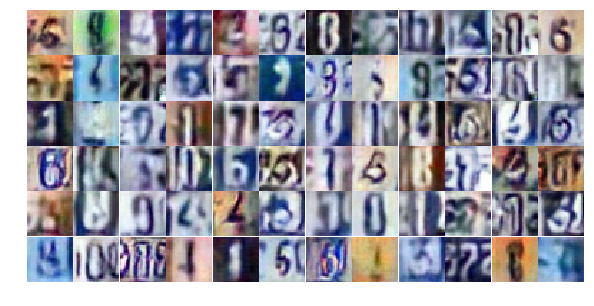

Epoch 18/25... Discriminator Loss: 0.9072... Generator Loss: 0.8119
Epoch 18/25... Discriminator Loss: 0.9477... Generator Loss: 1.1863
Epoch 18/25... Discriminator Loss: 1.3186... Generator Loss: 0.7950
Epoch 18/25... Discriminator Loss: 1.0613... Generator Loss: 1.1487
Epoch 18/25... Discriminator Loss: 1.0997... Generator Loss: 0.7610
Epoch 18/25... Discriminator Loss: 1.1827... Generator Loss: 0.7307
Epoch 18/25... Discriminator Loss: 1.2480... Generator Loss: 0.9137
Epoch 18/25... Discriminator Loss: 0.9348... Generator Loss: 1.1232
Epoch 18/25... Discriminator Loss: 1.0722... Generator Loss: 0.8330
Epoch 18/25... Discriminator Loss: 1.1768... Generator Loss: 1.0000


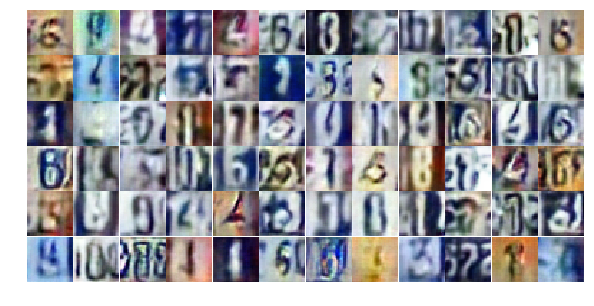

Epoch 18/25... Discriminator Loss: 1.3574... Generator Loss: 1.0874
Epoch 18/25... Discriminator Loss: 1.2152... Generator Loss: 0.8094
Epoch 18/25... Discriminator Loss: 1.3955... Generator Loss: 0.6846
Epoch 18/25... Discriminator Loss: 1.1150... Generator Loss: 0.6630
Epoch 18/25... Discriminator Loss: 0.6809... Generator Loss: 1.4653
Epoch 18/25... Discriminator Loss: 1.0451... Generator Loss: 0.8200
Epoch 18/25... Discriminator Loss: 1.2795... Generator Loss: 0.5992
Epoch 18/25... Discriminator Loss: 1.7803... Generator Loss: 1.6374
Epoch 18/25... Discriminator Loss: 1.2417... Generator Loss: 0.6054
Epoch 18/25... Discriminator Loss: 1.2325... Generator Loss: 1.0244


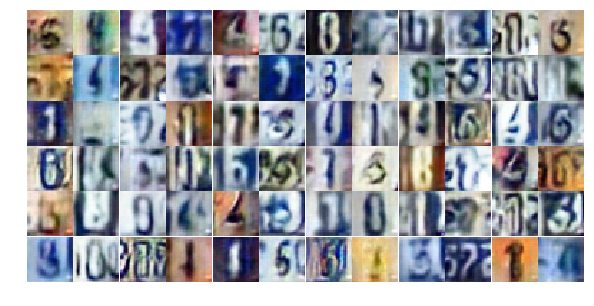

Epoch 18/25... Discriminator Loss: 1.2555... Generator Loss: 0.8357
Epoch 18/25... Discriminator Loss: 1.0748... Generator Loss: 0.9045
Epoch 18/25... Discriminator Loss: 1.1495... Generator Loss: 1.0200
Epoch 18/25... Discriminator Loss: 1.2952... Generator Loss: 0.8165
Epoch 18/25... Discriminator Loss: 1.2673... Generator Loss: 0.7813
Epoch 18/25... Discriminator Loss: 1.3799... Generator Loss: 0.8377
Epoch 18/25... Discriminator Loss: 1.2561... Generator Loss: 0.8846
Epoch 18/25... Discriminator Loss: 1.1314... Generator Loss: 0.9334
Epoch 18/25... Discriminator Loss: 1.2473... Generator Loss: 0.9071
Epoch 18/25... Discriminator Loss: 1.3188... Generator Loss: 0.7132


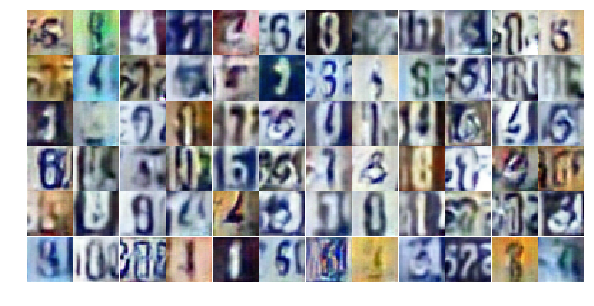

Epoch 18/25... Discriminator Loss: 1.0085... Generator Loss: 1.0749
Epoch 19/25... Discriminator Loss: 1.2993... Generator Loss: 0.6637
Epoch 19/25... Discriminator Loss: 1.4133... Generator Loss: 0.7052
Epoch 19/25... Discriminator Loss: 1.1988... Generator Loss: 0.7779
Epoch 19/25... Discriminator Loss: 1.3611... Generator Loss: 0.9249
Epoch 19/25... Discriminator Loss: 1.2595... Generator Loss: 0.7284
Epoch 19/25... Discriminator Loss: 1.1261... Generator Loss: 0.8315
Epoch 19/25... Discriminator Loss: 1.2397... Generator Loss: 0.7574
Epoch 19/25... Discriminator Loss: 1.0952... Generator Loss: 0.9140
Epoch 19/25... Discriminator Loss: 1.1894... Generator Loss: 0.8664


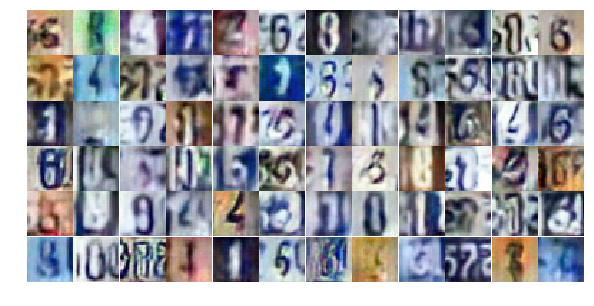

Epoch 19/25... Discriminator Loss: 1.3245... Generator Loss: 0.7767
Epoch 19/25... Discriminator Loss: 1.2639... Generator Loss: 0.7938
Epoch 19/25... Discriminator Loss: 1.2968... Generator Loss: 0.8846
Epoch 19/25... Discriminator Loss: 1.1988... Generator Loss: 0.7634
Epoch 19/25... Discriminator Loss: 1.4970... Generator Loss: 0.6755
Epoch 19/25... Discriminator Loss: 1.4289... Generator Loss: 0.4657
Epoch 19/25... Discriminator Loss: 1.1106... Generator Loss: 0.8980
Epoch 19/25... Discriminator Loss: 1.2167... Generator Loss: 0.9155
Epoch 19/25... Discriminator Loss: 1.3437... Generator Loss: 0.6012
Epoch 19/25... Discriminator Loss: 1.3118... Generator Loss: 0.6543


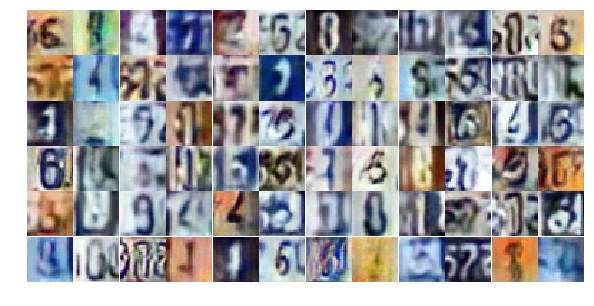

Epoch 19/25... Discriminator Loss: 1.4195... Generator Loss: 0.6135
Epoch 19/25... Discriminator Loss: 1.4036... Generator Loss: 0.6124
Epoch 19/25... Discriminator Loss: 1.3794... Generator Loss: 0.6662
Epoch 19/25... Discriminator Loss: 1.1319... Generator Loss: 0.8077
Epoch 19/25... Discriminator Loss: 1.2006... Generator Loss: 0.8180
Epoch 19/25... Discriminator Loss: 1.2989... Generator Loss: 0.7746
Epoch 19/25... Discriminator Loss: 1.0216... Generator Loss: 0.8150
Epoch 19/25... Discriminator Loss: 1.0525... Generator Loss: 1.1616
Epoch 19/25... Discriminator Loss: 1.2546... Generator Loss: 0.6607
Epoch 19/25... Discriminator Loss: 1.1185... Generator Loss: 0.7612


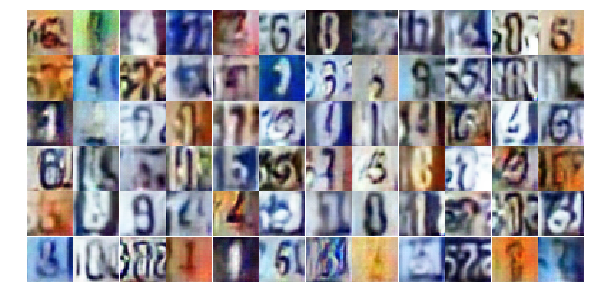

Epoch 19/25... Discriminator Loss: 1.0390... Generator Loss: 1.0089
Epoch 19/25... Discriminator Loss: 1.0492... Generator Loss: 0.8756
Epoch 19/25... Discriminator Loss: 1.1294... Generator Loss: 0.6630
Epoch 19/25... Discriminator Loss: 0.6325... Generator Loss: 1.8423
Epoch 19/25... Discriminator Loss: 0.8740... Generator Loss: 1.3464
Epoch 19/25... Discriminator Loss: 1.2471... Generator Loss: 0.8914
Epoch 19/25... Discriminator Loss: 1.1938... Generator Loss: 0.8919
Epoch 19/25... Discriminator Loss: 1.2361... Generator Loss: 0.9236
Epoch 19/25... Discriminator Loss: 1.3212... Generator Loss: 0.6467
Epoch 19/25... Discriminator Loss: 1.6303... Generator Loss: 0.9630


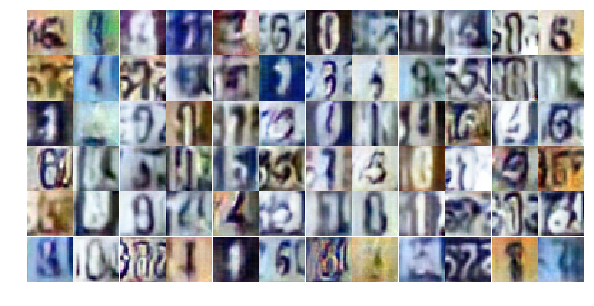

Epoch 19/25... Discriminator Loss: 1.0648... Generator Loss: 0.9223
Epoch 19/25... Discriminator Loss: 1.3187... Generator Loss: 0.5878
Epoch 19/25... Discriminator Loss: 1.3944... Generator Loss: 0.6079
Epoch 19/25... Discriminator Loss: 0.8265... Generator Loss: 1.8006
Epoch 19/25... Discriminator Loss: 0.6681... Generator Loss: 1.3591
Epoch 19/25... Discriminator Loss: 1.1382... Generator Loss: 0.7853
Epoch 19/25... Discriminator Loss: 1.6018... Generator Loss: 1.2184
Epoch 19/25... Discriminator Loss: 1.1994... Generator Loss: 0.9457
Epoch 19/25... Discriminator Loss: 1.1771... Generator Loss: 0.6729
Epoch 19/25... Discriminator Loss: 1.2857... Generator Loss: 0.7944


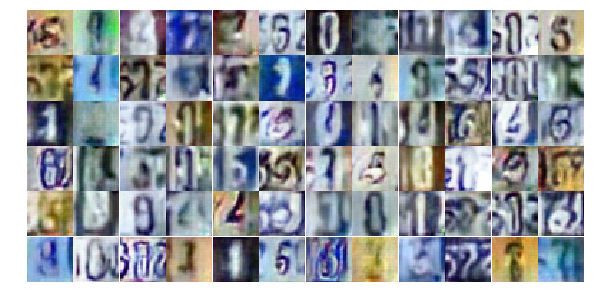

Epoch 19/25... Discriminator Loss: 1.3066... Generator Loss: 0.6816
Epoch 19/25... Discriminator Loss: 1.2821... Generator Loss: 0.6696
Epoch 19/25... Discriminator Loss: 1.2685... Generator Loss: 0.9003
Epoch 19/25... Discriminator Loss: 1.4776... Generator Loss: 0.5402
Epoch 19/25... Discriminator Loss: 1.3876... Generator Loss: 0.7532
Epoch 19/25... Discriminator Loss: 1.1832... Generator Loss: 0.9939
Epoch 19/25... Discriminator Loss: 1.2573... Generator Loss: 0.7021
Epoch 19/25... Discriminator Loss: 1.0681... Generator Loss: 1.0865
Epoch 20/25... Discriminator Loss: 1.3556... Generator Loss: 1.1029
Epoch 20/25... Discriminator Loss: 1.2457... Generator Loss: 1.0113


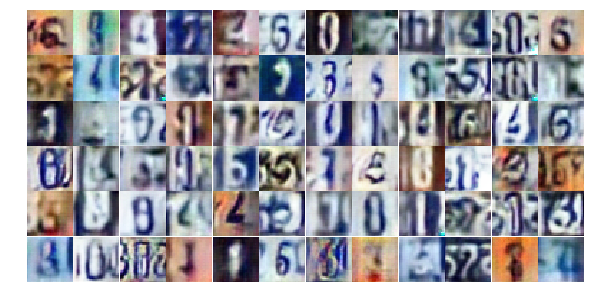

Epoch 20/25... Discriminator Loss: 1.4070... Generator Loss: 0.7630
Epoch 20/25... Discriminator Loss: 1.3019... Generator Loss: 0.7515
Epoch 20/25... Discriminator Loss: 1.3428... Generator Loss: 0.6735
Epoch 20/25... Discriminator Loss: 1.2760... Generator Loss: 0.7824
Epoch 20/25... Discriminator Loss: 1.1386... Generator Loss: 0.9139
Epoch 20/25... Discriminator Loss: 1.2312... Generator Loss: 0.8380
Epoch 20/25... Discriminator Loss: 1.3011... Generator Loss: 0.8438
Epoch 20/25... Discriminator Loss: 1.2635... Generator Loss: 0.8617
Epoch 20/25... Discriminator Loss: 1.2563... Generator Loss: 0.7433
Epoch 20/25... Discriminator Loss: 1.2246... Generator Loss: 0.7838


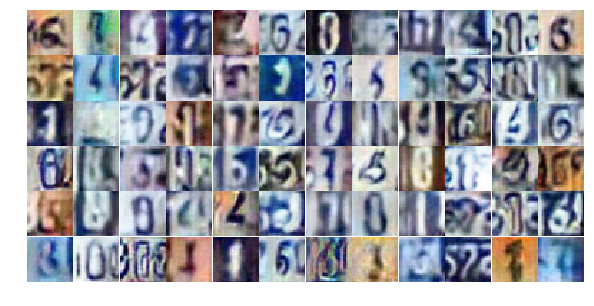

Epoch 20/25... Discriminator Loss: 1.4474... Generator Loss: 0.4921
Epoch 20/25... Discriminator Loss: 1.3115... Generator Loss: 0.6686
Epoch 20/25... Discriminator Loss: 1.2504... Generator Loss: 0.9899
Epoch 20/25... Discriminator Loss: 0.9305... Generator Loss: 1.1306
Epoch 20/25... Discriminator Loss: 0.9231... Generator Loss: 1.3679
Epoch 20/25... Discriminator Loss: 1.1868... Generator Loss: 0.7884
Epoch 20/25... Discriminator Loss: 1.3043... Generator Loss: 0.6415
Epoch 20/25... Discriminator Loss: 1.2525... Generator Loss: 1.1100
Epoch 20/25... Discriminator Loss: 1.2112... Generator Loss: 0.9249
Epoch 20/25... Discriminator Loss: 1.3173... Generator Loss: 0.6413


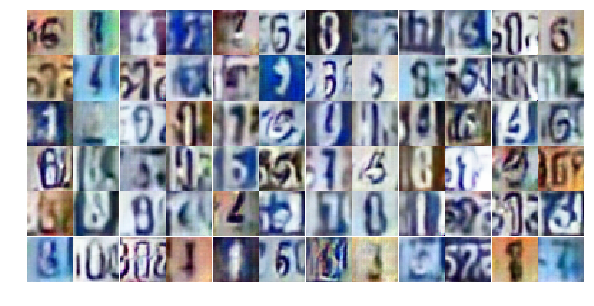

Epoch 20/25... Discriminator Loss: 1.3564... Generator Loss: 0.7895
Epoch 20/25... Discriminator Loss: 1.2096... Generator Loss: 0.7465
Epoch 20/25... Discriminator Loss: 1.2228... Generator Loss: 0.8026
Epoch 20/25... Discriminator Loss: 1.3978... Generator Loss: 0.6424
Epoch 20/25... Discriminator Loss: 0.7188... Generator Loss: 1.3702
Epoch 20/25... Discriminator Loss: 1.1915... Generator Loss: 0.8843
Epoch 20/25... Discriminator Loss: 1.2454... Generator Loss: 0.7785
Epoch 20/25... Discriminator Loss: 1.2473... Generator Loss: 0.6811
Epoch 20/25... Discriminator Loss: 1.3481... Generator Loss: 0.6642
Epoch 20/25... Discriminator Loss: 0.9577... Generator Loss: 1.0533


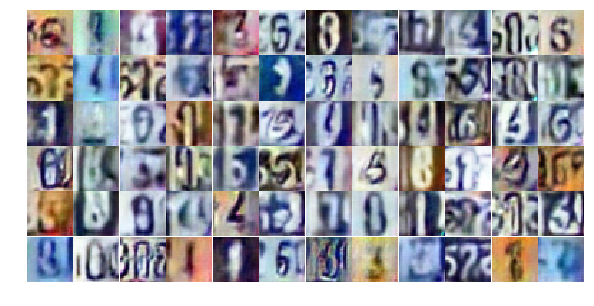

Epoch 20/25... Discriminator Loss: 0.7512... Generator Loss: 1.4112
Epoch 20/25... Discriminator Loss: 1.0990... Generator Loss: 0.8331
Epoch 20/25... Discriminator Loss: 1.2557... Generator Loss: 1.0627
Epoch 20/25... Discriminator Loss: 1.3908... Generator Loss: 0.8401
Epoch 20/25... Discriminator Loss: 1.2130... Generator Loss: 0.8225
Epoch 20/25... Discriminator Loss: 1.1652... Generator Loss: 0.9533
Epoch 20/25... Discriminator Loss: 1.3273... Generator Loss: 0.7472
Epoch 20/25... Discriminator Loss: 1.1951... Generator Loss: 0.7413
Epoch 20/25... Discriminator Loss: 1.3699... Generator Loss: 0.9005
Epoch 20/25... Discriminator Loss: 1.2281... Generator Loss: 0.6623


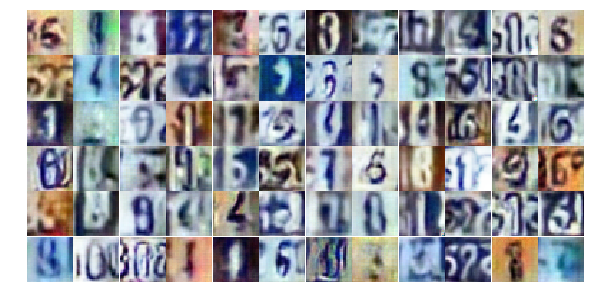

Epoch 20/25... Discriminator Loss: 1.3000... Generator Loss: 0.6701
Epoch 20/25... Discriminator Loss: 1.2805... Generator Loss: 0.7524
Epoch 20/25... Discriminator Loss: 1.5442... Generator Loss: 0.8289
Epoch 20/25... Discriminator Loss: 1.2751... Generator Loss: 0.7696
Epoch 20/25... Discriminator Loss: 1.0897... Generator Loss: 1.0504
Epoch 20/25... Discriminator Loss: 1.6088... Generator Loss: 0.6149
Epoch 20/25... Discriminator Loss: 1.1853... Generator Loss: 1.2675
Epoch 20/25... Discriminator Loss: 1.1365... Generator Loss: 0.7479
Epoch 20/25... Discriminator Loss: 1.1896... Generator Loss: 0.7363
Epoch 20/25... Discriminator Loss: 1.2268... Generator Loss: 0.9023


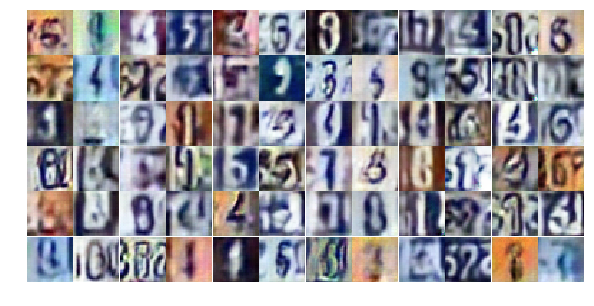

Epoch 20/25... Discriminator Loss: 1.1527... Generator Loss: 0.9975
Epoch 20/25... Discriminator Loss: 1.1142... Generator Loss: 1.0449
Epoch 20/25... Discriminator Loss: 1.0099... Generator Loss: 0.9003
Epoch 20/25... Discriminator Loss: 1.4927... Generator Loss: 0.6209
Epoch 20/25... Discriminator Loss: 1.1506... Generator Loss: 0.6729
Epoch 20/25... Discriminator Loss: 0.7399... Generator Loss: 1.2970
Epoch 21/25... Discriminator Loss: 1.4654... Generator Loss: 0.8836
Epoch 21/25... Discriminator Loss: 1.3610... Generator Loss: 0.8226
Epoch 21/25... Discriminator Loss: 1.1584... Generator Loss: 0.6435
Epoch 21/25... Discriminator Loss: 1.1064... Generator Loss: 0.9362


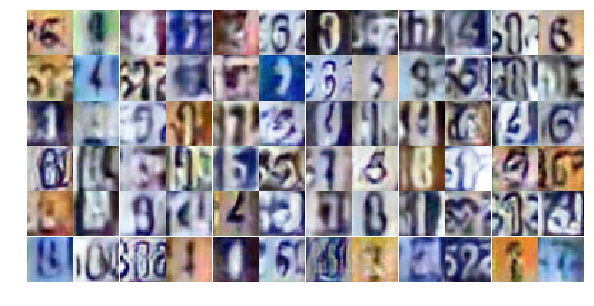

Epoch 21/25... Discriminator Loss: 1.1288... Generator Loss: 0.8422
Epoch 21/25... Discriminator Loss: 1.6187... Generator Loss: 0.4219
Epoch 21/25... Discriminator Loss: 1.5972... Generator Loss: 0.5297
Epoch 21/25... Discriminator Loss: 1.4412... Generator Loss: 0.7048
Epoch 21/25... Discriminator Loss: 1.4760... Generator Loss: 0.6479
Epoch 21/25... Discriminator Loss: 1.2106... Generator Loss: 0.8492
Epoch 21/25... Discriminator Loss: 1.2837... Generator Loss: 0.7141
Epoch 21/25... Discriminator Loss: 1.3064... Generator Loss: 0.7688
Epoch 21/25... Discriminator Loss: 0.3388... Generator Loss: 3.2647
Epoch 21/25... Discriminator Loss: 1.1901... Generator Loss: 0.9330


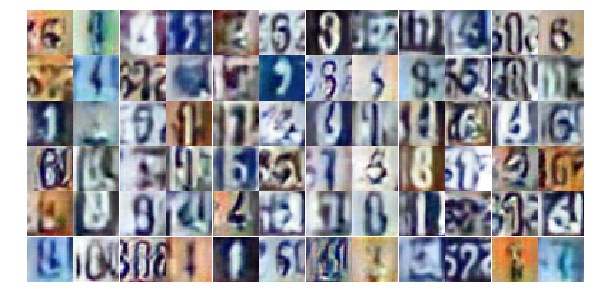

Epoch 21/25... Discriminator Loss: 1.1787... Generator Loss: 0.9307
Epoch 21/25... Discriminator Loss: 1.1685... Generator Loss: 0.7636
Epoch 21/25... Discriminator Loss: 1.2071... Generator Loss: 0.6327
Epoch 21/25... Discriminator Loss: 1.2709... Generator Loss: 0.8605
Epoch 21/25... Discriminator Loss: 1.4204... Generator Loss: 0.7554
Epoch 21/25... Discriminator Loss: 1.2600... Generator Loss: 0.6321
Epoch 21/25... Discriminator Loss: 0.3699... Generator Loss: 3.7680
Epoch 21/25... Discriminator Loss: 0.7368... Generator Loss: 1.1109
Epoch 21/25... Discriminator Loss: 1.0364... Generator Loss: 0.7302
Epoch 21/25... Discriminator Loss: 0.9229... Generator Loss: 1.0290


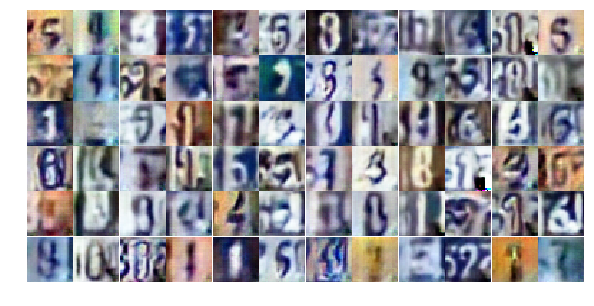

Epoch 21/25... Discriminator Loss: 0.8947... Generator Loss: 0.9246
Epoch 21/25... Discriminator Loss: 0.8737... Generator Loss: 1.6017
Epoch 21/25... Discriminator Loss: 0.9307... Generator Loss: 1.0459
Epoch 21/25... Discriminator Loss: 1.0899... Generator Loss: 1.5348
Epoch 21/25... Discriminator Loss: 0.6582... Generator Loss: 1.3853
Epoch 21/25... Discriminator Loss: 0.8631... Generator Loss: 0.9038
Epoch 21/25... Discriminator Loss: 1.0352... Generator Loss: 0.9987
Epoch 21/25... Discriminator Loss: 0.8217... Generator Loss: 1.2996
Epoch 21/25... Discriminator Loss: 0.8500... Generator Loss: 0.8674
Epoch 21/25... Discriminator Loss: 1.3381... Generator Loss: 0.9472


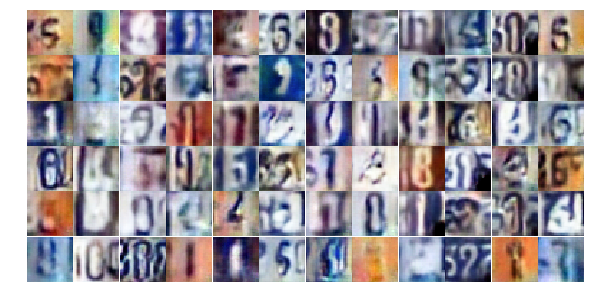

Epoch 21/25... Discriminator Loss: 1.2155... Generator Loss: 0.7447
Epoch 21/25... Discriminator Loss: 1.1751... Generator Loss: 0.9466
Epoch 21/25... Discriminator Loss: 1.1402... Generator Loss: 0.7160
Epoch 21/25... Discriminator Loss: 1.0142... Generator Loss: 0.9660
Epoch 21/25... Discriminator Loss: 1.0942... Generator Loss: 0.9654
Epoch 21/25... Discriminator Loss: 1.3264... Generator Loss: 0.6853
Epoch 21/25... Discriminator Loss: 1.1452... Generator Loss: 1.0972
Epoch 21/25... Discriminator Loss: 1.2854... Generator Loss: 0.7080
Epoch 21/25... Discriminator Loss: 1.0978... Generator Loss: 0.7847
Epoch 21/25... Discriminator Loss: 0.9702... Generator Loss: 1.1935


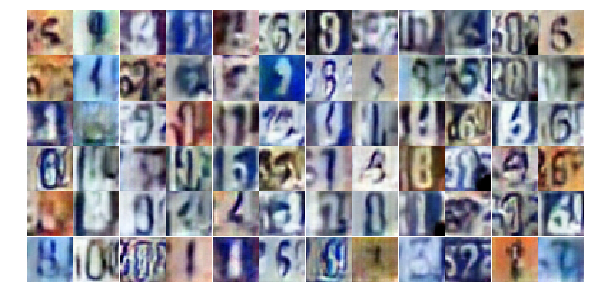

Epoch 21/25... Discriminator Loss: 1.2998... Generator Loss: 0.7505
Epoch 21/25... Discriminator Loss: 1.3880... Generator Loss: 0.7275
Epoch 21/25... Discriminator Loss: 1.1788... Generator Loss: 1.0751
Epoch 21/25... Discriminator Loss: 1.2647... Generator Loss: 0.5755
Epoch 21/25... Discriminator Loss: 1.2137... Generator Loss: 0.7918
Epoch 21/25... Discriminator Loss: 1.0784... Generator Loss: 2.2656
Epoch 21/25... Discriminator Loss: 1.2824... Generator Loss: 0.7486
Epoch 21/25... Discriminator Loss: 1.3304... Generator Loss: 0.6078
Epoch 21/25... Discriminator Loss: 1.3168... Generator Loss: 0.8854
Epoch 21/25... Discriminator Loss: 1.2917... Generator Loss: 0.9879


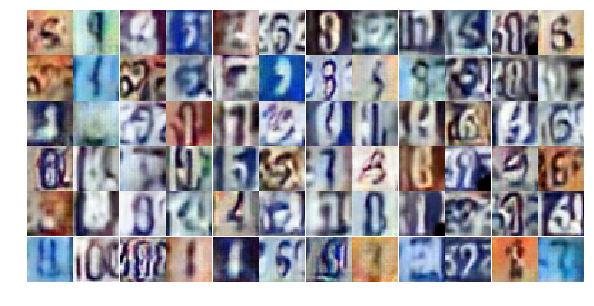

Epoch 21/25... Discriminator Loss: 1.2843... Generator Loss: 0.8631
Epoch 21/25... Discriminator Loss: 1.1237... Generator Loss: 0.7499
Epoch 21/25... Discriminator Loss: 1.2739... Generator Loss: 0.7080
Epoch 22/25... Discriminator Loss: 1.2161... Generator Loss: 0.9082
Epoch 22/25... Discriminator Loss: 1.2515... Generator Loss: 0.7813
Epoch 22/25... Discriminator Loss: 1.3124... Generator Loss: 0.6977
Epoch 22/25... Discriminator Loss: 1.2850... Generator Loss: 0.6541
Epoch 22/25... Discriminator Loss: 1.1511... Generator Loss: 0.8394
Epoch 22/25... Discriminator Loss: 1.1635... Generator Loss: 0.8936
Epoch 22/25... Discriminator Loss: 1.1216... Generator Loss: 1.0674


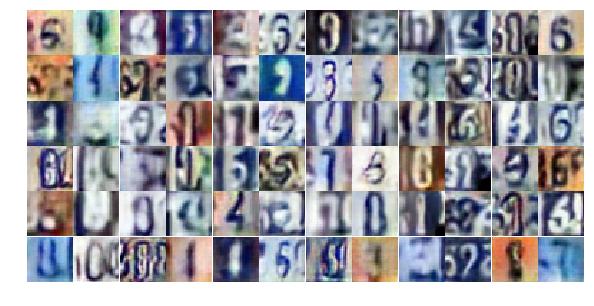

Epoch 22/25... Discriminator Loss: 1.3674... Generator Loss: 0.7893
Epoch 22/25... Discriminator Loss: 1.3566... Generator Loss: 0.8840
Epoch 22/25... Discriminator Loss: 1.2729... Generator Loss: 0.6939
Epoch 22/25... Discriminator Loss: 1.2830... Generator Loss: 0.6699
Epoch 22/25... Discriminator Loss: 0.9166... Generator Loss: 1.1485
Epoch 22/25... Discriminator Loss: 1.1289... Generator Loss: 0.8145
Epoch 22/25... Discriminator Loss: 1.3914... Generator Loss: 0.8145
Epoch 22/25... Discriminator Loss: 1.2513... Generator Loss: 0.8613
Epoch 22/25... Discriminator Loss: 1.4777... Generator Loss: 0.5287
Epoch 22/25... Discriminator Loss: 1.3803... Generator Loss: 0.6551


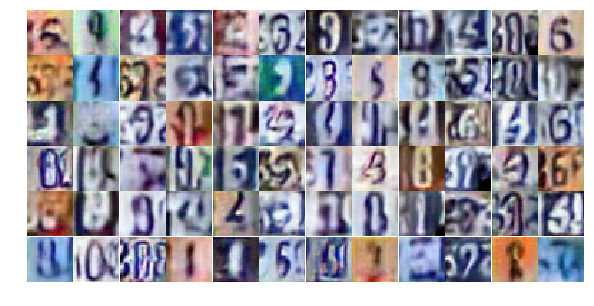

Epoch 22/25... Discriminator Loss: 1.2461... Generator Loss: 1.0368
Epoch 22/25... Discriminator Loss: 1.2172... Generator Loss: 0.8586
Epoch 22/25... Discriminator Loss: 1.5609... Generator Loss: 0.9206
Epoch 22/25... Discriminator Loss: 1.2259... Generator Loss: 0.9318
Epoch 22/25... Discriminator Loss: 1.3560... Generator Loss: 0.7352
Epoch 22/25... Discriminator Loss: 1.3182... Generator Loss: 0.8584
Epoch 22/25... Discriminator Loss: 1.2796... Generator Loss: 0.7701
Epoch 22/25... Discriminator Loss: 0.7529... Generator Loss: 1.7212
Epoch 22/25... Discriminator Loss: 0.4874... Generator Loss: 1.8649
Epoch 22/25... Discriminator Loss: 0.9264... Generator Loss: 1.5764


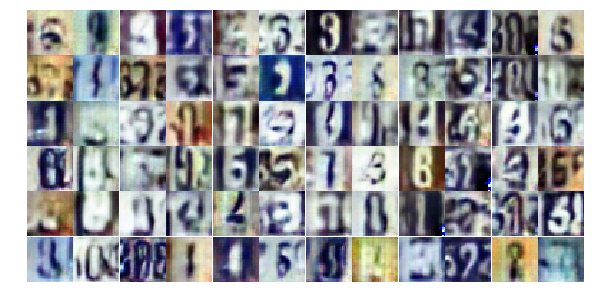

Epoch 22/25... Discriminator Loss: 0.8921... Generator Loss: 1.1504
Epoch 22/25... Discriminator Loss: 0.7231... Generator Loss: 1.2681
Epoch 22/25... Discriminator Loss: 0.7619... Generator Loss: 1.1734
Epoch 22/25... Discriminator Loss: 0.6632... Generator Loss: 1.5519
Epoch 22/25... Discriminator Loss: 1.0806... Generator Loss: 0.7464
Epoch 22/25... Discriminator Loss: 1.3147... Generator Loss: 0.9290
Epoch 22/25... Discriminator Loss: 1.2772... Generator Loss: 0.7008
Epoch 22/25... Discriminator Loss: 1.3966... Generator Loss: 0.7358
Epoch 22/25... Discriminator Loss: 1.1503... Generator Loss: 0.6741
Epoch 22/25... Discriminator Loss: 1.4169... Generator Loss: 0.6704


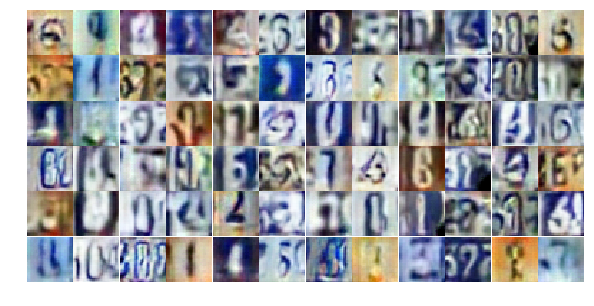

Epoch 22/25... Discriminator Loss: 1.3531... Generator Loss: 0.7060
Epoch 22/25... Discriminator Loss: 1.2334... Generator Loss: 0.9552
Epoch 22/25... Discriminator Loss: 1.2098... Generator Loss: 0.9432
Epoch 22/25... Discriminator Loss: 1.3139... Generator Loss: 0.9154
Epoch 22/25... Discriminator Loss: 1.1765... Generator Loss: 0.9929
Epoch 22/25... Discriminator Loss: 1.3630... Generator Loss: 0.8184
Epoch 22/25... Discriminator Loss: 1.2996... Generator Loss: 1.0201
Epoch 22/25... Discriminator Loss: 0.9954... Generator Loss: 1.1451
Epoch 22/25... Discriminator Loss: 1.4145... Generator Loss: 1.0779
Epoch 22/25... Discriminator Loss: 1.0424... Generator Loss: 0.9340


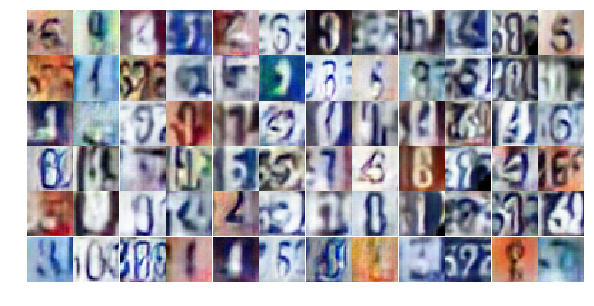

Epoch 22/25... Discriminator Loss: 1.2183... Generator Loss: 0.7066
Epoch 22/25... Discriminator Loss: 1.4983... Generator Loss: 0.5145
Epoch 22/25... Discriminator Loss: 1.3773... Generator Loss: 0.8917
Epoch 22/25... Discriminator Loss: 1.2145... Generator Loss: 0.9663
Epoch 22/25... Discriminator Loss: 1.2065... Generator Loss: 0.8864
Epoch 22/25... Discriminator Loss: 1.2623... Generator Loss: 0.9350
Epoch 22/25... Discriminator Loss: 1.3876... Generator Loss: 0.8840
Epoch 22/25... Discriminator Loss: 1.1590... Generator Loss: 0.8934
Epoch 22/25... Discriminator Loss: 1.2798... Generator Loss: 0.9191
Epoch 22/25... Discriminator Loss: 1.3500... Generator Loss: 0.7215


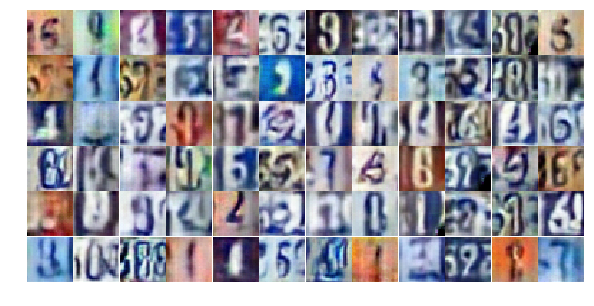

Epoch 23/25... Discriminator Loss: 1.0707... Generator Loss: 0.8654
Epoch 23/25... Discriminator Loss: 1.3959... Generator Loss: 0.7125
Epoch 23/25... Discriminator Loss: 1.1780... Generator Loss: 0.7383
Epoch 23/25... Discriminator Loss: 1.4091... Generator Loss: 0.6954
Epoch 23/25... Discriminator Loss: 1.4610... Generator Loss: 0.7606
Epoch 23/25... Discriminator Loss: 1.3281... Generator Loss: 0.7161
Epoch 23/25... Discriminator Loss: 1.2620... Generator Loss: 0.6734
Epoch 23/25... Discriminator Loss: 1.2717... Generator Loss: 0.7114
Epoch 23/25... Discriminator Loss: 1.1535... Generator Loss: 0.8595
Epoch 23/25... Discriminator Loss: 1.1942... Generator Loss: 0.8785


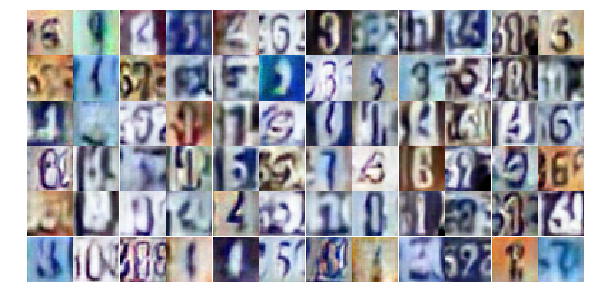

Epoch 23/25... Discriminator Loss: 1.5186... Generator Loss: 0.5392
Epoch 23/25... Discriminator Loss: 1.4402... Generator Loss: 0.6409
Epoch 23/25... Discriminator Loss: 1.2734... Generator Loss: 0.8184
Epoch 23/25... Discriminator Loss: 1.1997... Generator Loss: 0.8436
Epoch 23/25... Discriminator Loss: 1.2507... Generator Loss: 0.9342
Epoch 23/25... Discriminator Loss: 1.3958... Generator Loss: 0.7101
Epoch 23/25... Discriminator Loss: 1.2934... Generator Loss: 0.6990
Epoch 23/25... Discriminator Loss: 1.1976... Generator Loss: 0.8775
Epoch 23/25... Discriminator Loss: 1.2887... Generator Loss: 0.7819
Epoch 23/25... Discriminator Loss: 1.1594... Generator Loss: 0.8988


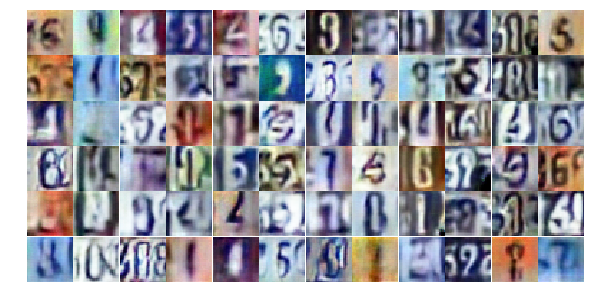

Epoch 23/25... Discriminator Loss: 1.4036... Generator Loss: 0.5708
Epoch 23/25... Discriminator Loss: 1.2075... Generator Loss: 1.0029
Epoch 23/25... Discriminator Loss: 1.1602... Generator Loss: 0.7730
Epoch 23/25... Discriminator Loss: 1.2204... Generator Loss: 0.8484
Epoch 23/25... Discriminator Loss: 1.2717... Generator Loss: 0.8802
Epoch 23/25... Discriminator Loss: 1.4378... Generator Loss: 0.5755
Epoch 23/25... Discriminator Loss: 1.2314... Generator Loss: 0.8309
Epoch 23/25... Discriminator Loss: 1.3255... Generator Loss: 0.7504
Epoch 23/25... Discriminator Loss: 1.3377... Generator Loss: 0.7887
Epoch 23/25... Discriminator Loss: 1.0658... Generator Loss: 0.8368


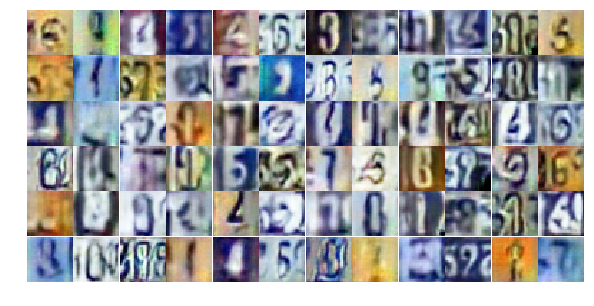

Epoch 23/25... Discriminator Loss: 1.2077... Generator Loss: 0.7876
Epoch 23/25... Discriminator Loss: 1.3778... Generator Loss: 0.8428
Epoch 23/25... Discriminator Loss: 1.3423... Generator Loss: 0.7168
Epoch 23/25... Discriminator Loss: 1.3732... Generator Loss: 0.6886
Epoch 23/25... Discriminator Loss: 1.3577... Generator Loss: 0.5318
Epoch 23/25... Discriminator Loss: 0.3501... Generator Loss: 2.8781
Epoch 23/25... Discriminator Loss: 1.3002... Generator Loss: 0.7954
Epoch 23/25... Discriminator Loss: 1.1454... Generator Loss: 0.9142
Epoch 23/25... Discriminator Loss: 1.2647... Generator Loss: 0.9269
Epoch 23/25... Discriminator Loss: 1.1831... Generator Loss: 0.8339


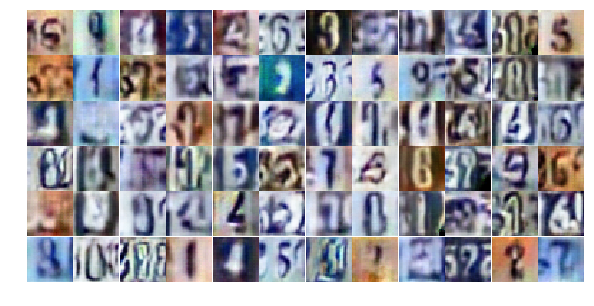

Epoch 23/25... Discriminator Loss: 1.4870... Generator Loss: 1.0102
Epoch 23/25... Discriminator Loss: 1.2650... Generator Loss: 0.8526
Epoch 23/25... Discriminator Loss: 1.3465... Generator Loss: 0.8359
Epoch 23/25... Discriminator Loss: 1.2935... Generator Loss: 0.8157
Epoch 23/25... Discriminator Loss: 0.9988... Generator Loss: 1.0331
Epoch 23/25... Discriminator Loss: 1.2924... Generator Loss: 0.6056
Epoch 23/25... Discriminator Loss: 1.2533... Generator Loss: 0.9548
Epoch 23/25... Discriminator Loss: 1.3643... Generator Loss: 0.8723
Epoch 23/25... Discriminator Loss: 1.3511... Generator Loss: 0.9239
Epoch 23/25... Discriminator Loss: 1.3519... Generator Loss: 0.7562


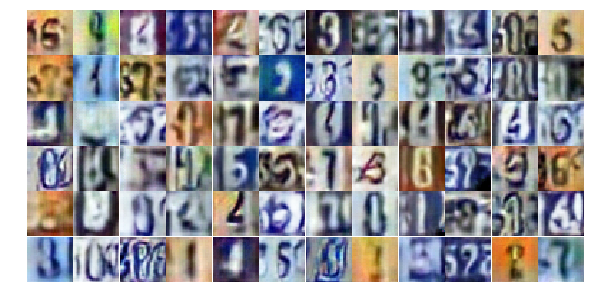

Epoch 23/25... Discriminator Loss: 1.1142... Generator Loss: 0.8687
Epoch 23/25... Discriminator Loss: 1.2708... Generator Loss: 0.8005
Epoch 23/25... Discriminator Loss: 1.2480... Generator Loss: 0.8765
Epoch 23/25... Discriminator Loss: 1.1459... Generator Loss: 0.9696
Epoch 23/25... Discriminator Loss: 1.1900... Generator Loss: 0.8877
Epoch 23/25... Discriminator Loss: 1.4055... Generator Loss: 0.8335
Epoch 23/25... Discriminator Loss: 1.2442... Generator Loss: 0.7263
Epoch 24/25... Discriminator Loss: 1.2925... Generator Loss: 0.6546
Epoch 24/25... Discriminator Loss: 1.3064... Generator Loss: 0.8021
Epoch 24/25... Discriminator Loss: 1.3577... Generator Loss: 0.7471


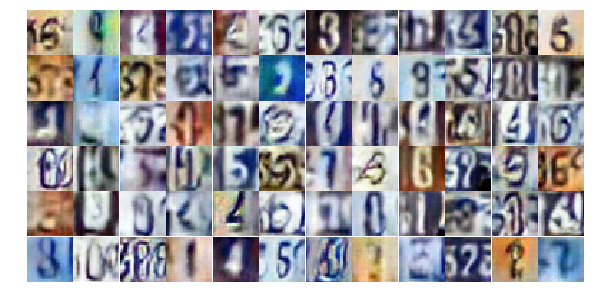

Epoch 24/25... Discriminator Loss: 0.9268... Generator Loss: 1.0221
Epoch 24/25... Discriminator Loss: 1.2504... Generator Loss: 0.7439
Epoch 24/25... Discriminator Loss: 1.2954... Generator Loss: 0.7078
Epoch 24/25... Discriminator Loss: 1.5340... Generator Loss: 1.3320
Epoch 24/25... Discriminator Loss: 1.2460... Generator Loss: 0.7471
Epoch 24/25... Discriminator Loss: 1.1622... Generator Loss: 0.8596
Epoch 24/25... Discriminator Loss: 1.2539... Generator Loss: 0.8087
Epoch 24/25... Discriminator Loss: 1.0927... Generator Loss: 0.8710
Epoch 24/25... Discriminator Loss: 1.2608... Generator Loss: 0.8095
Epoch 24/25... Discriminator Loss: 0.8619... Generator Loss: 1.3548


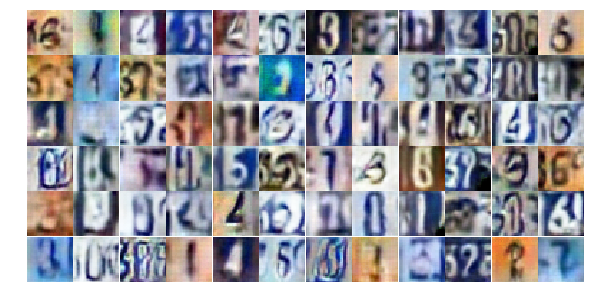

Epoch 24/25... Discriminator Loss: 1.2591... Generator Loss: 0.6925
Epoch 24/25... Discriminator Loss: 1.3836... Generator Loss: 0.6378
Epoch 24/25... Discriminator Loss: 1.4538... Generator Loss: 0.7236
Epoch 24/25... Discriminator Loss: 0.8123... Generator Loss: 1.1801
Epoch 24/25... Discriminator Loss: 1.3739... Generator Loss: 0.7089
Epoch 24/25... Discriminator Loss: 1.2759... Generator Loss: 0.7817
Epoch 24/25... Discriminator Loss: 1.3568... Generator Loss: 0.7507
Epoch 24/25... Discriminator Loss: 1.2090... Generator Loss: 0.9837
Epoch 24/25... Discriminator Loss: 1.2343... Generator Loss: 0.7830
Epoch 24/25... Discriminator Loss: 1.3525... Generator Loss: 0.7279


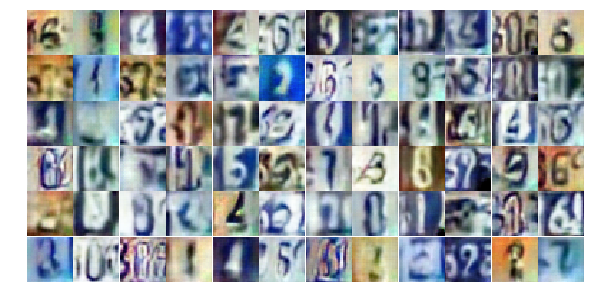

Epoch 24/25... Discriminator Loss: 1.3279... Generator Loss: 0.7456
Epoch 24/25... Discriminator Loss: 1.2837... Generator Loss: 0.8042
Epoch 24/25... Discriminator Loss: 1.2898... Generator Loss: 0.7825
Epoch 24/25... Discriminator Loss: 1.5358... Generator Loss: 0.5156
Epoch 24/25... Discriminator Loss: 1.3282... Generator Loss: 1.0780
Epoch 24/25... Discriminator Loss: 1.1573... Generator Loss: 0.9799
Epoch 24/25... Discriminator Loss: 1.1157... Generator Loss: 1.0004
Epoch 24/25... Discriminator Loss: 1.4304... Generator Loss: 0.7222
Epoch 24/25... Discriminator Loss: 1.3963... Generator Loss: 0.7281
Epoch 24/25... Discriminator Loss: 1.2763... Generator Loss: 0.9352


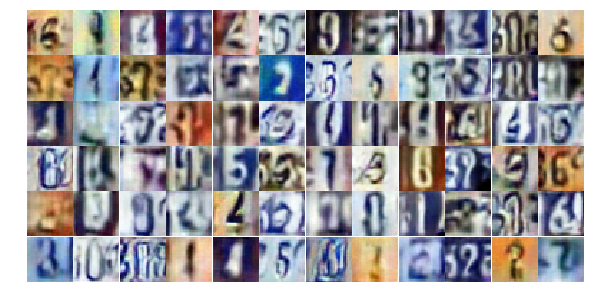

Epoch 24/25... Discriminator Loss: 1.1341... Generator Loss: 0.9157
Epoch 24/25... Discriminator Loss: 1.4448... Generator Loss: 0.4861
Epoch 24/25... Discriminator Loss: 1.3879... Generator Loss: 0.6634
Epoch 24/25... Discriminator Loss: 1.3319... Generator Loss: 0.5932
Epoch 24/25... Discriminator Loss: 1.2884... Generator Loss: 0.6540
Epoch 24/25... Discriminator Loss: 1.0957... Generator Loss: 0.8717
Epoch 24/25... Discriminator Loss: 1.2288... Generator Loss: 0.9480
Epoch 24/25... Discriminator Loss: 1.4222... Generator Loss: 0.7264
Epoch 24/25... Discriminator Loss: 1.3723... Generator Loss: 0.6751
Epoch 24/25... Discriminator Loss: 1.2010... Generator Loss: 0.8976


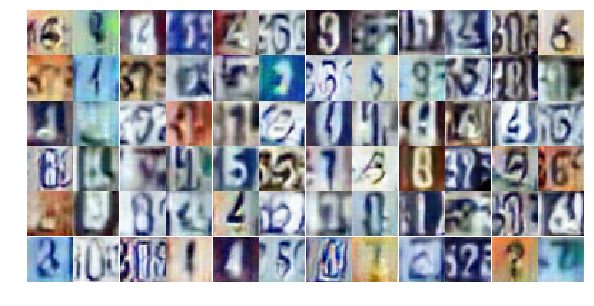

Epoch 24/25... Discriminator Loss: 1.3770... Generator Loss: 1.0192
Epoch 24/25... Discriminator Loss: 1.5486... Generator Loss: 0.7546
Epoch 24/25... Discriminator Loss: 1.2698... Generator Loss: 0.8829
Epoch 24/25... Discriminator Loss: 1.3985... Generator Loss: 1.1957
Epoch 24/25... Discriminator Loss: 1.3996... Generator Loss: 0.7632
Epoch 24/25... Discriminator Loss: 1.4189... Generator Loss: 0.5162
Epoch 24/25... Discriminator Loss: 1.3890... Generator Loss: 0.6631
Epoch 24/25... Discriminator Loss: 1.3043... Generator Loss: 0.8474
Epoch 24/25... Discriminator Loss: 1.3595... Generator Loss: 0.7487
Epoch 24/25... Discriminator Loss: 1.3705... Generator Loss: 0.6894


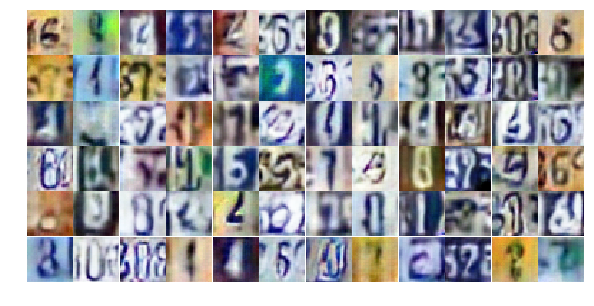

Epoch 24/25... Discriminator Loss: 1.2561... Generator Loss: 0.8330
Epoch 24/25... Discriminator Loss: 1.2916... Generator Loss: 0.7737
Epoch 24/25... Discriminator Loss: 1.3844... Generator Loss: 0.6473
Epoch 24/25... Discriminator Loss: 1.5223... Generator Loss: 0.7023
Epoch 24/25... Discriminator Loss: 1.2462... Generator Loss: 0.8207
Epoch 25/25... Discriminator Loss: 1.3619... Generator Loss: 0.7540
Epoch 25/25... Discriminator Loss: 1.2355... Generator Loss: 0.8079
Epoch 25/25... Discriminator Loss: 1.2730... Generator Loss: 0.7498
Epoch 25/25... Discriminator Loss: 1.2688... Generator Loss: 0.9244
Epoch 25/25... Discriminator Loss: 1.2642... Generator Loss: 0.8311


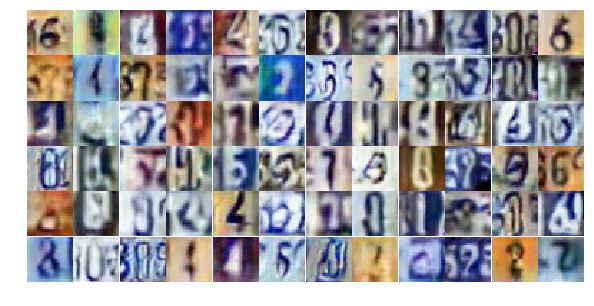

Epoch 25/25... Discriminator Loss: 0.7266... Generator Loss: 2.2674
Epoch 25/25... Discriminator Loss: 1.5194... Generator Loss: 0.6296
Epoch 25/25... Discriminator Loss: 1.0562... Generator Loss: 0.9244
Epoch 25/25... Discriminator Loss: 1.4033... Generator Loss: 0.6297
Epoch 25/25... Discriminator Loss: 1.4063... Generator Loss: 0.9025
Epoch 25/25... Discriminator Loss: 1.5368... Generator Loss: 0.5023
Epoch 25/25... Discriminator Loss: 1.2685... Generator Loss: 0.6473
Epoch 25/25... Discriminator Loss: 1.2965... Generator Loss: 0.7486
Epoch 25/25... Discriminator Loss: 1.1911... Generator Loss: 0.9544
Epoch 25/25... Discriminator Loss: 1.4149... Generator Loss: 0.6225


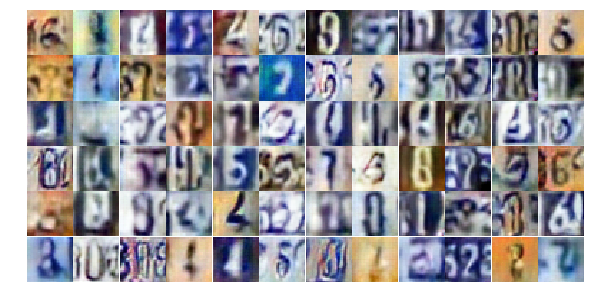

Epoch 25/25... Discriminator Loss: 0.9365... Generator Loss: 1.1059
Epoch 25/25... Discriminator Loss: 1.3023... Generator Loss: 1.1087
Epoch 25/25... Discriminator Loss: 1.3215... Generator Loss: 0.8212
Epoch 25/25... Discriminator Loss: 1.3711... Generator Loss: 0.7477
Epoch 25/25... Discriminator Loss: 1.1502... Generator Loss: 0.8715
Epoch 25/25... Discriminator Loss: 1.2945... Generator Loss: 0.8312
Epoch 25/25... Discriminator Loss: 1.4210... Generator Loss: 0.6440
Epoch 25/25... Discriminator Loss: 1.3659... Generator Loss: 0.6258
Epoch 25/25... Discriminator Loss: 1.3548... Generator Loss: 0.7771
Epoch 25/25... Discriminator Loss: 1.2950... Generator Loss: 0.7243


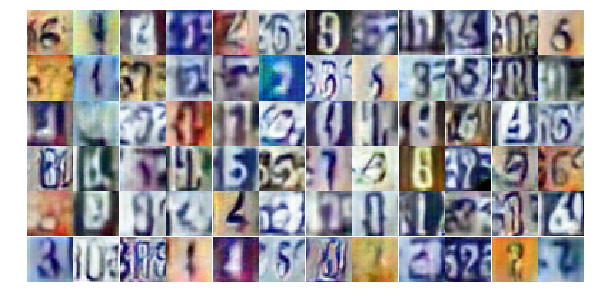

Epoch 25/25... Discriminator Loss: 1.3896... Generator Loss: 0.5140
Epoch 25/25... Discriminator Loss: 1.1962... Generator Loss: 0.8557
Epoch 25/25... Discriminator Loss: 1.4505... Generator Loss: 0.5607
Epoch 25/25... Discriminator Loss: 1.1852... Generator Loss: 0.7832
Epoch 25/25... Discriminator Loss: 1.3882... Generator Loss: 0.6096
Epoch 25/25... Discriminator Loss: 1.2934... Generator Loss: 0.6852
Epoch 25/25... Discriminator Loss: 1.4523... Generator Loss: 0.8599
Epoch 25/25... Discriminator Loss: 1.2335... Generator Loss: 0.6508
Epoch 25/25... Discriminator Loss: 1.0851... Generator Loss: 0.7624
Epoch 25/25... Discriminator Loss: 1.0905... Generator Loss: 0.8665


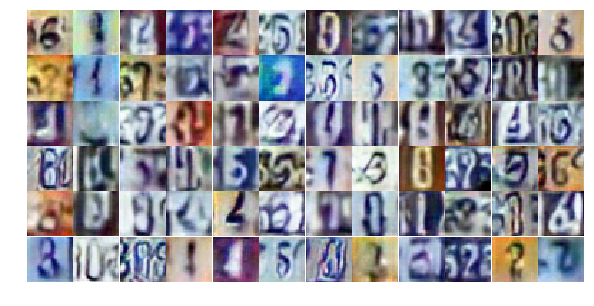

Epoch 25/25... Discriminator Loss: 1.3945... Generator Loss: 0.5075
Epoch 25/25... Discriminator Loss: 1.4731... Generator Loss: 0.6653
Epoch 25/25... Discriminator Loss: 1.3213... Generator Loss: 0.7467
Epoch 25/25... Discriminator Loss: 1.3097... Generator Loss: 0.7398
Epoch 25/25... Discriminator Loss: 1.2889... Generator Loss: 0.6988
Epoch 25/25... Discriminator Loss: 1.4218... Generator Loss: 0.6332
Epoch 25/25... Discriminator Loss: 1.1771... Generator Loss: 0.8470
Epoch 25/25... Discriminator Loss: 1.1306... Generator Loss: 0.8794
Epoch 25/25... Discriminator Loss: 1.5971... Generator Loss: 0.3405
Epoch 25/25... Discriminator Loss: 0.9635... Generator Loss: 0.9090


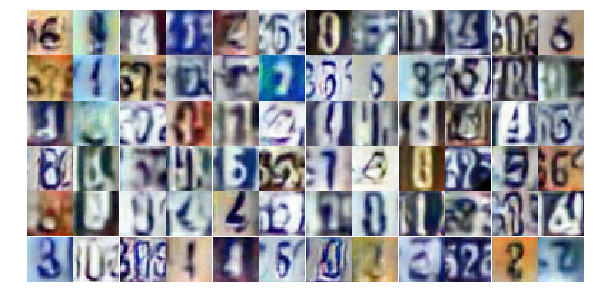

Epoch 25/25... Discriminator Loss: 1.6117... Generator Loss: 0.5715
Epoch 25/25... Discriminator Loss: 1.4094... Generator Loss: 0.6460
Epoch 25/25... Discriminator Loss: 1.3140... Generator Loss: 0.7047
Epoch 25/25... Discriminator Loss: 1.6177... Generator Loss: 0.6348
Epoch 25/25... Discriminator Loss: 1.3798... Generator Loss: 0.8027
Epoch 25/25... Discriminator Loss: 1.2595... Generator Loss: 0.7900
Epoch 25/25... Discriminator Loss: 1.3262... Generator Loss: 0.6852
Epoch 25/25... Discriminator Loss: 1.2795... Generator Loss: 1.0163
Epoch 25/25... Discriminator Loss: 1.2988... Generator Loss: 0.7222
Epoch 25/25... Discriminator Loss: 1.2044... Generator Loss: 0.7352


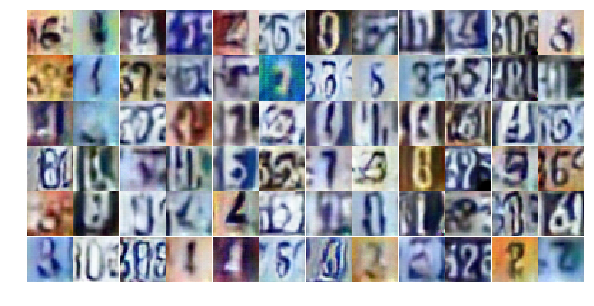

Epoch 25/25... Discriminator Loss: 1.2870... Generator Loss: 0.8315
Epoch 25/25... Discriminator Loss: 1.3328... Generator Loss: 0.5893


In [33]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

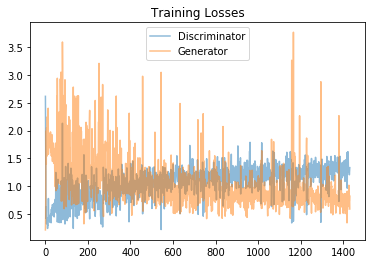

In [34]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

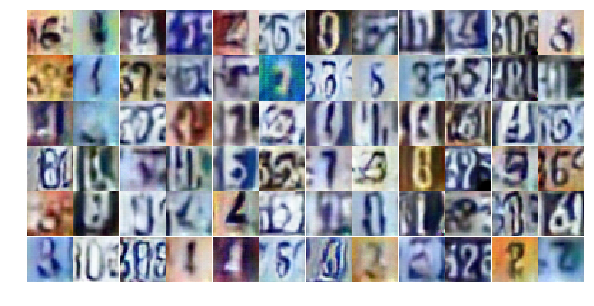

In [35]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))